In [2]:
# nalozimo potrebne knjiznice
from sage.all import *
from sage.graphs.graph_generators import graphs
from sage.graphs.graph import Graph
from sage.numerical.mip import MixedIntegerLinearProgram

In [4]:
# CLP
# def compute_wmdim_k(G, k):
#     vertices = G.vertices()
#     edges = G.edges(labels = False)
#     n = len(vertices)
    
#     prob = MixedIntegerLinearProgram(maximization=False)
#     S = prob.new_variable(binary=True)
    
#     prob.set_objective(sum(S[v] for v in vertices))
    
#     for a in vertices:
#         for b in vertices:
#             if a != b:
#                 prob.add_constraint(
#                     sum(S[s] * abs(G.distance(s, a) - G.distance(s, b)) for s in vertices) >= k
#                 )
    
#     prob.solve()
    
#     S_optimal = [v for v in vertices if prob.get_values(S[v]) > 0.5]
    
#     return len(S_optimal), S_optimal

In [ ]:
# Preizkus compute_wmdim_k za polne grafe.
# G = graphs.CompleteGraph(10)
# k = 2
# wmdim_k, S_optimal = compute_wmdim_k(G, k)
# print(f"Selected vertices for k={k}: wmdim_k = {wmdim_k}, S = {S_optimal}")

In [6]:
# max k
# def compute_max_k(G):
#     k = 1
#     while True:
#         try:
#             dimension, _ = compute_wmdim_k(G, k)
#             k += 1
#         except Exception as e:
#             break
#     return k - 1

In [7]:
# Preizkus compute_max_k za polne grafe.
# G = graphs.CompleteGraph(10)
# max_k = compute_max_k(G)
# print(f"Max k for {G} with n = {G.order()} is {max_k}.")

Definicija funkcije razdalje za povezavo in vozliscem in med vozlisci.

In [3]:
def razdalja(moznost, vozlisce, G):
    c, a = moznost
    if c == 'e':
        U, V = a
        return min(G.distance(U, vozlisce), G.distance(V, vozlisce))
    else:
        return G.distance(a, vozlisce)

Definicija CLP za racunanje razdalje.

In [4]:
def CLP_weak_k_dim(G, k):
    p = MixedIntegerLinearProgram(maximization=False)
    x = p.new_variable(binary=True)

    V = G.vertices()
    E = G.edges(labels=False)

    moznosti = [('v', v) for v in V] + [('e', e) for e in E]

    p.set_objective(sum(x[v] for v in V))
    
    for a, b in Combinations(moznosti, 2):
        p.add_constraint(
            sum(abs(razdalja(a, v, G) - razdalja(b, v, G)) * x[v] for v in V) >= k
            )

    wmdim_k = p.solve()
    mnozica_S = [v for v in V if p.get_values(x[v]) > 0.5]

    return (wmdim_k, mnozica_S)

Definicija za racunanje $\kappa''(G)$.

In [5]:
def kappa_2_crti(G):
    k = 1
    while True:
        try:
            CLP_weak_k_dim(G, k)
            k += 1
        except:
            return k - 1

### Polni grafi.

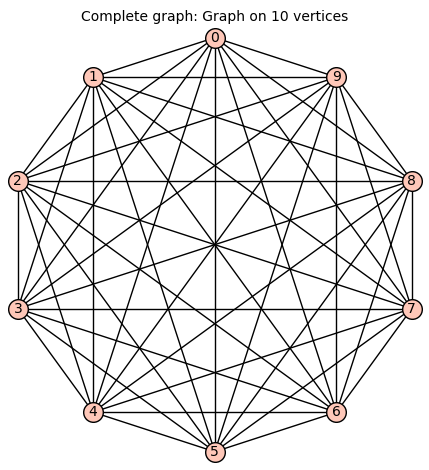

In [28]:
graphs.CompleteGraph(10)

In [26]:
# Preizkus CLP_weak_k_dim za polne grafe.
G = graphs.CompleteGraph(10)
k = 1
wmdim_k, S_optimal = CLP_weak_k_dim(G, k)
print(f"Selected vertices for k={k}: wmdim_k = {wmdim_k}, S = {S_optimal}")

Selected vertices for k=1: wmdim_k = 10.0, S = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]


In [27]:
# Preizkus kappa_2_crti za polne grafe.
G = graphs.CompleteGraph(10)
max_k = kappa_2_crti(G)
print(f"Max k for {G} with n = {G.order()} is {max_k}.")

Max k for Complete graph with n = 10 is 1.


In [8]:
# Max_k, wmdim_k, S za polne grafe.
def compute_wmdims_for_complete_graphs(sizes):
    
    results = {}
    
    for n in sizes:
        G = graphs.CompleteGraph(n)
        results[n] = {}
        print(f"\nProcessing CompleteGraph with n={n}")
        
        max_k = kappa_2_crti(G)
        print(f"  Max k (kappa'') = {max_k}")
        
        for k in range(1, max_k + 1):
            try:
                dimension, optimal_set = CLP_weak_k_dim(G, k)
                results[n][k] = (dimension, optimal_set)
                print(f"    k={k}: wmdim_k(K_{n}) = {dimension}, S = {optimal_set}")
            except ValueError:
                print(f"    k={k}: Infeasible (choose smaller k)")
                results[n][k] = None
                break  
            
    return results



In [18]:
sizes = [3, 4, 5, 6, 7, 8, 9, 10, 20, 30, 40]
results = compute_wmdims_for_complete_graphs(sizes)


Processing CompleteGraph with n=3
  Max k (kappa'') = 1
    k=1: wmdim_k(K_3) = 3.0, S = [0, 1, 2]

Processing CompleteGraph with n=4
  Max k (kappa'') = 1
    k=1: wmdim_k(K_4) = 4.0, S = [0, 1, 2, 3]

Processing CompleteGraph with n=5
  Max k (kappa'') = 1
    k=1: wmdim_k(K_5) = 5.0, S = [0, 1, 2, 3, 4]

Processing CompleteGraph with n=6
  Max k (kappa'') = 1
    k=1: wmdim_k(K_6) = 6.0, S = [0, 1, 2, 3, 4, 5]

Processing CompleteGraph with n=7
  Max k (kappa'') = 1
    k=1: wmdim_k(K_7) = 7.0, S = [0, 1, 2, 3, 4, 5, 6]

Processing CompleteGraph with n=8
  Max k (kappa'') = 1
    k=1: wmdim_k(K_8) = 8.0, S = [0, 1, 2, 3, 4, 5, 6, 7]

Processing CompleteGraph with n=9
  Max k (kappa'') = 1
    k=1: wmdim_k(K_9) = 9.0, S = [0, 1, 2, 3, 4, 5, 6, 7, 8]

Processing CompleteGraph with n=10
  Max k (kappa'') = 1
    k=1: wmdim_k(K_10) = 10.0, S = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]

Processing CompleteGraph with n=20
  Max k (kappa'') = 1
    k=1: wmdim_k(K_20) = 20.0, S = [0, 1, 2, 3, 4, 5, 6


Za polne grafe je $\kappa''(G) = 1$, za $k = 1$ je $wmdim_k(G) = n$, kjer je $n$ enako številu vozlišč.

### Dvodelni polni grafi

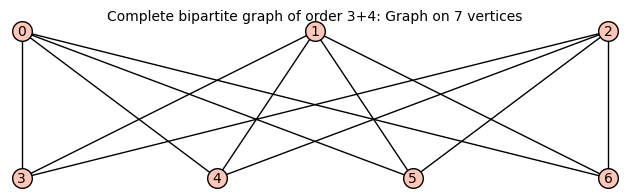

In [102]:
graphs.CompleteBipartiteGraph(3,4)

In [19]:
# Preizkus CLP_weak_k_dim za dvodelne polne grafe.
G = graphs.CompleteBipartiteGraph(10, 5)
k = 1
wmdim_k, S_optimal = CLP_weak_k_dim(G, k)
print(f"Selected vertices for k={k}: wmdim_k = {wmdim_k}, S = {S_optimal}")

Selected vertices for k=1: wmdim_k = 13.0, S = [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]


In [20]:
# Preizkus kappa_2_crti za dvodelne polne grafe.
G = graphs.CompleteBipartiteGraph(10, 5)
max_k = kappa_2_crti(G)
print(f"Max k for {G} with n = {G.order()} is {max_k}.")

Max k for Complete bipartite graph of order 10+5 with n = 15 is 2.


In [21]:
# Max_k, wmdim_k, S za dvodelne polne grafe.

def compute_wmdims_for_complete_bipartite_graphs(sizes):
    
    results = {}
    
    for m, n in sizes:
        G = graphs.CompleteBipartiteGraph(m, n)
        results[(m, n)] = {}
        print(f"\nProcessing CompleteBipartiteGraph with m={m}, n={n}")
        
        max_k = kappa_2_crti(G)
        print(f"  Max k (kappa'') = {max_k}")
        
        for k in range(1, max_k + 1):
            try:
                dimension, optimal_set = CLP_weak_k_dim(G, k)
                results[(m, n)][k] = (dimension, optimal_set)
                print(f"    k={k}: wmdim_k(K_{{{m},{n}}}) = {dimension}, S = {optimal_set}")
            except ValueError:
                print(f"    k={k}: Infeasible (choose smaller k)")
                results[(m, n)][k] = None
                break  
    
    return results


In [22]:
sizes = [(1,2), (2,2), (1,3), (2,3), (3,3), (1,4), (2,4), (3,4), (4,4), (1,5), (2,5), (3,5), (4,5), (5,5), (1,6), (2,6), (3,6), (4,6), (5,6), (6,6), (1,7), (2,7), (3,7), (4,7), (5,7), (6,7), (7,7), (1,8), (2,8), (3,8), (4,8), (5,8), (6,8), (7,8), (8,8), (1,9), (2,9), (3,9), (4,9), (5,9), (6,9), (7,9), (8,9), (9,9), (1,10), (2,10), (3,10), (4,10), (5,10), (6,10), (7,10), (8,10), (9,10), (10,10)]
results = compute_wmdims_for_complete_bipartite_graphs(sizes)


Processing CompleteBipartiteGraph with m=1, n=1
  Max k (kappa'') = 1
    k=1: wmdim_k(K_{1,1}) = 2.0, S = [0, 1]

Processing CompleteBipartiteGraph with m=1, n=2
  Max k (kappa'') = 1
    k=1: wmdim_k(K_{1,2}) = 2.0, S = [1, 2]

Processing CompleteBipartiteGraph with m=2, n=2
  Max k (kappa'') = 2
    k=1: wmdim_k(K_{2,2}) = 3.0, S = [0, 1, 3]
    k=2: wmdim_k(K_{2,2}) = 4.0, S = [0, 1, 2, 3]

Processing CompleteBipartiteGraph with m=1, n=3
  Max k (kappa'') = 1
    k=1: wmdim_k(K_{1,3}) = 3.0, S = [1, 2, 3]

Processing CompleteBipartiteGraph with m=2, n=3
  Max k (kappa'') = 2
    k=1: wmdim_k(K_{2,3}) = 4.0, S = [0, 1, 2, 3]
    k=2: wmdim_k(K_{2,3}) = 5.0, S = [0, 1, 2, 3, 4]

Processing CompleteBipartiteGraph with m=3, n=3
  Max k (kappa'') = 2
    k=1: wmdim_k(K_{3,3}) = 4.0, S = [0, 1, 3, 4]
    k=2: wmdim_k(K_{3,3}) = 6.0, S = [0, 1, 2, 3, 4, 5]

Processing CompleteBipartiteGraph with m=1, n=4
  Max k (kappa'') = 1
    k=1: wmdim_k(K_{1,4}) = 4.0, S = [1, 2, 3, 4]

Processing 



Za dvodelne polne grafe za katere je $m$ ali $n$ enak $1$, je $\kappa''(G) = 1$, $wmdim_k(G)$ je tedaj enak $m \cdot n$, izjema je dvodelni polni graf, kjer sta $m$ in $n$ enaka 1, tedaj je $\kappa''(G) = 1$, $wmdim_k(G)$ pa je enak $2$, torej je enak $m + n$. Za dvodelne polne grafe, za katere $m$ in $n$ nista enaka $1$, je $\kappa''(G) = 2$. $wmdim_k(G)$ je za $k = 1$ enak $m + n - 1$, če je $m$ ali $n$ enak $2$, v nasprotnem primeru pa je enak $m + n - 2$. Za $k = 2$, je $wmdim_k(G)$ enak $m + n$.

### Kartezični produkt ciklov.

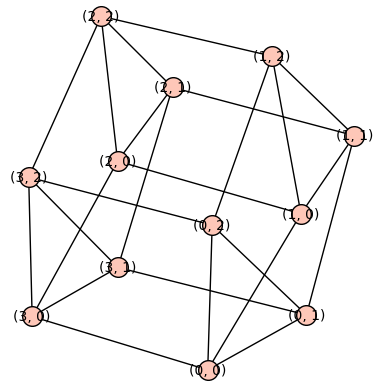

In [42]:
C1 = graphs.CycleGraph(4)
C2 = graphs.CycleGraph(3)

cartesian_product = C1.cartesian_product(C2)

cartesian_product.show()


In [36]:
# Preizkus CLP_weak_k_dim za kartezične produkte dveh ciklov.
C1 = graphs.CycleGraph(4)
C2 = graphs.CycleGraph(3)
G = C1.cartesian_product(C2)
k = 2
wmdim_k, S_optimal = CLP_weak_k_dim(G, k)
print(f"Selected vertices for k={k}: wmdim_k = {wmdim_k}, S = {S_optimal}")

Selected vertices for k=2: wmdim_k = 6.0, S = [(0, 0), (0, 1), (0, 2), (1, 0), (2, 2), (3, 1)]


In [47]:
# Preizkus kappa_2_crti za kartezične produkte dveh ciklov.
C1 = graphs.CycleGraph(2)
C2 = graphs.CycleGraph(2)
G = C1.cartesian_product(C2)
max_k = kappa_2_crti(G)
print(f"Max k for {G} is {max_k}.")

Max k for Graph on 4 vertices is 2.


In [12]:
def compute_wmdims_for_cartesian_product_of_cycles(sizes):
    
    results = {}

    for m, n in sizes:
        C1 = graphs.CycleGraph(m)
        C2 = graphs.CycleGraph(n)
        G = C1.cartesian_product(C2)
        
        results[(m, n)] = {}
        print(f"\nProcessing Cartesian Product of Cycles C_{m} x C_{n}")
        
        max_k = kappa_2_crti(G)  
        print(f"  Max k (kappa'') = {max_k}")
        
        for k in range(1, max_k + 1):
            try:
                dimension, optimal_set = CLP_weak_k_dim(G, k)  
                results[(m, n)][k] = (dimension, optimal_set)
                print(f"    k={k}: wmdim_k(C_{m} x C_{n}) = {dimension}, S = {optimal_set}")
            except ValueError:
                print(f"    k={k}: Infeasible (choose smaller k)")
                results[(m, n)][k] = None
                break

    return results


In [ ]:
sizes = [(1,2), (2,2), (1,3), (2,3), (3,3), (1,4), (2,4), (3,4), (4,4), (1,5), (2,5), (3,5), (4,5), (5,5), (1,6), (2,6), (3,6), (4,6), (5,6), (6,6)]
results = compute_wmdims_for_cartesian_product_of_cycles(sizes)


Processing Cartesian Product of Cycles C_1 x C_1
  Max k (kappa'') = 155017
    k=1: wmdim_k(C_1 x C_1) = 0.0, S = []
    k=2: wmdim_k(C_1 x C_1) = 0.0, S = []
    k=3: wmdim_k(C_1 x C_1) = 0.0, S = []
    k=4: wmdim_k(C_1 x C_1) = 0.0, S = []
    k=5: wmdim_k(C_1 x C_1) = 0.0, S = []
    k=6: wmdim_k(C_1 x C_1) = 0.0, S = []
    k=7: wmdim_k(C_1 x C_1) = 0.0, S = []
    k=8: wmdim_k(C_1 x C_1) = 0.0, S = []
    k=9: wmdim_k(C_1 x C_1) = 0.0, S = []
    k=10: wmdim_k(C_1 x C_1) = 0.0, S = []
    k=11: wmdim_k(C_1 x C_1) = 0.0, S = []
    k=12: wmdim_k(C_1 x C_1) = 0.0, S = []
    k=13: wmdim_k(C_1 x C_1) = 0.0, S = []
    k=14: wmdim_k(C_1 x C_1) = 0.0, S = []
    k=15: wmdim_k(C_1 x C_1) = 0.0, S = []
    k=16: wmdim_k(C_1 x C_1) = 0.0, S = []
    k=17: wmdim_k(C_1 x C_1) = 0.0, S = []
    k=18: wmdim_k(C_1 x C_1) = 0.0, S = []
    k=19: wmdim_k(C_1 x C_1) = 0.0, S = []
    k=20: wmdim_k(C_1 x C_1) = 0.0, S = []
    k=21: wmdim_k(C_1 x C_1) = 0.0, S = []
    k=22: wmdim_k(C_1 x C_1) 

KeyboardInterrupt: 

Pri kartezičnih produktih ciklov, je za grafe s $k$-jem enakim $\kappa(G)$, $wmdim_k(G)$ enak $m \cdot n$. 

In [6]:
def poisci_grafe_s_small_wmdim_k(sizes):
    
    for n in sizes:
        small_values = list(range(1, 4))
        print(f'\nPovezani grafi na {n} vozliscih z wmdim_k(G) v {small_values}:')
        
        for G in graphs.nauty_geng(f'{n} -c'):  
            kappa_2crti = kappa_2_crti(G)  
            
            for k in range(1, kappa_2crti + 1):
                try:
                    wmdim_k, _ = CLP_weak_k_dim(G, k)  
                    if wmdim_k in small_values:  
                        G.show()
                        print(f'Graf {G.name()} with wmdim_k = {wmdim_k}')
                except ValueError:
                    pass




Povezani grafi na 2 vozliscih z wmdim_k(G) v [1, 2, 3]:


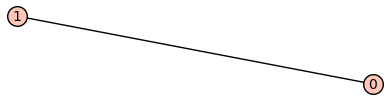

Graf  with wmdim_k = 2.0

Povezani grafi na 3 vozliscih z wmdim_k(G) v [1, 2, 3]:


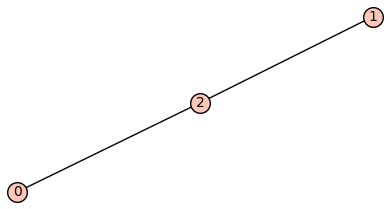

Graf  with wmdim_k = 2.0


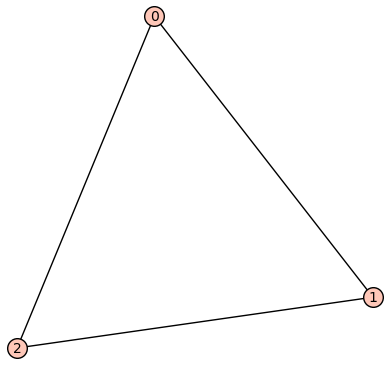

Graf  with wmdim_k = 3.0


In [ ]:
sizes = [1]
poisci_grafe_s_small_wmdim_k(sizes)

In [11]:
def poisci_grafe_z_large_wmdim_k(sizes):
    
    for n in sizes:
        large_values = list(range(n - 2, n + 1))
        print(f'\nPovezani grafi na {n} vozliscih z wmdim_k(G) v {large_values}:')
        
        for G in graphs.nauty_geng(f'{n} -c'):  
            kappa_2crti = kappa_2_crti(G)  
            
            for k in range(1, kappa_2crti + 1):
                try:
                    wmdim_k, _ = CLP_weak_k_dim(G, k)  
                    if wmdim_k in large_values:  
                        G.show()
                        print(f'Graf {G.name()} with wmdim_k = {wmdim_k}')
                except ValueError:
                    pass



Povezani grafi na 3 vozliscih z wmdim_k(G) v [1, 2, 3]:


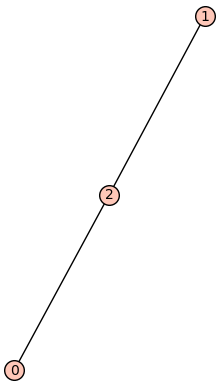

Graf  with wmdim_k = 2.0


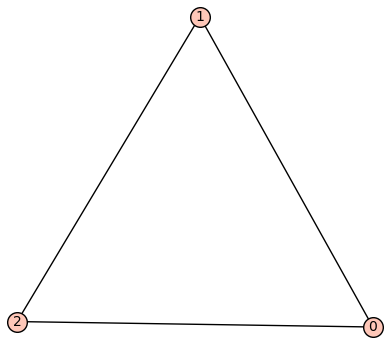

Graf  with wmdim_k = 3.0

Povezani grafi na 4 vozliscih z wmdim_k(G) v [2, 3, 4]:


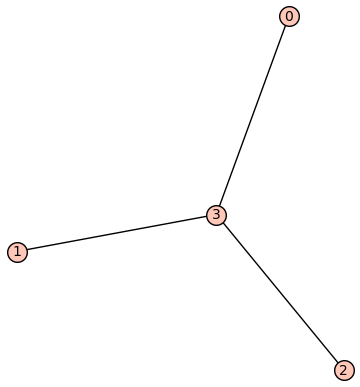

Graf  with wmdim_k = 3.0


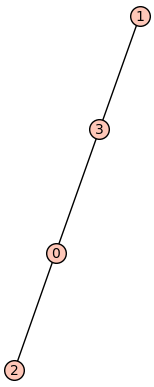

Graf  with wmdim_k = 2.0


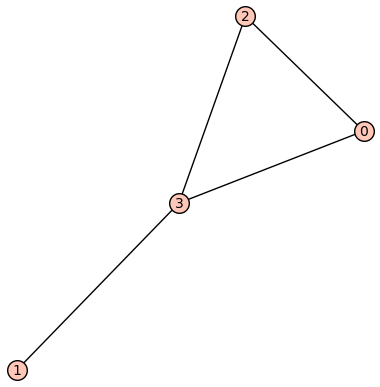

Graf  with wmdim_k = 3.0


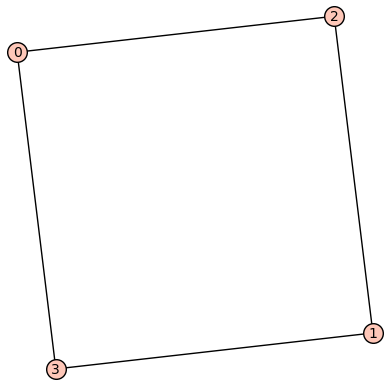

Graf  with wmdim_k = 3.0


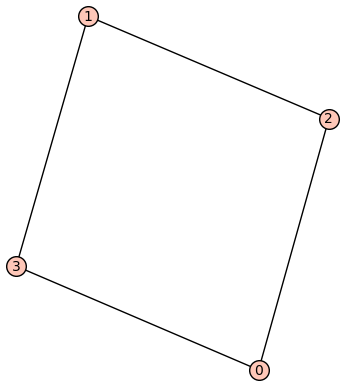

Graf  with wmdim_k = 4.0


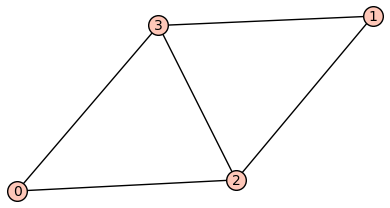

Graf  with wmdim_k = 4.0


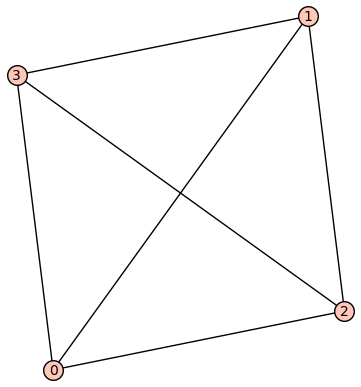

Graf  with wmdim_k = 4.0

Povezani grafi na 5 vozliscih z wmdim_k(G) v [3, 4, 5]:


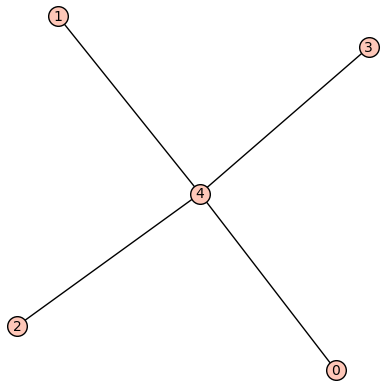

Graf  with wmdim_k = 4.0


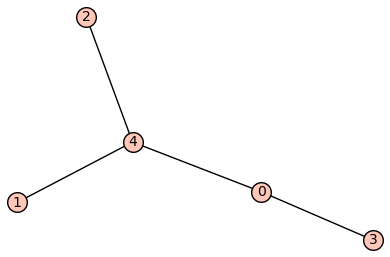

Graf  with wmdim_k = 3.0


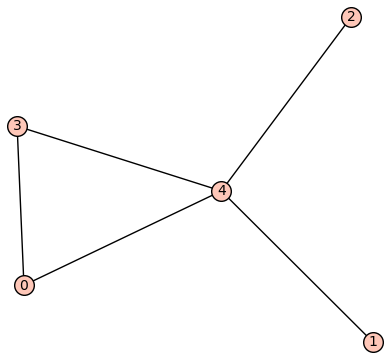

Graf  with wmdim_k = 4.0


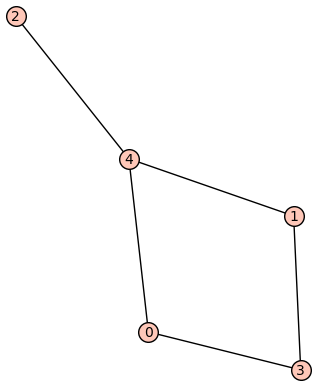

Graf  with wmdim_k = 3.0


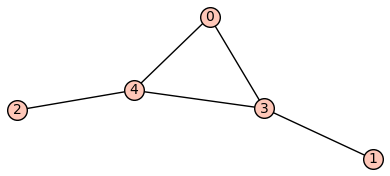

Graf  with wmdim_k = 3.0


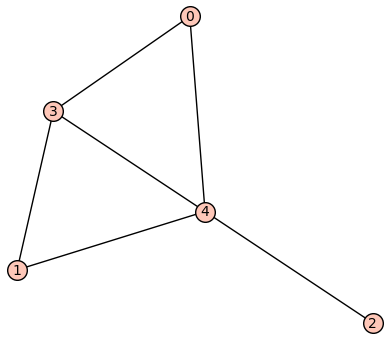

Graf  with wmdim_k = 4.0


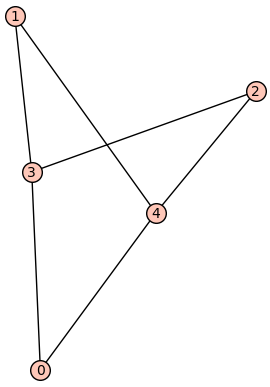

Graf  with wmdim_k = 4.0


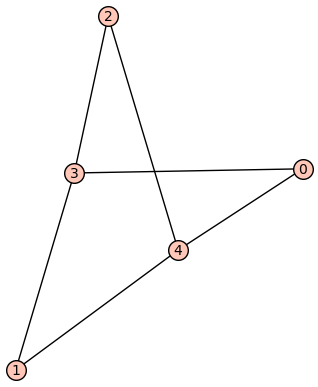

Graf  with wmdim_k = 5.0


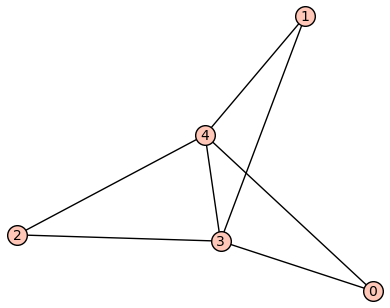

Graf  with wmdim_k = 5.0


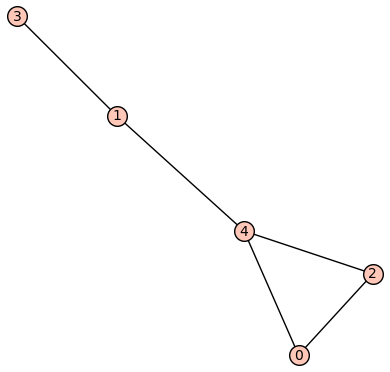

Graf  with wmdim_k = 3.0


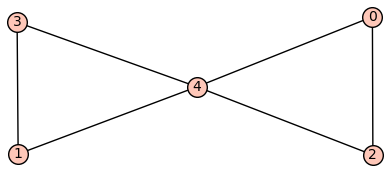

Graf  with wmdim_k = 4.0


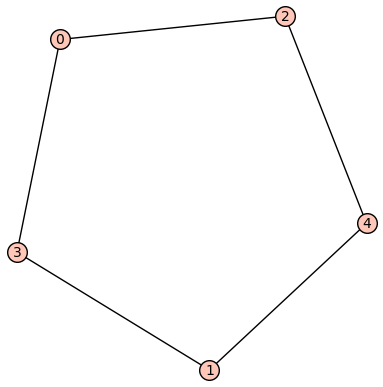

Graf  with wmdim_k = 3.0


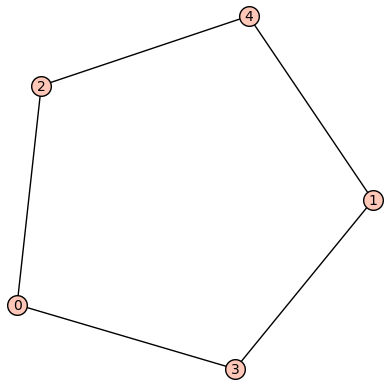

Graf  with wmdim_k = 5.0


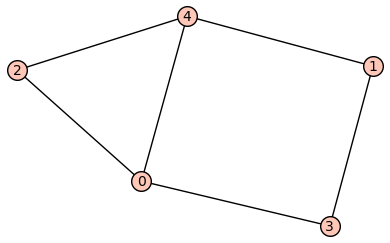

Graf  with wmdim_k = 3.0


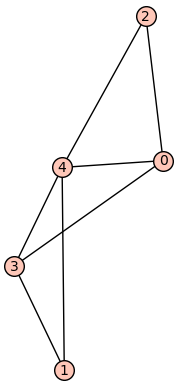

Graf  with wmdim_k = 4.0


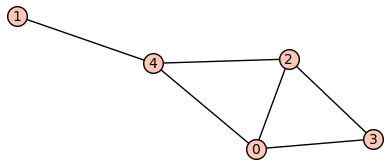

Graf  with wmdim_k = 4.0


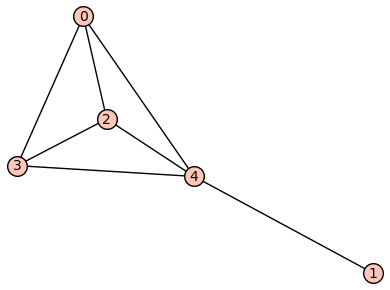

Graf  with wmdim_k = 4.0


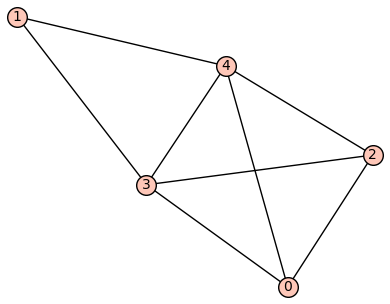

Graf  with wmdim_k = 5.0


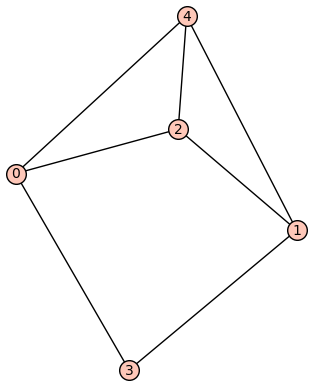

Graf  with wmdim_k = 4.0


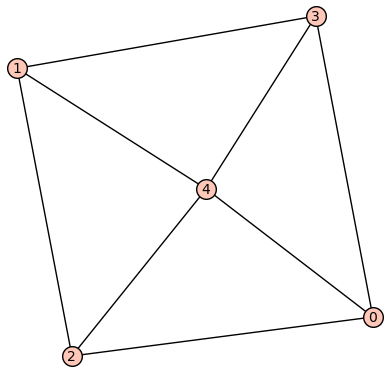

Graf  with wmdim_k = 4.0


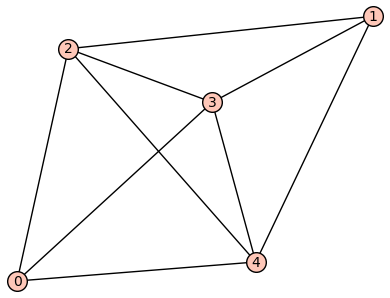

Graf  with wmdim_k = 5.0


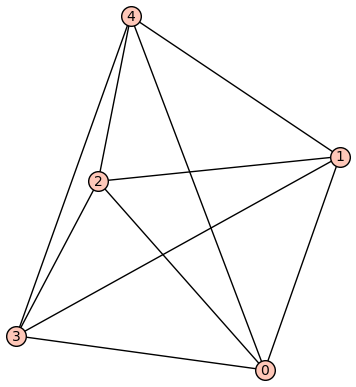

Graf  with wmdim_k = 5.0

Povezani grafi na 6 vozliscih z wmdim_k(G) v [4, 5, 6]:


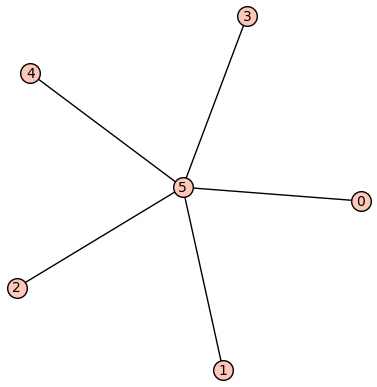

Graf  with wmdim_k = 5.0


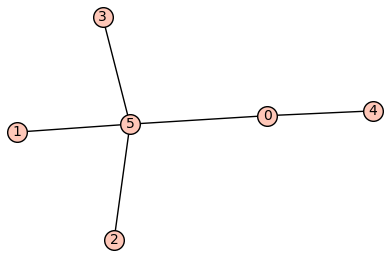

Graf  with wmdim_k = 4.0


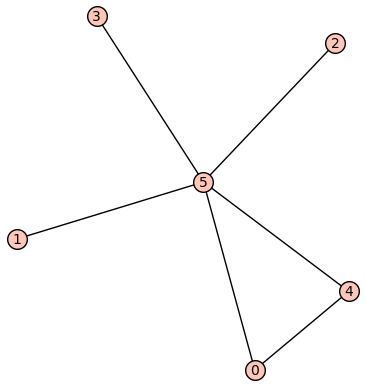

Graf  with wmdim_k = 5.0


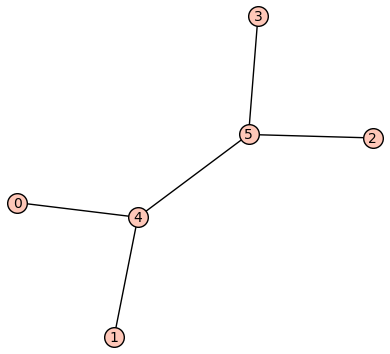

Graf  with wmdim_k = 4.0


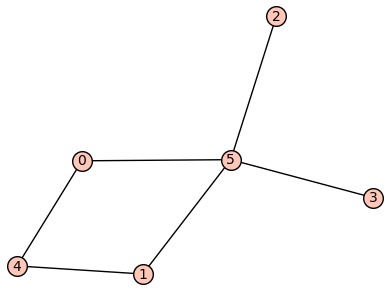

Graf  with wmdim_k = 4.0


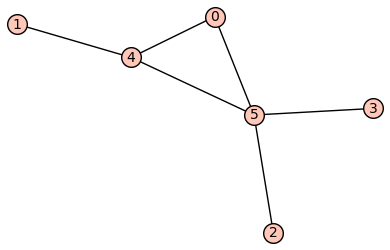

Graf  with wmdim_k = 4.0


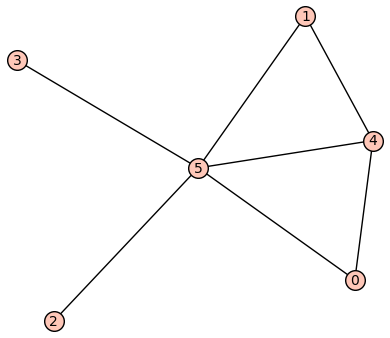

Graf  with wmdim_k = 5.0


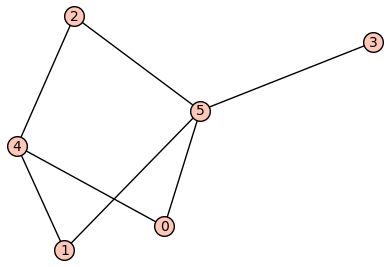

Graf  with wmdim_k = 4.0


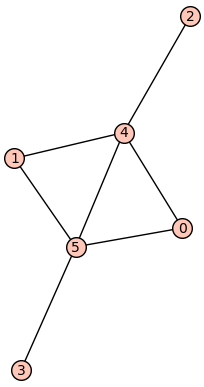

Graf  with wmdim_k = 4.0


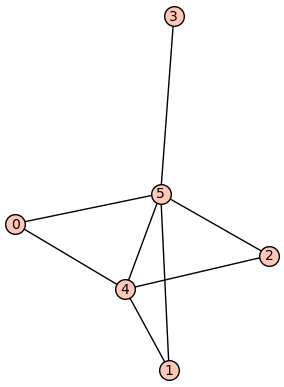

Graf  with wmdim_k = 5.0


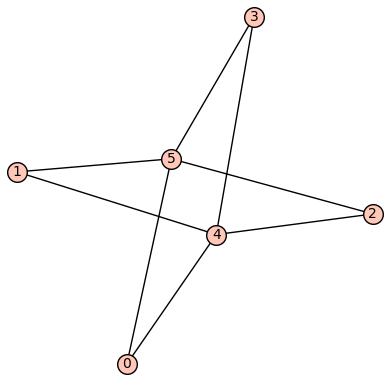

Graf  with wmdim_k = 5.0


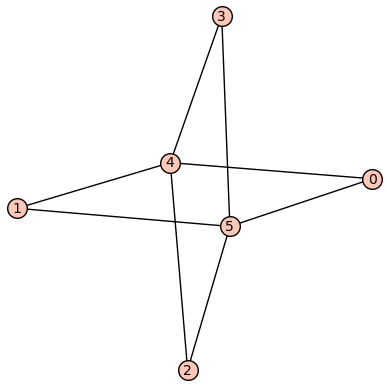

Graf  with wmdim_k = 6.0


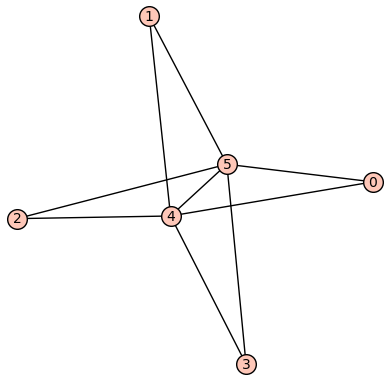

Graf  with wmdim_k = 6.0


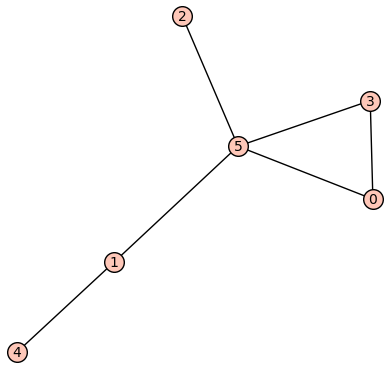

Graf  with wmdim_k = 4.0


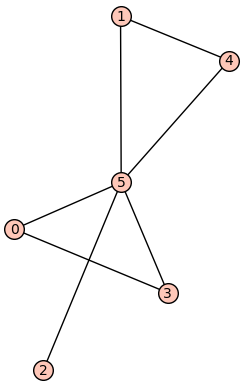

Graf  with wmdim_k = 5.0


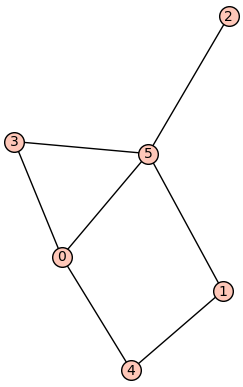

Graf  with wmdim_k = 4.0


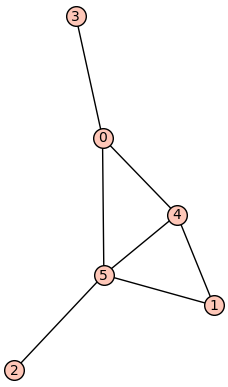

Graf  with wmdim_k = 4.0


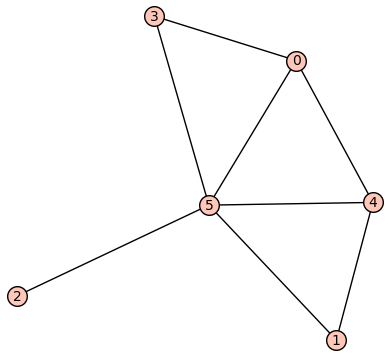

Graf  with wmdim_k = 5.0


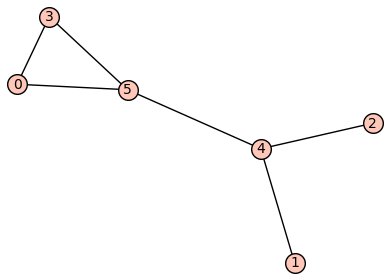

Graf  with wmdim_k = 4.0


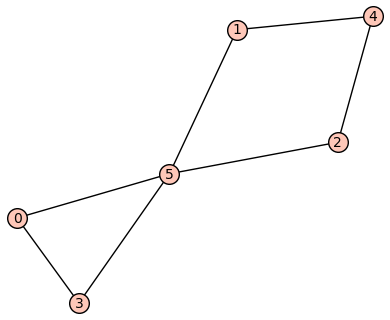

Graf  with wmdim_k = 4.0


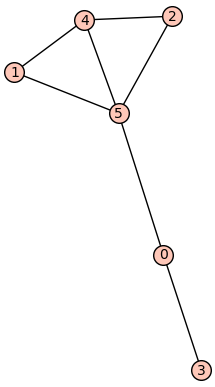

Graf  with wmdim_k = 4.0


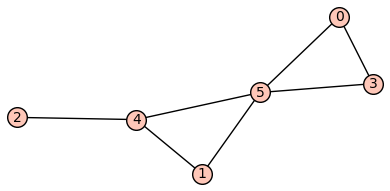

Graf  with wmdim_k = 4.0


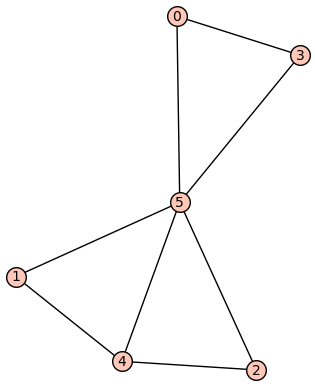

Graf  with wmdim_k = 5.0


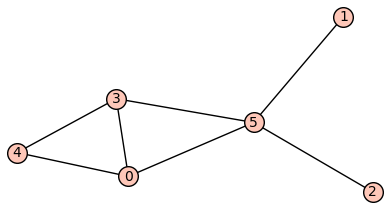

Graf  with wmdim_k = 5.0


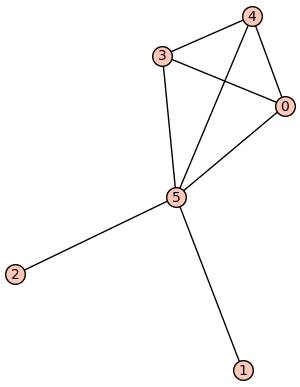

Graf  with wmdim_k = 5.0


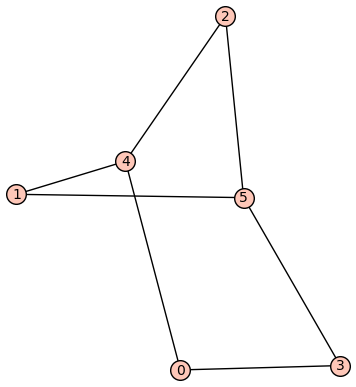

Graf  with wmdim_k = 4.0


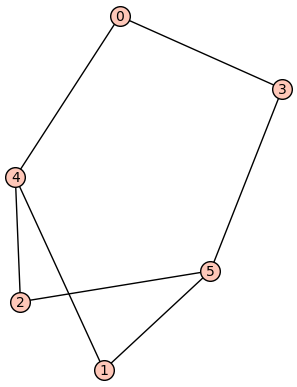

Graf  with wmdim_k = 6.0


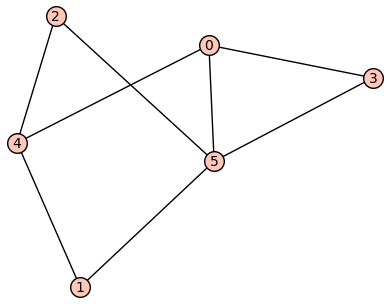

Graf  with wmdim_k = 4.0


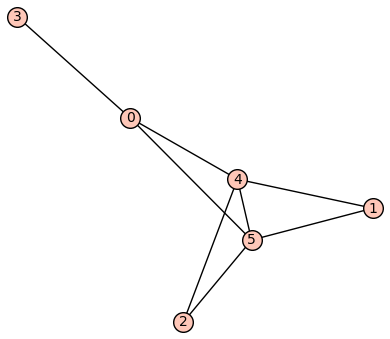

Graf  with wmdim_k = 5.0


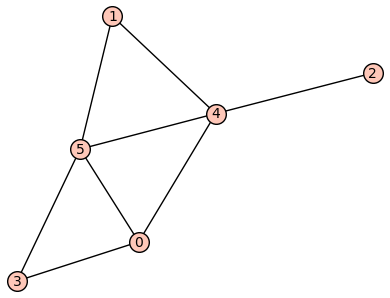

Graf  with wmdim_k = 4.0


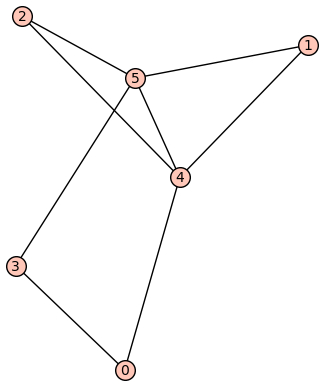

Graf  with wmdim_k = 4.0


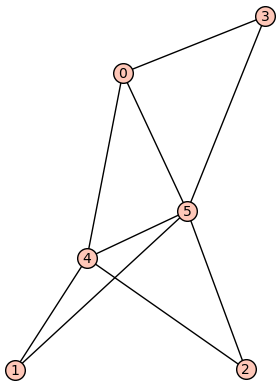

Graf  with wmdim_k = 5.0


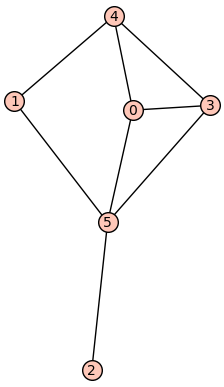

Graf  with wmdim_k = 4.0


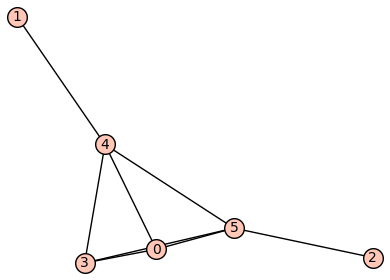

Graf  with wmdim_k = 4.0


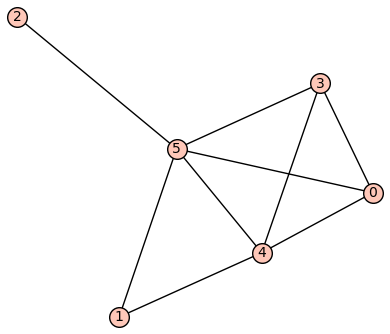

Graf  with wmdim_k = 5.0


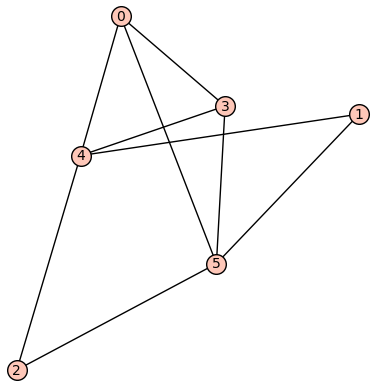

Graf  with wmdim_k = 5.0


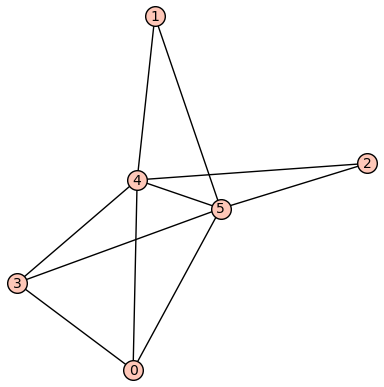

Graf  with wmdim_k = 6.0


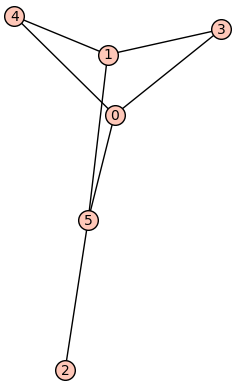

Graf  with wmdim_k = 4.0


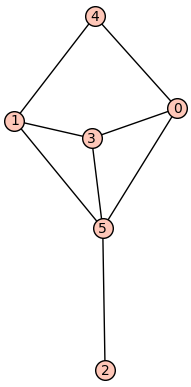

Graf  with wmdim_k = 4.0


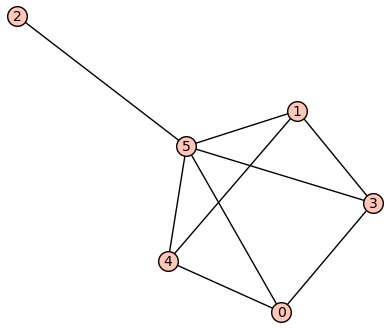

Graf  with wmdim_k = 5.0


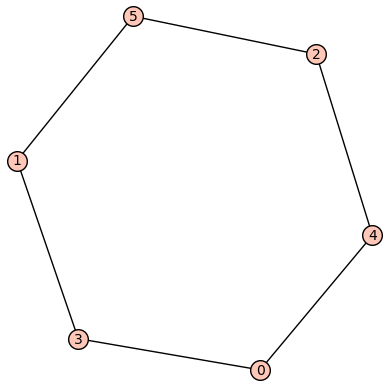

Graf  with wmdim_k = 4.0


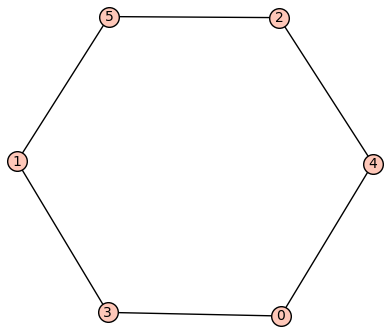

Graf  with wmdim_k = 6.0


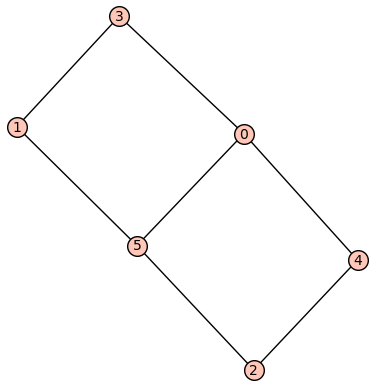

Graf  with wmdim_k = 4.0


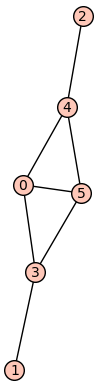

Graf  with wmdim_k = 4.0


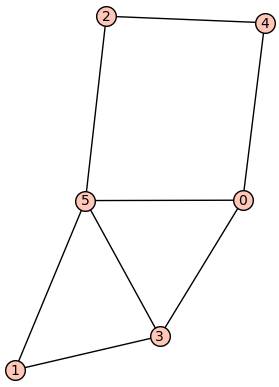

Graf  with wmdim_k = 4.0


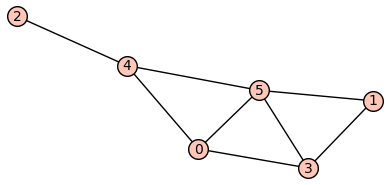

Graf  with wmdim_k = 4.0


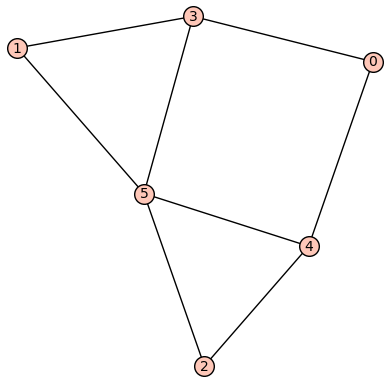

Graf  with wmdim_k = 4.0


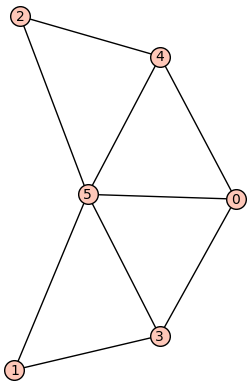

Graf  with wmdim_k = 5.0


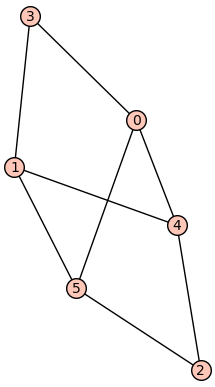

Graf  with wmdim_k = 4.0


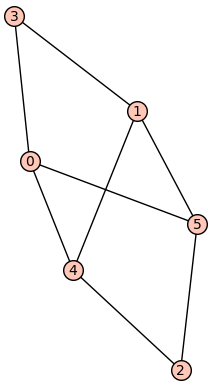

Graf  with wmdim_k = 6.0


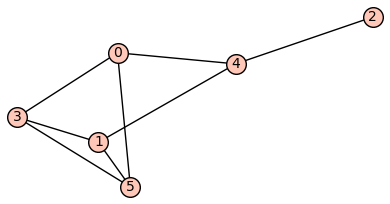

Graf  with wmdim_k = 4.0


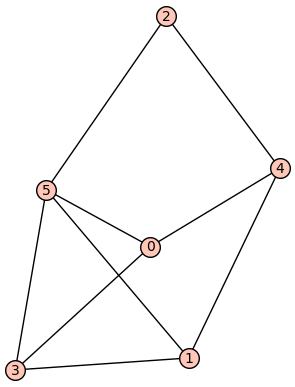

Graf  with wmdim_k = 4.0


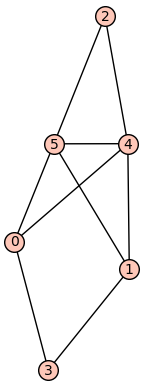

Graf  with wmdim_k = 5.0


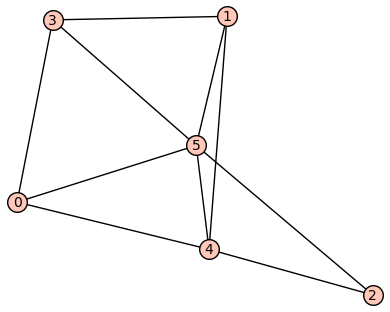

Graf  with wmdim_k = 5.0


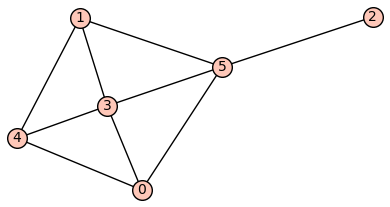

Graf  with wmdim_k = 4.0


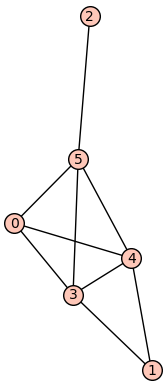

Graf  with wmdim_k = 5.0


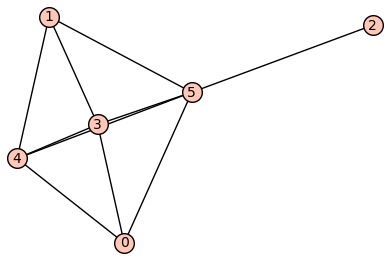

Graf  with wmdim_k = 5.0


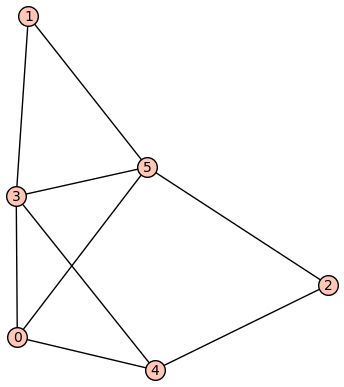

Graf  with wmdim_k = 4.0


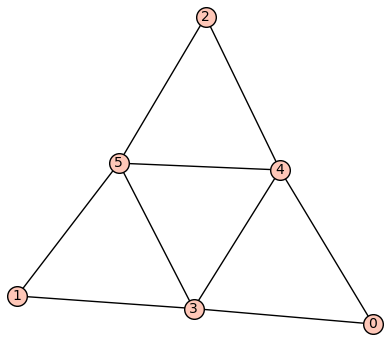

Graf  with wmdim_k = 5.0


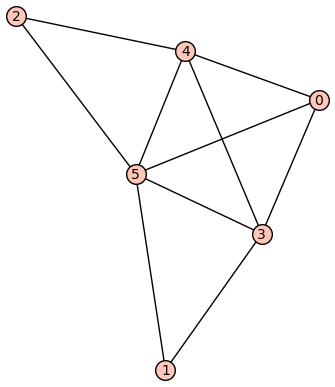

Graf  with wmdim_k = 5.0


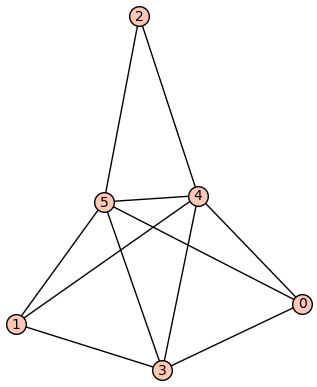

Graf  with wmdim_k = 6.0


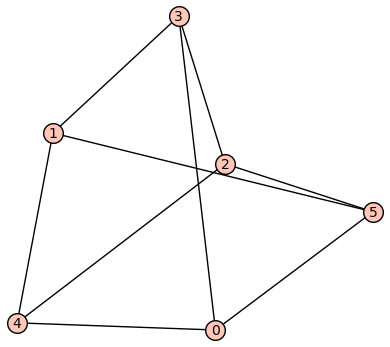

Graf  with wmdim_k = 4.0


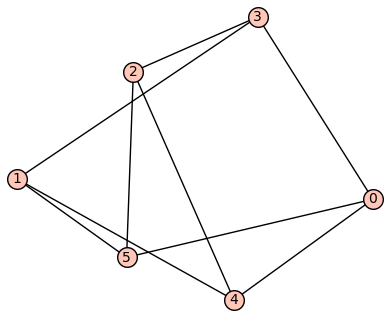

Graf  with wmdim_k = 6.0


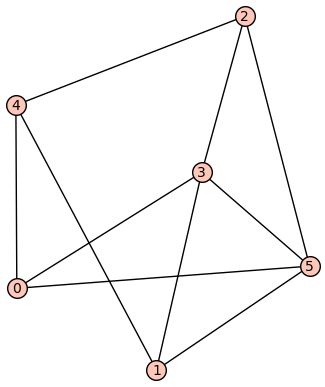

Graf  with wmdim_k = 5.0


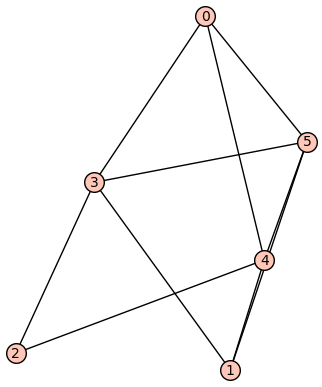

Graf  with wmdim_k = 5.0


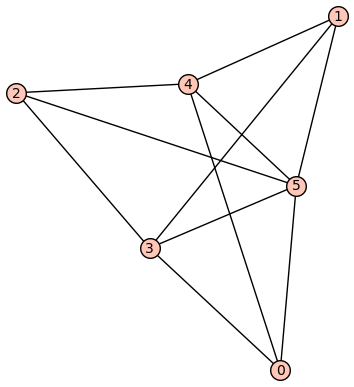

Graf  with wmdim_k = 5.0


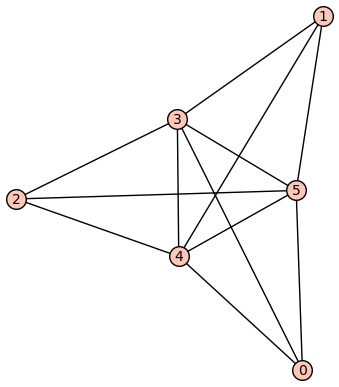

Graf  with wmdim_k = 6.0


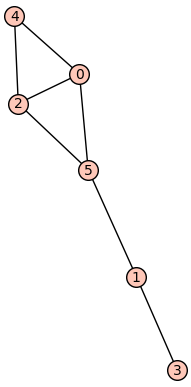

Graf  with wmdim_k = 4.0


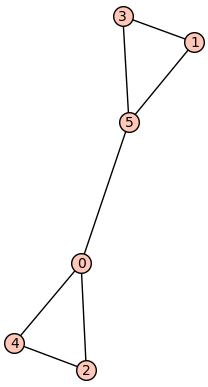

Graf  with wmdim_k = 4.0


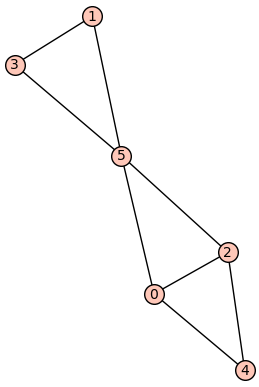

Graf  with wmdim_k = 5.0


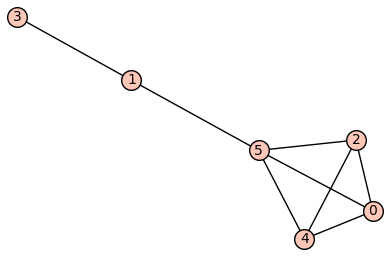

Graf  with wmdim_k = 4.0


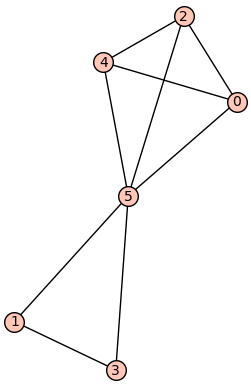

Graf  with wmdim_k = 5.0


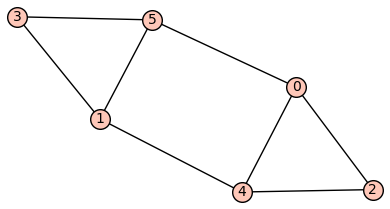

Graf  with wmdim_k = 4.0


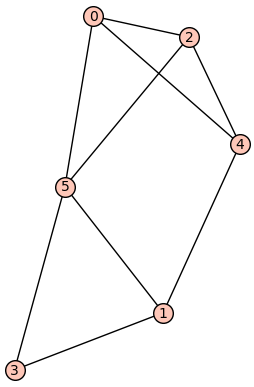

Graf  with wmdim_k = 4.0


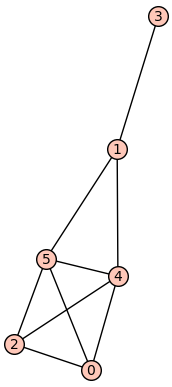

Graf  with wmdim_k = 5.0


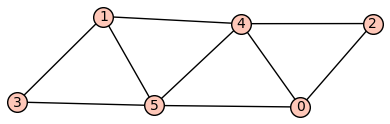

Graf  with wmdim_k = 4.0


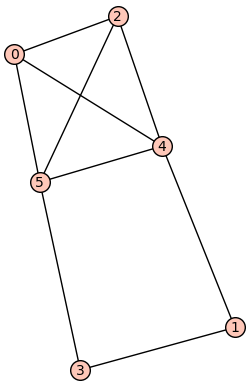

Graf  with wmdim_k = 4.0


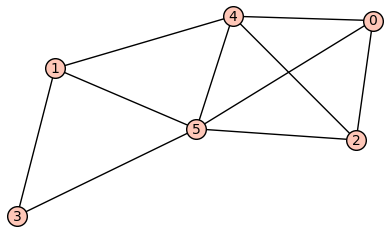

Graf  with wmdim_k = 5.0


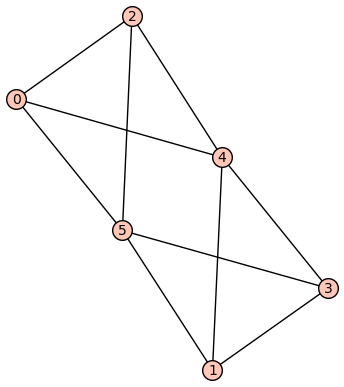

Graf  with wmdim_k = 5.0


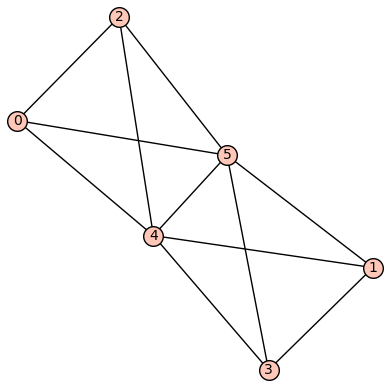

Graf  with wmdim_k = 6.0


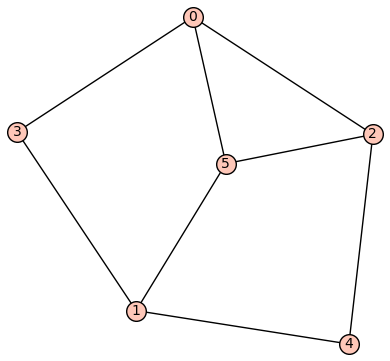

Graf  with wmdim_k = 4.0


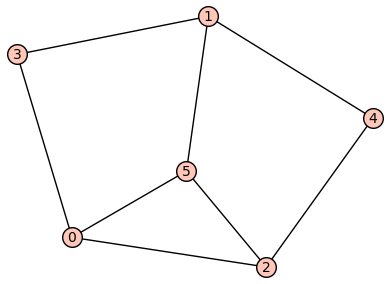

Graf  with wmdim_k = 6.0


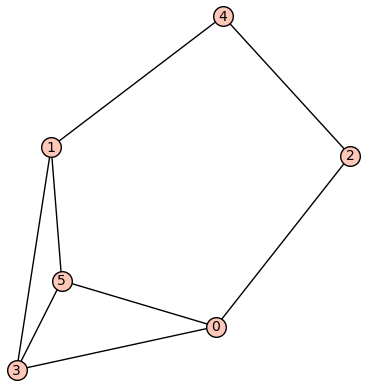

Graf  with wmdim_k = 4.0


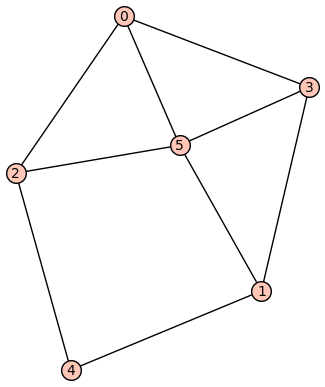

Graf  with wmdim_k = 4.0


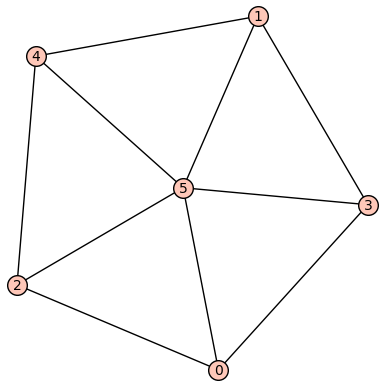

Graf  with wmdim_k = 5.0


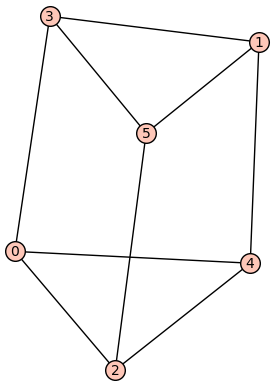

Graf  with wmdim_k = 4.0


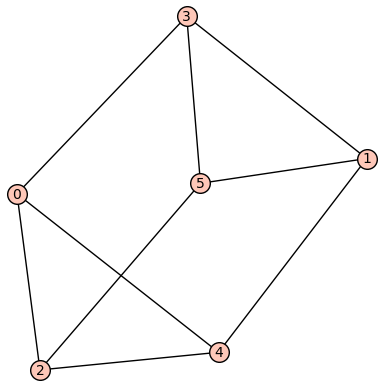

Graf  with wmdim_k = 6.0


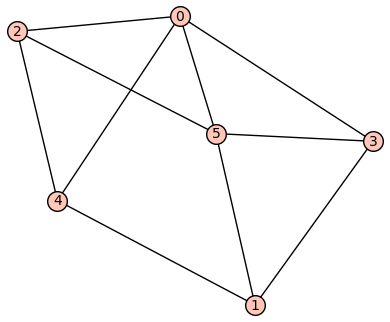

Graf  with wmdim_k = 4.0


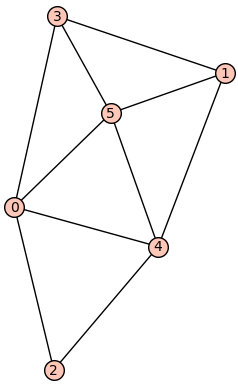

Graf  with wmdim_k = 5.0


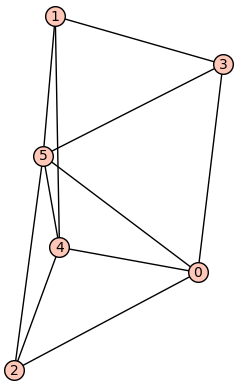

Graf  with wmdim_k = 5.0


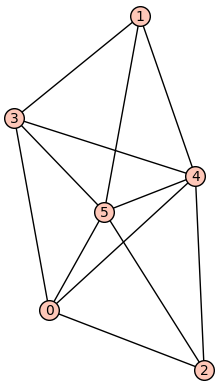

Graf  with wmdim_k = 6.0


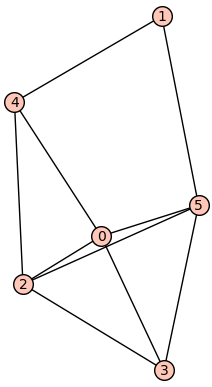

Graf  with wmdim_k = 5.0


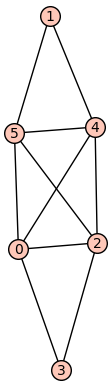

Graf  with wmdim_k = 6.0


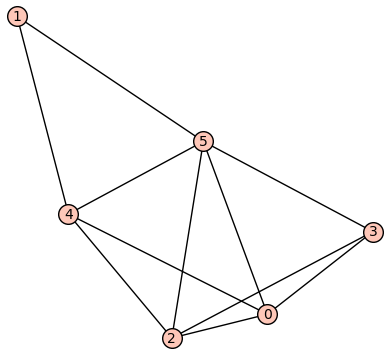

Graf  with wmdim_k = 5.0


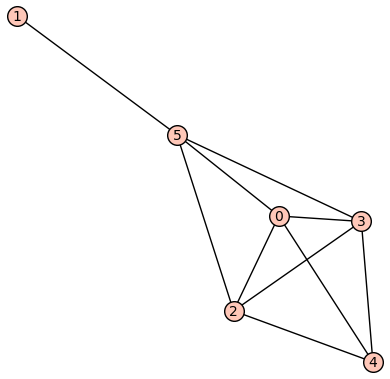

Graf  with wmdim_k = 5.0


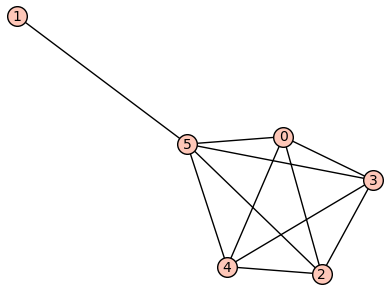

Graf  with wmdim_k = 5.0


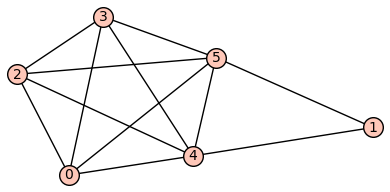

Graf  with wmdim_k = 6.0


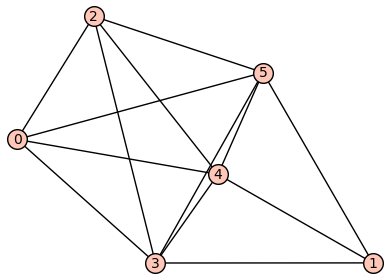

Graf  with wmdim_k = 6.0


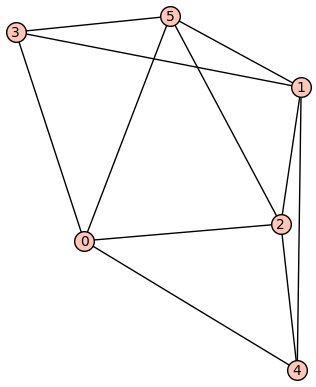

Graf  with wmdim_k = 5.0


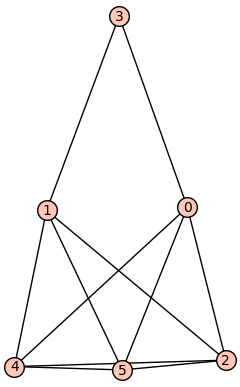

Graf  with wmdim_k = 5.0


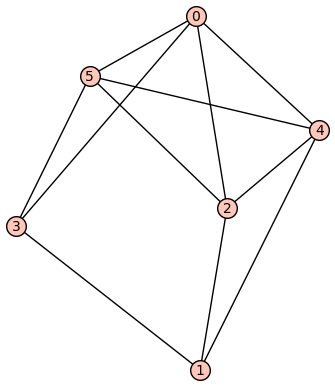

Graf  with wmdim_k = 5.0


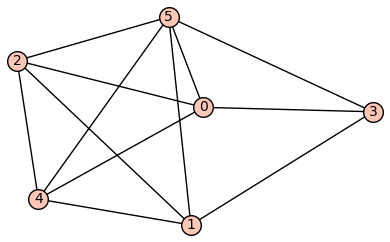

Graf  with wmdim_k = 5.0


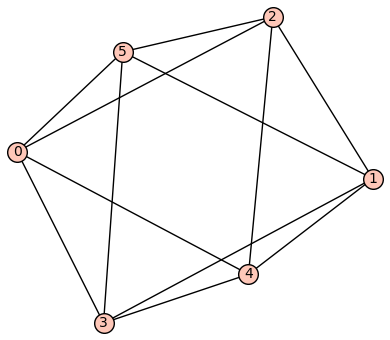

Graf  with wmdim_k = 5.0


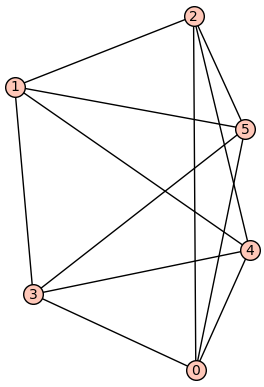

Graf  with wmdim_k = 6.0


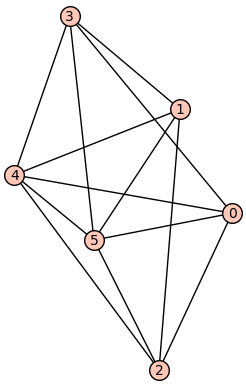

Graf  with wmdim_k = 6.0


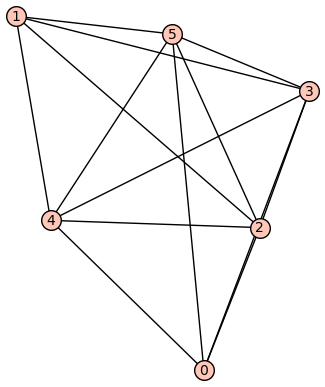

Graf  with wmdim_k = 6.0


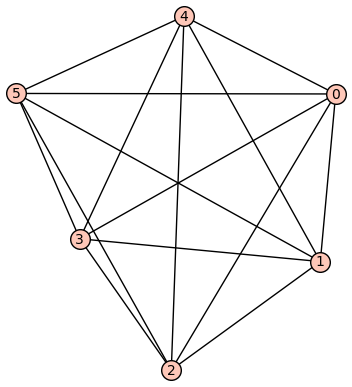

Graf  with wmdim_k = 6.0

Povezani grafi na 7 vozliscih z wmdim_k(G) v [5, 6, 7]:


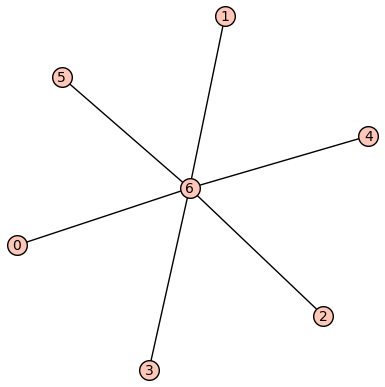

Graf  with wmdim_k = 6.0


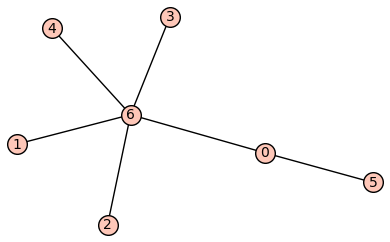

Graf  with wmdim_k = 5.0


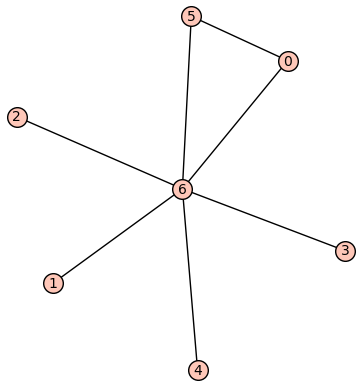

Graf  with wmdim_k = 6.0


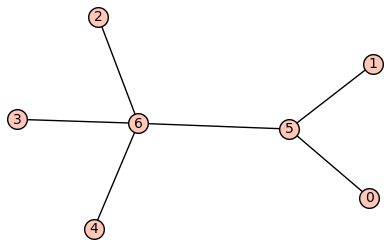

Graf  with wmdim_k = 5.0


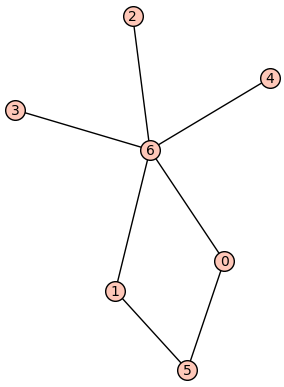

Graf  with wmdim_k = 5.0


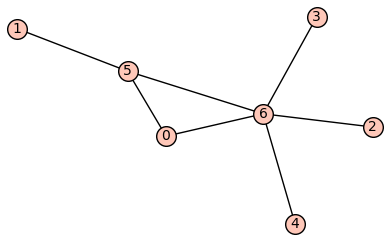

Graf  with wmdim_k = 5.0


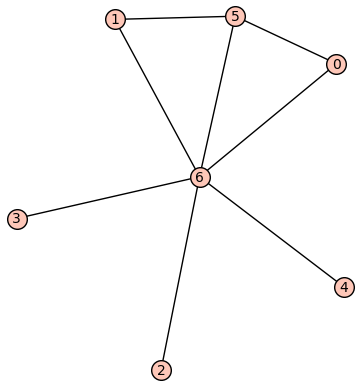

Graf  with wmdim_k = 6.0


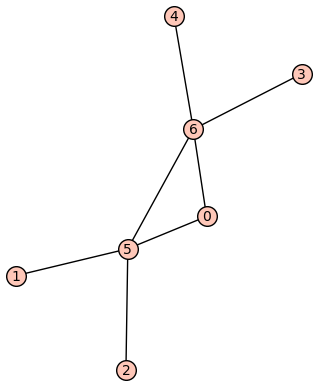

Graf  with wmdim_k = 5.0


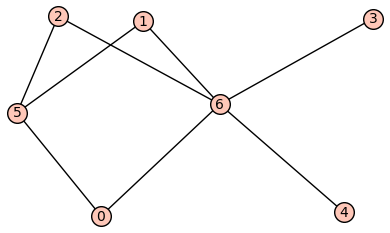

Graf  with wmdim_k = 5.0


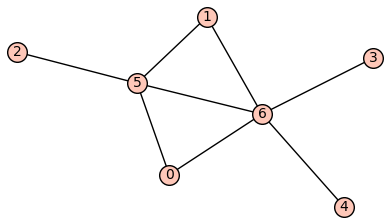

Graf  with wmdim_k = 5.0


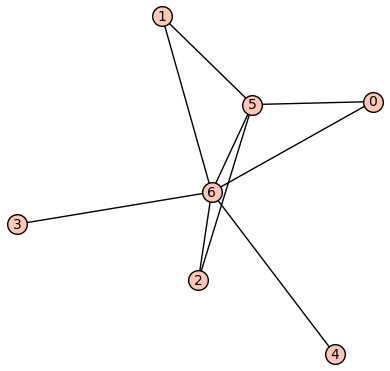

Graf  with wmdim_k = 6.0


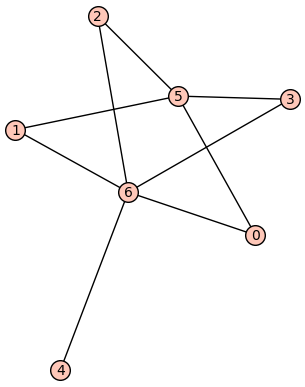

Graf  with wmdim_k = 5.0


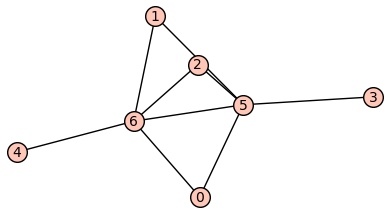

Graf  with wmdim_k = 5.0


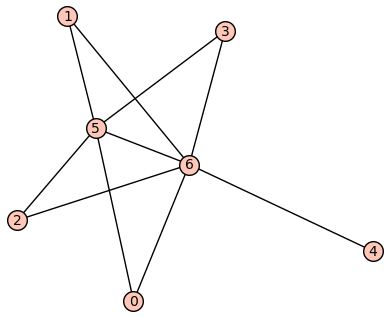

Graf  with wmdim_k = 6.0


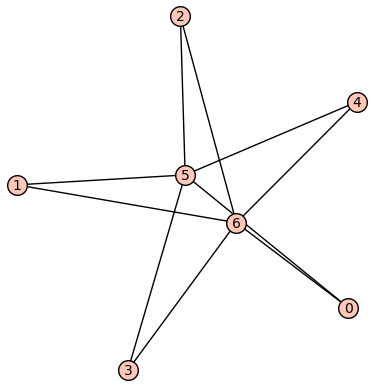

Graf  with wmdim_k = 6.0


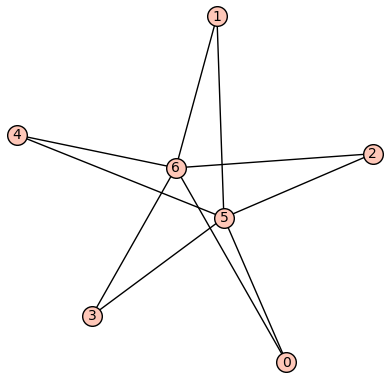

Graf  with wmdim_k = 7.0


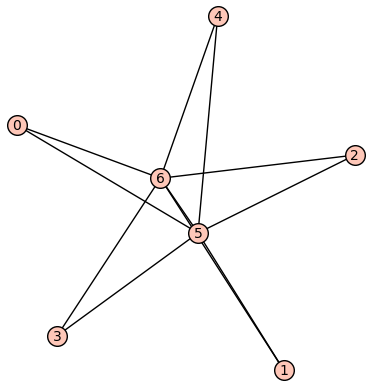

Graf  with wmdim_k = 7.0


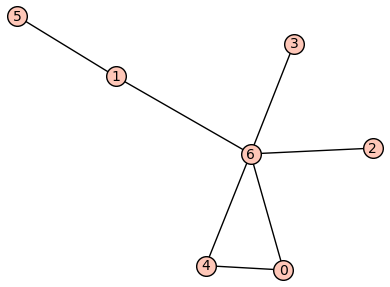

Graf  with wmdim_k = 5.0


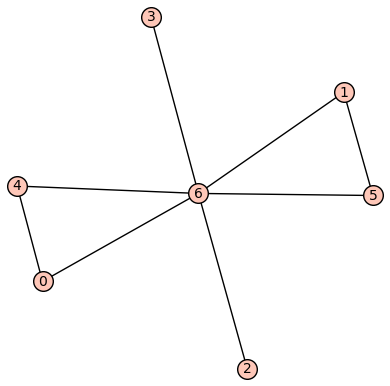

Graf  with wmdim_k = 6.0


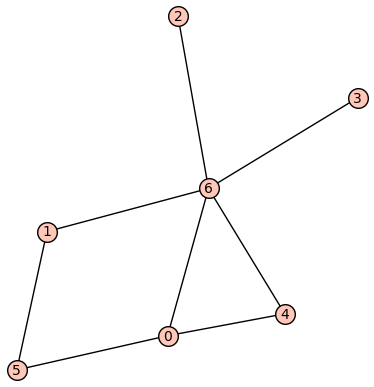

Graf  with wmdim_k = 5.0


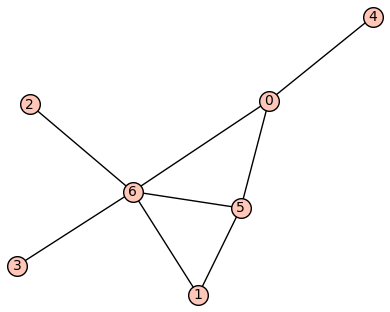

Graf  with wmdim_k = 5.0


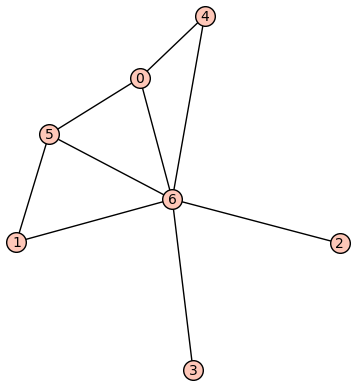

Graf  with wmdim_k = 6.0


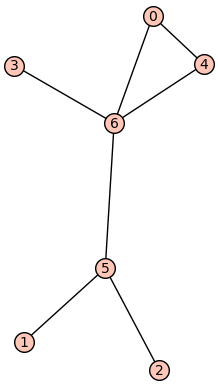

Graf  with wmdim_k = 5.0


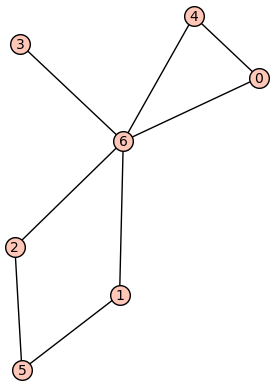

Graf  with wmdim_k = 5.0


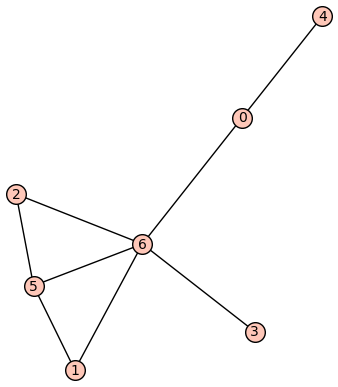

Graf  with wmdim_k = 5.0


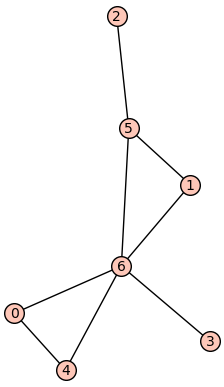

Graf  with wmdim_k = 5.0


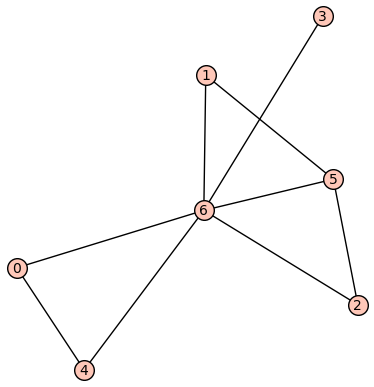

Graf  with wmdim_k = 6.0


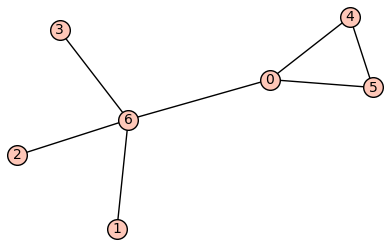

Graf  with wmdim_k = 5.0


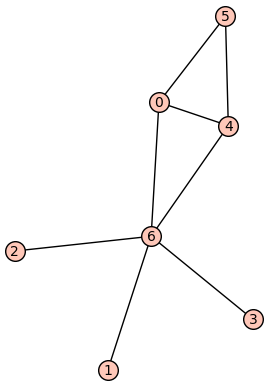

Graf  with wmdim_k = 6.0


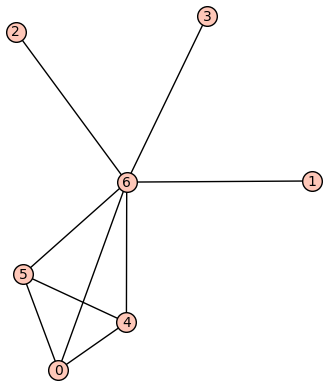

Graf  with wmdim_k = 6.0


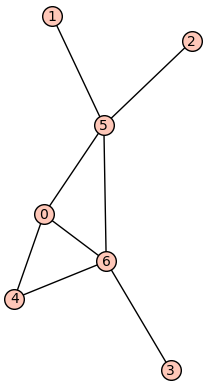

Graf  with wmdim_k = 5.0


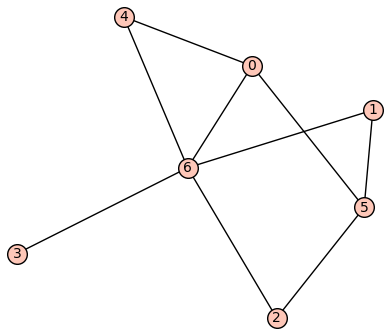

Graf  with wmdim_k = 5.0


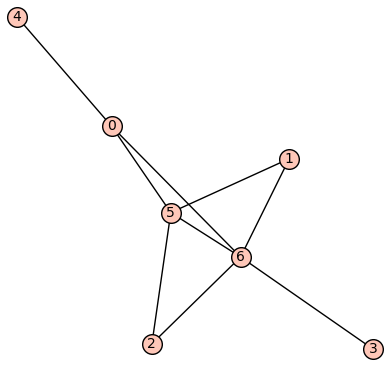

Graf  with wmdim_k = 5.0


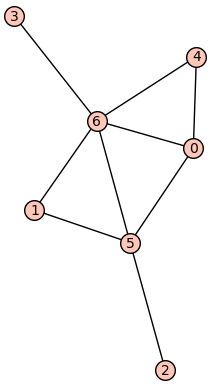

Graf  with wmdim_k = 5.0


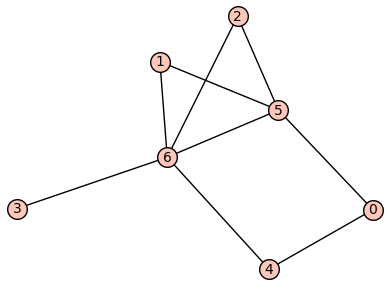

Graf  with wmdim_k = 5.0


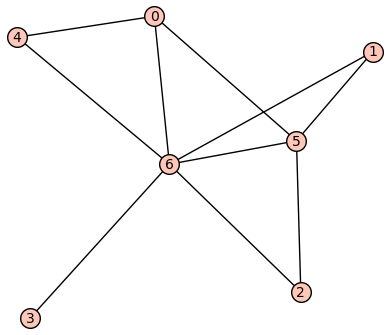

Graf  with wmdim_k = 6.0


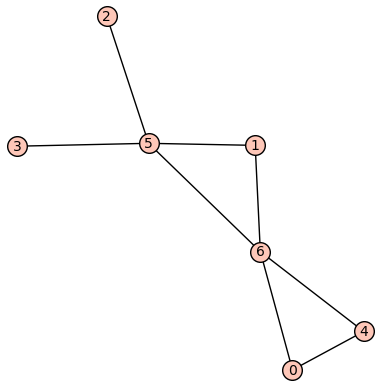

Graf  with wmdim_k = 5.0


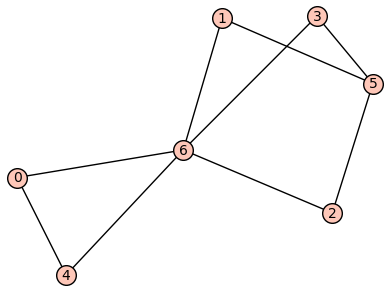

Graf  with wmdim_k = 5.0


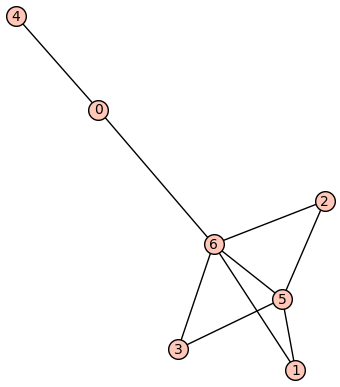

Graf  with wmdim_k = 5.0


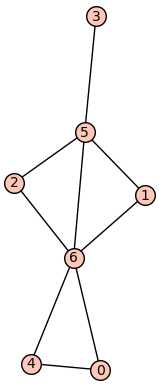

Graf  with wmdim_k = 5.0


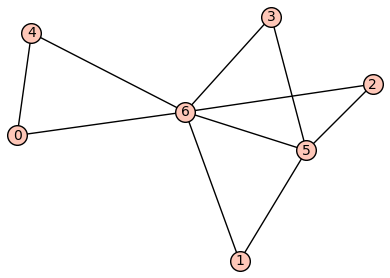

Graf  with wmdim_k = 6.0


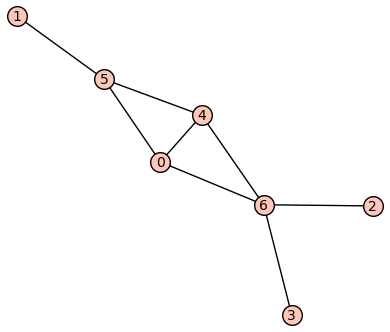

Graf  with wmdim_k = 5.0


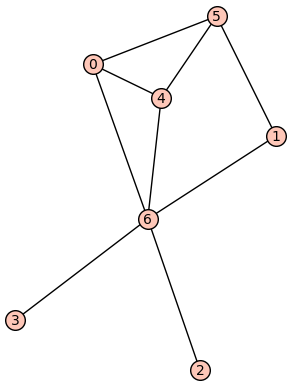

Graf  with wmdim_k = 5.0


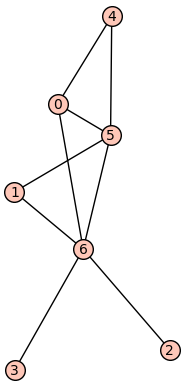

Graf  with wmdim_k = 5.0


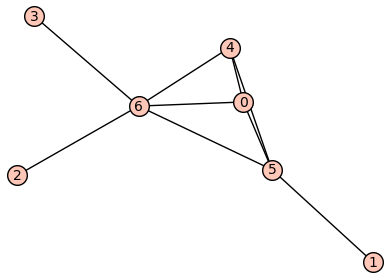

Graf  with wmdim_k = 5.0


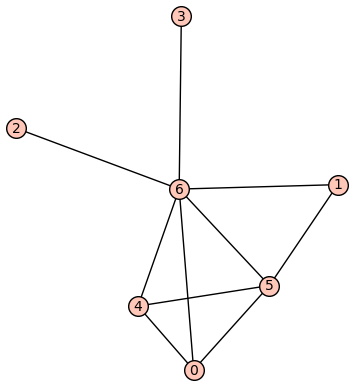

Graf  with wmdim_k = 6.0


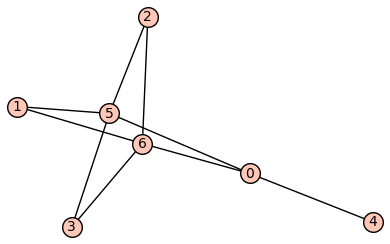

Graf  with wmdim_k = 5.0


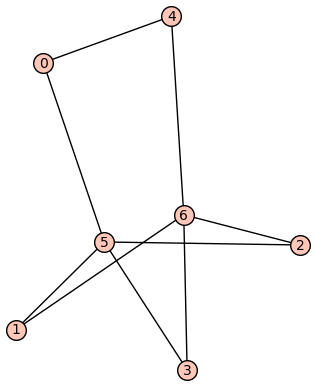

Graf  with wmdim_k = 5.0


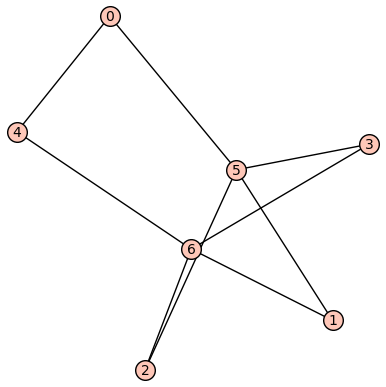

Graf  with wmdim_k = 7.0


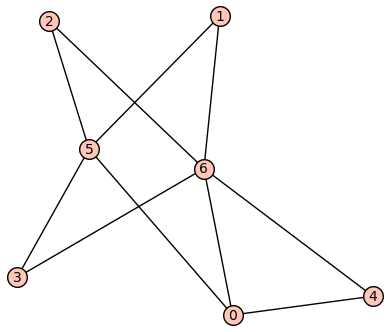

Graf  with wmdim_k = 5.0


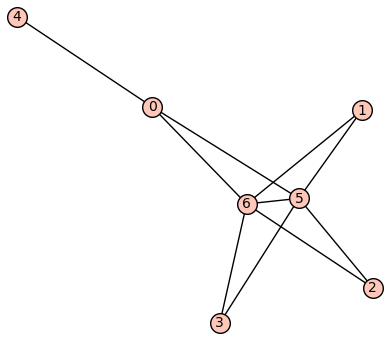

Graf  with wmdim_k = 6.0


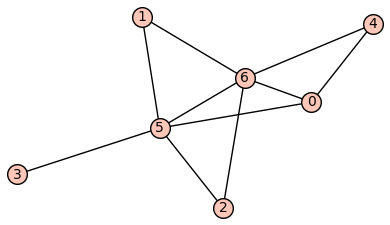

Graf  with wmdim_k = 5.0


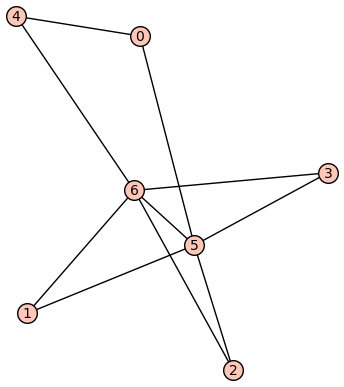

Graf  with wmdim_k = 5.0


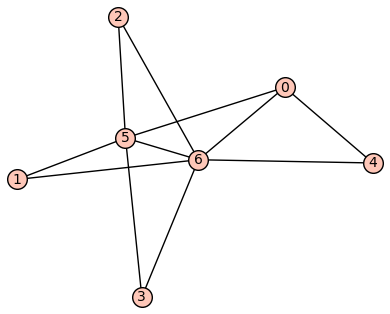

Graf  with wmdim_k = 6.0


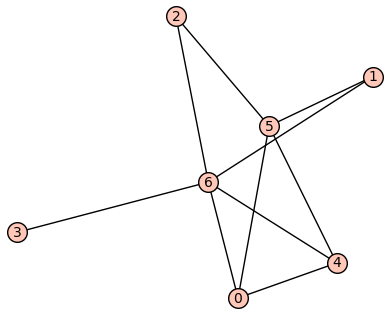

Graf  with wmdim_k = 5.0


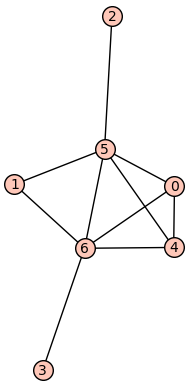

Graf  with wmdim_k = 5.0


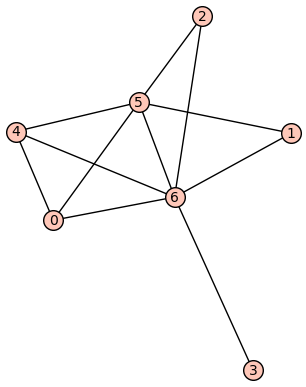

Graf  with wmdim_k = 6.0


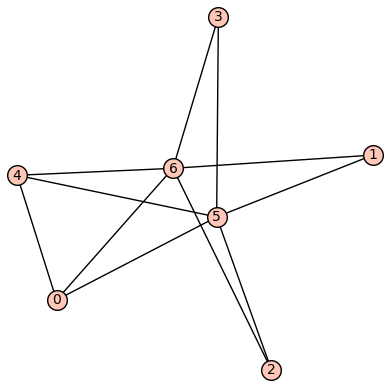

Graf  with wmdim_k = 6.0


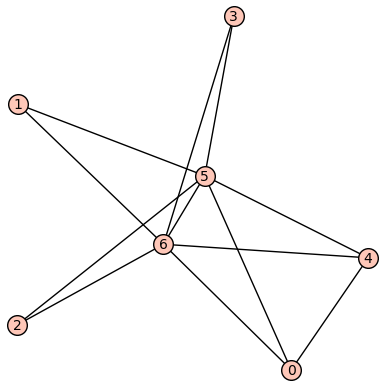

Graf  with wmdim_k = 7.0


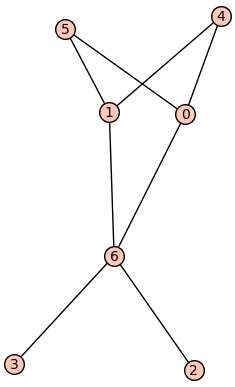

Graf  with wmdim_k = 5.0


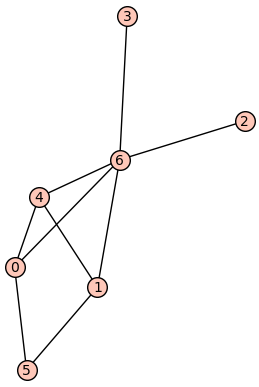

Graf  with wmdim_k = 5.0


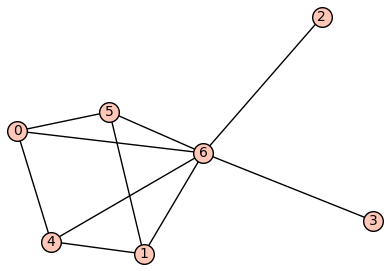

Graf  with wmdim_k = 6.0


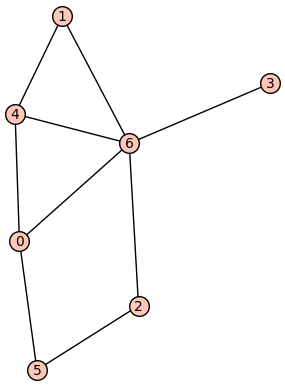

Graf  with wmdim_k = 5.0


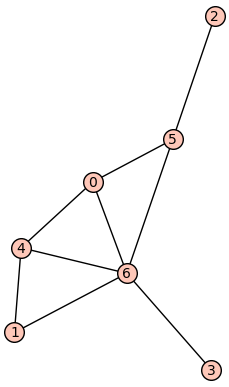

Graf  with wmdim_k = 5.0


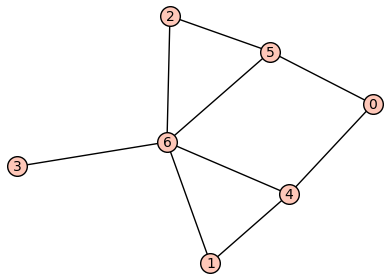

Graf  with wmdim_k = 5.0


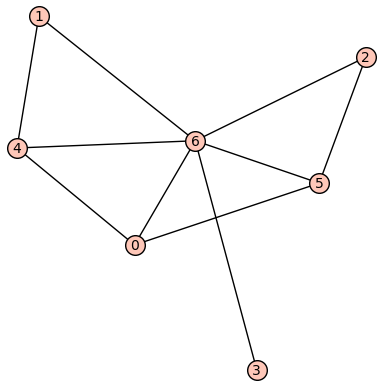

Graf  with wmdim_k = 6.0


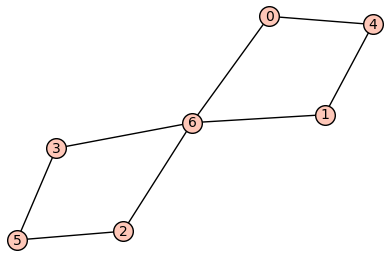

Graf  with wmdim_k = 6.0


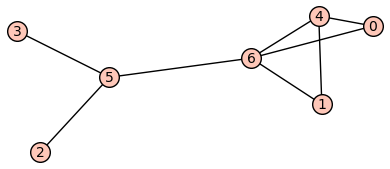

Graf  with wmdim_k = 5.0


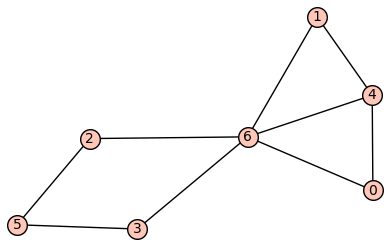

Graf  with wmdim_k = 5.0


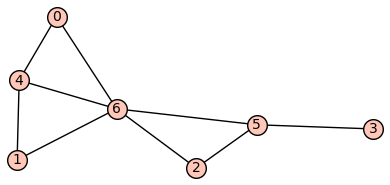

Graf  with wmdim_k = 5.0


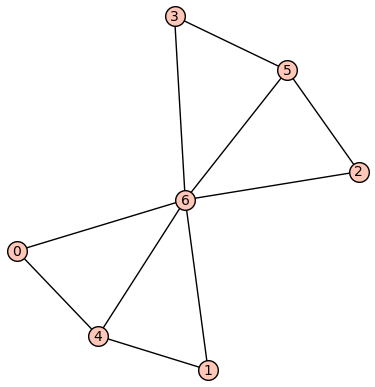

Graf  with wmdim_k = 6.0


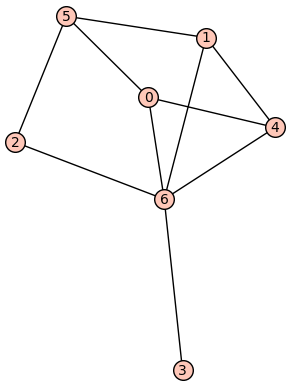

Graf  with wmdim_k = 5.0


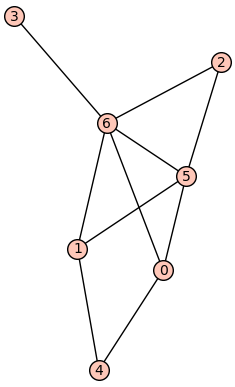

Graf  with wmdim_k = 5.0


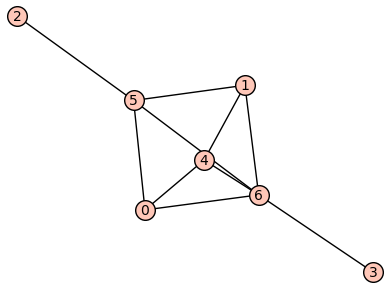

Graf  with wmdim_k = 5.0


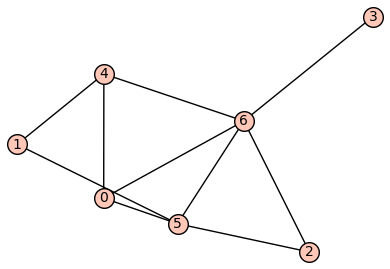

Graf  with wmdim_k = 5.0


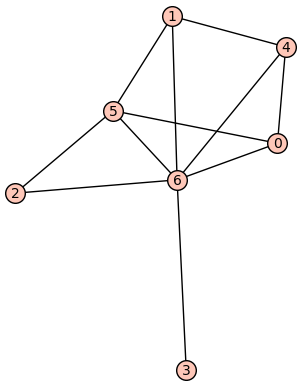

Graf  with wmdim_k = 6.0


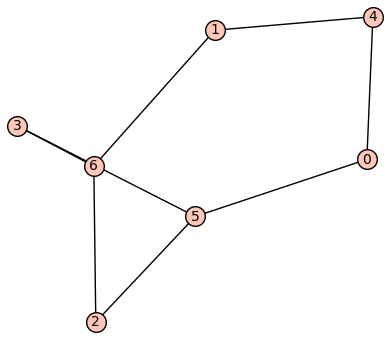

Graf  with wmdim_k = 5.0


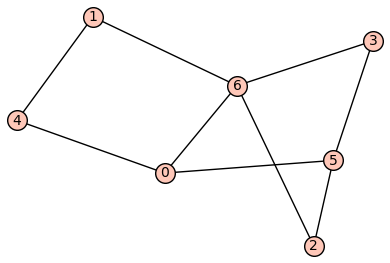

Graf  with wmdim_k = 5.0


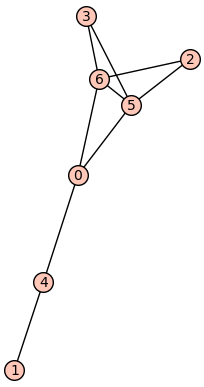

Graf  with wmdim_k = 5.0


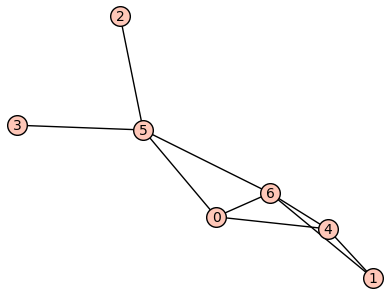

Graf  with wmdim_k = 5.0


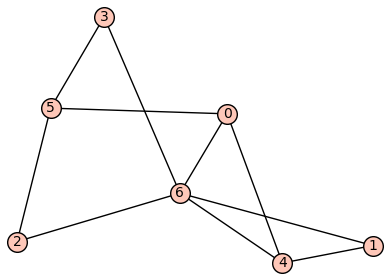

Graf  with wmdim_k = 5.0


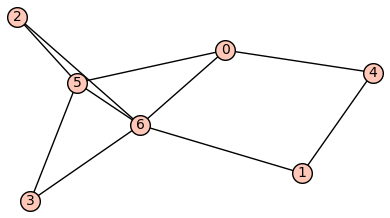

Graf  with wmdim_k = 5.0


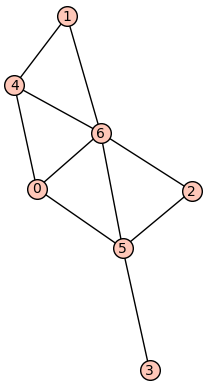

Graf  with wmdim_k = 5.0


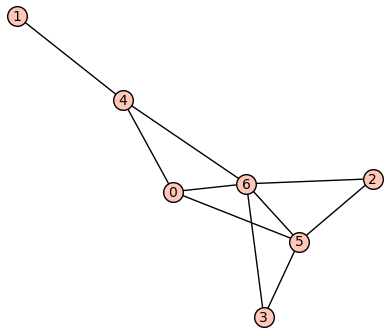

Graf  with wmdim_k = 5.0


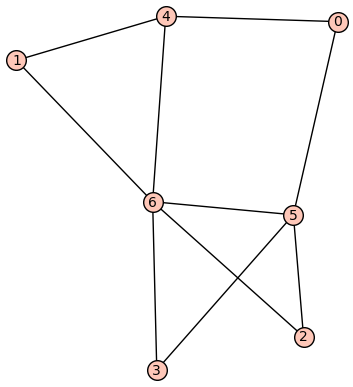

Graf  with wmdim_k = 5.0


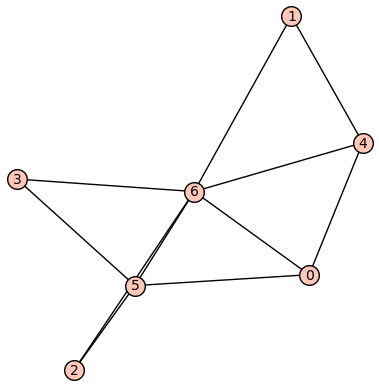

Graf  with wmdim_k = 6.0


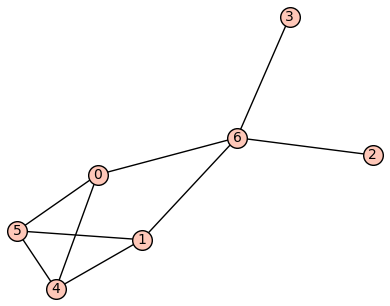

Graf  with wmdim_k = 5.0


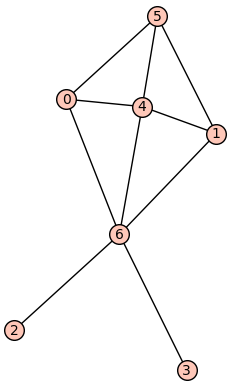

Graf  with wmdim_k = 5.0


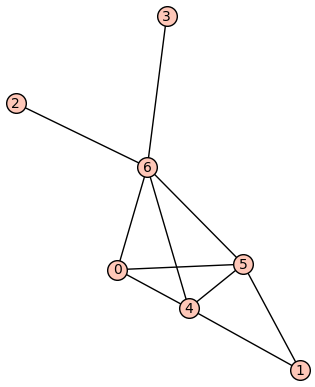

Graf  with wmdim_k = 6.0


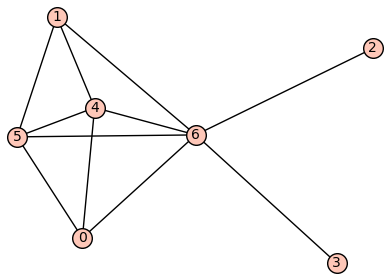

Graf  with wmdim_k = 6.0


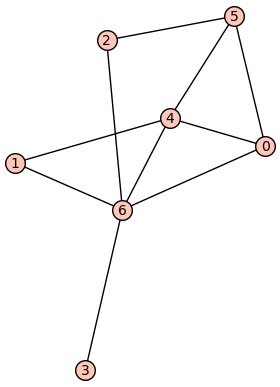

Graf  with wmdim_k = 5.0


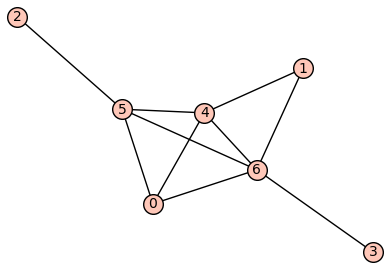

Graf  with wmdim_k = 5.0


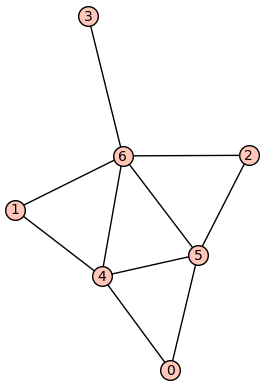

Graf  with wmdim_k = 5.0


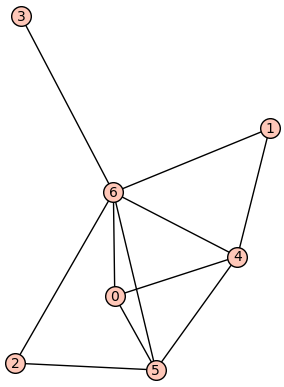

Graf  with wmdim_k = 6.0


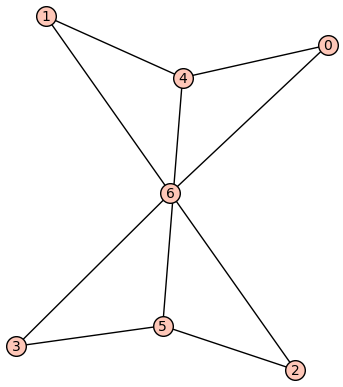

Graf  with wmdim_k = 5.0


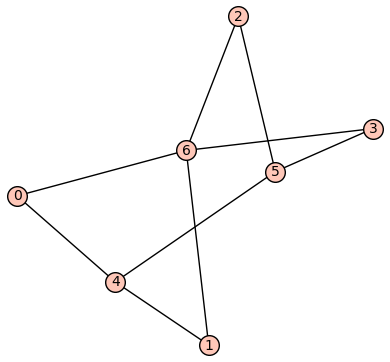

Graf  with wmdim_k = 7.0


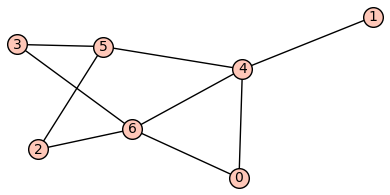

Graf  with wmdim_k = 5.0


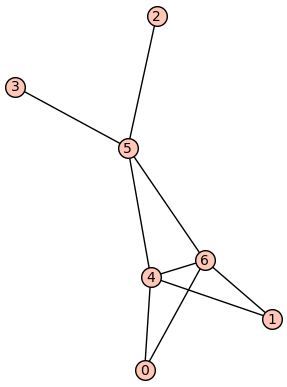

Graf  with wmdim_k = 6.0


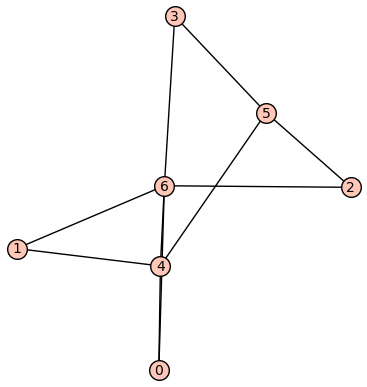

Graf  with wmdim_k = 5.0


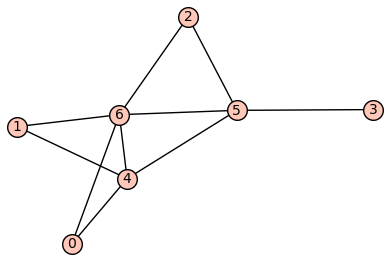

Graf  with wmdim_k = 5.0


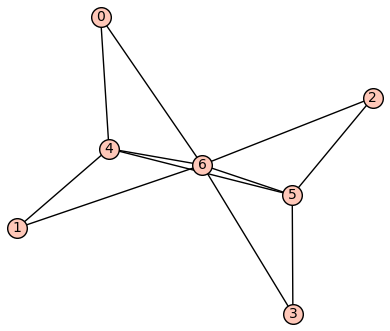

Graf  with wmdim_k = 6.0


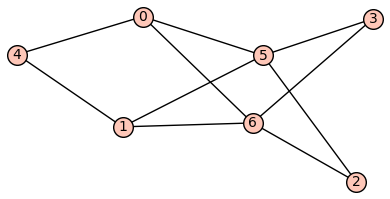

Graf  with wmdim_k = 5.0


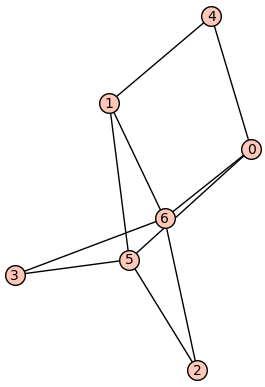

Graf  with wmdim_k = 7.0


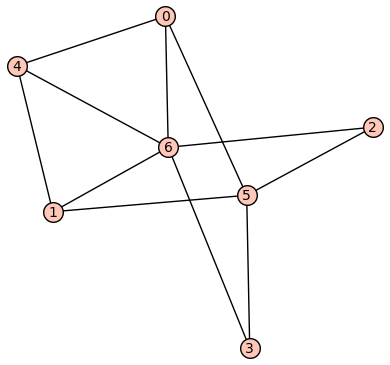

Graf  with wmdim_k = 5.0


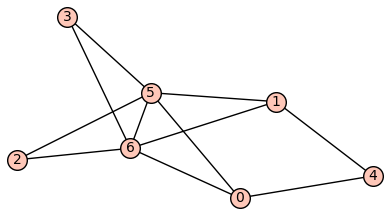

Graf  with wmdim_k = 6.0


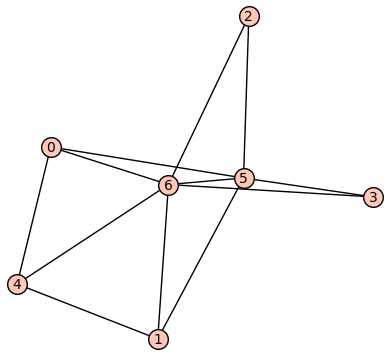

Graf  with wmdim_k = 6.0


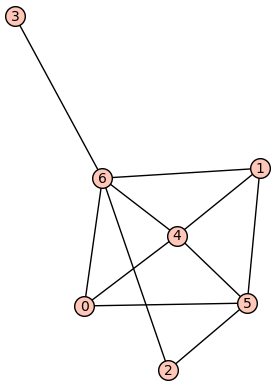

Graf  with wmdim_k = 5.0


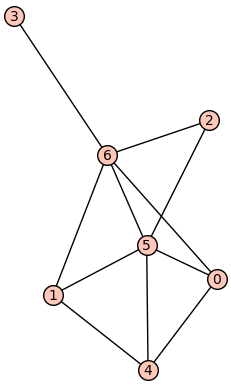

Graf  with wmdim_k = 5.0


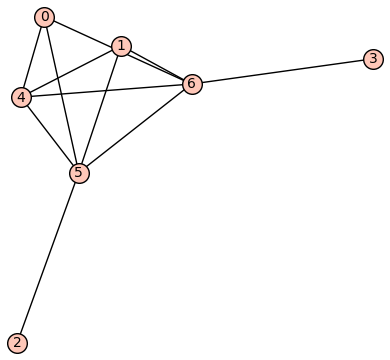

Graf  with wmdim_k = 5.0


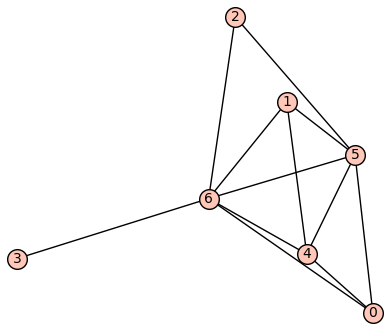

Graf  with wmdim_k = 6.0


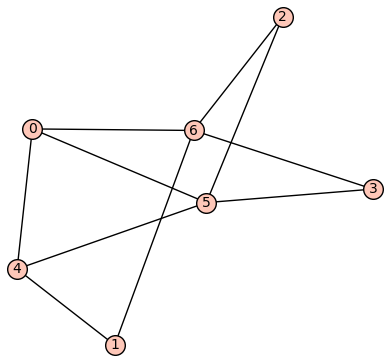

Graf  with wmdim_k = 5.0


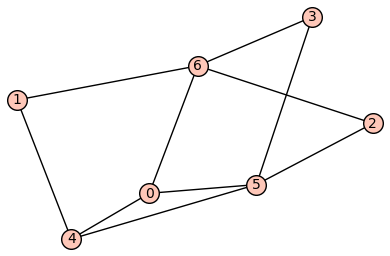

Graf  with wmdim_k = 7.0


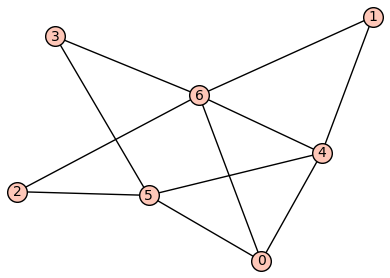

Graf  with wmdim_k = 5.0


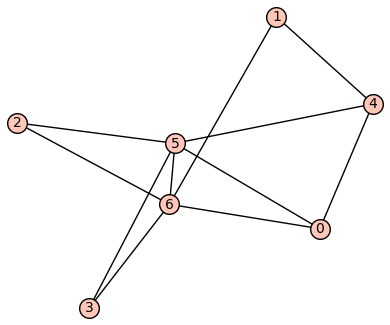

Graf  with wmdim_k = 5.0


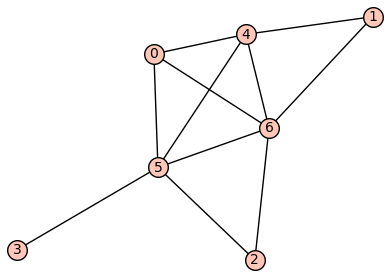

Graf  with wmdim_k = 5.0


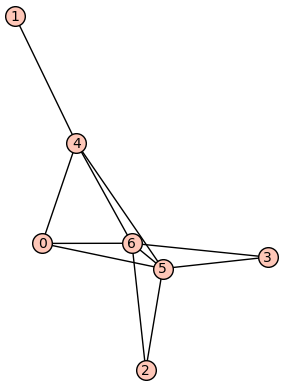

Graf  with wmdim_k = 6.0


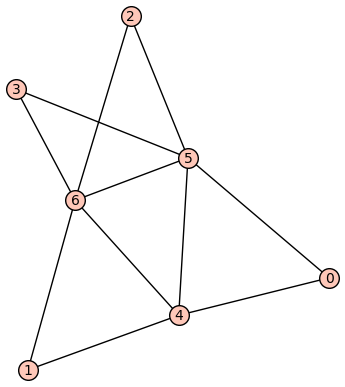

Graf  with wmdim_k = 6.0


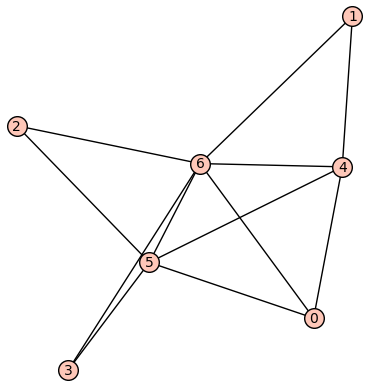

Graf  with wmdim_k = 6.0


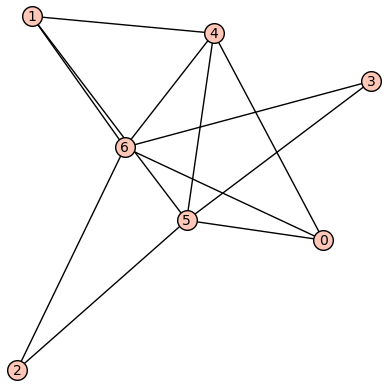

Graf  with wmdim_k = 6.0


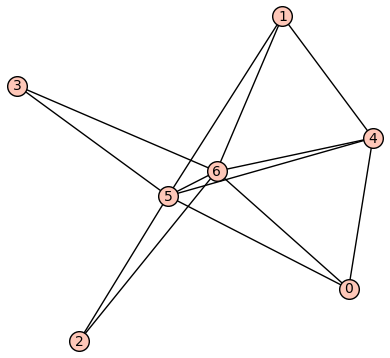

Graf  with wmdim_k = 7.0


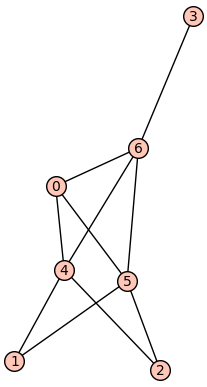

Graf  with wmdim_k = 5.0


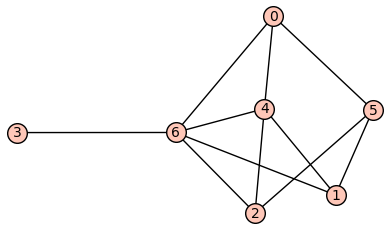

Graf  with wmdim_k = 5.0


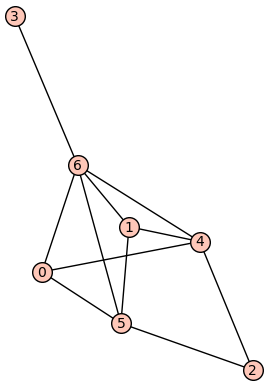

Graf  with wmdim_k = 5.0


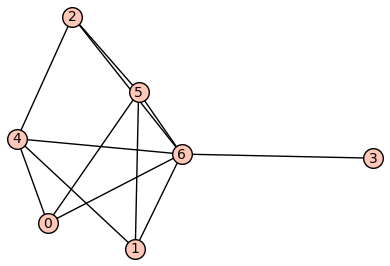

Graf  with wmdim_k = 6.0


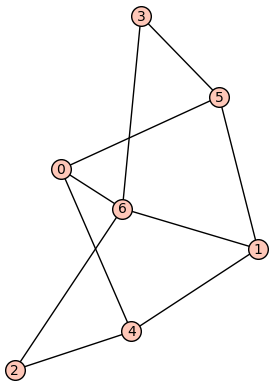

Graf  with wmdim_k = 6.0


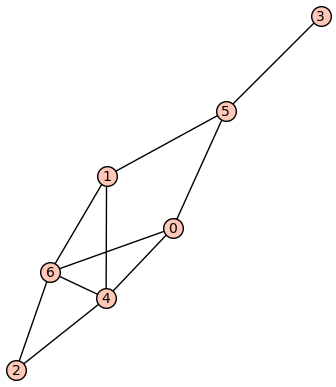

Graf  with wmdim_k = 5.0


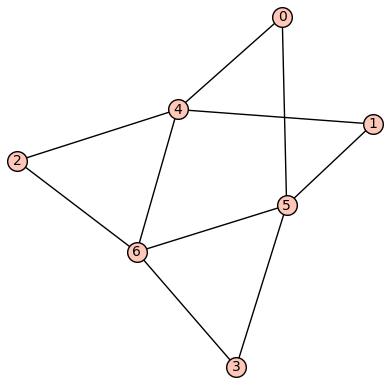

Graf  with wmdim_k = 5.0


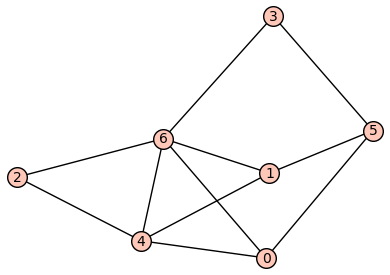

Graf  with wmdim_k = 5.0


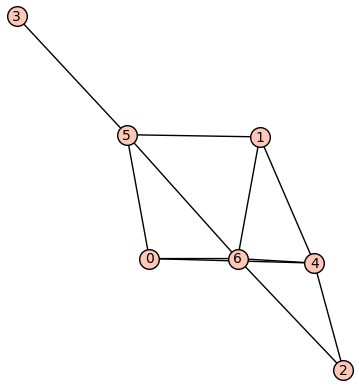

Graf  with wmdim_k = 5.0


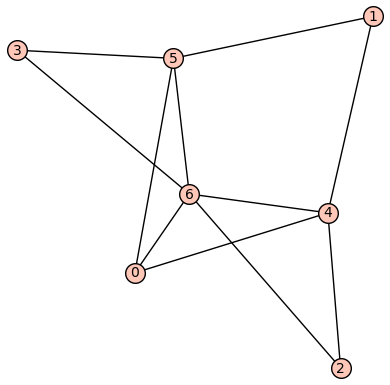

Graf  with wmdim_k = 5.0


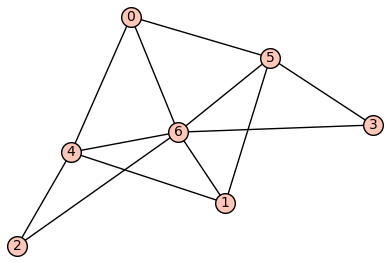

Graf  with wmdim_k = 6.0


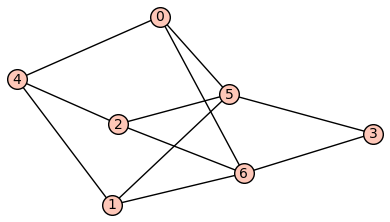

Graf  with wmdim_k = 5.0


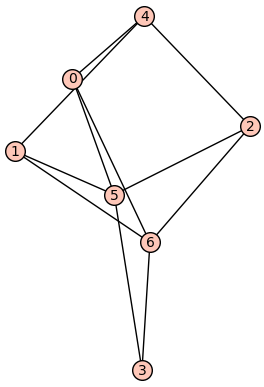

Graf  with wmdim_k = 6.0


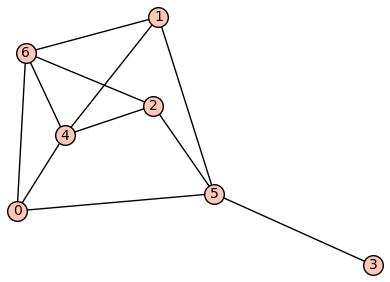

Graf  with wmdim_k = 5.0


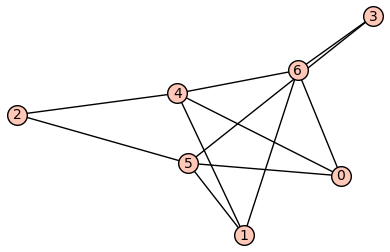

Graf  with wmdim_k = 5.0


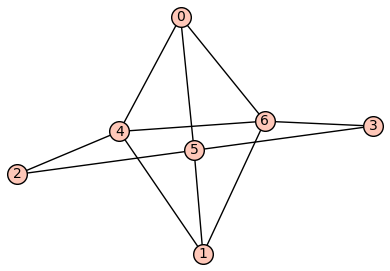

Graf  with wmdim_k = 7.0


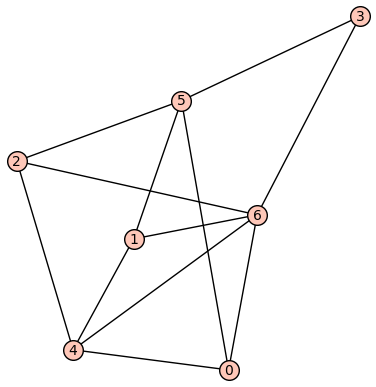

Graf  with wmdim_k = 5.0


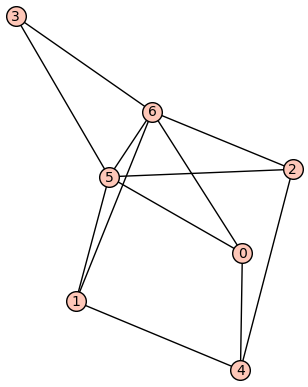

Graf  with wmdim_k = 6.0


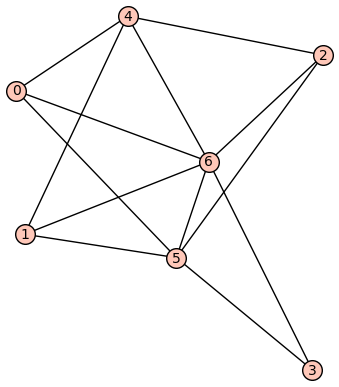

Graf  with wmdim_k = 6.0


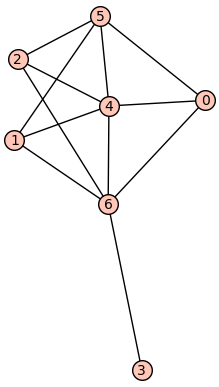

Graf  with wmdim_k = 5.0


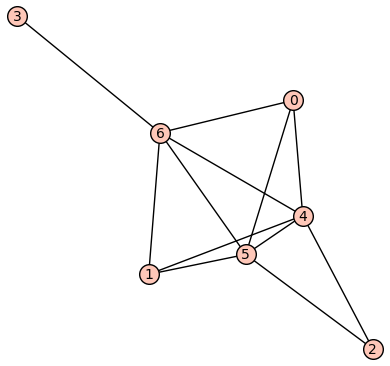

Graf  with wmdim_k = 6.0


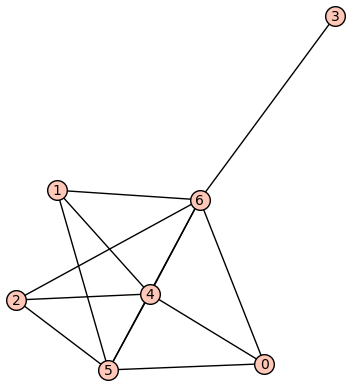

Graf  with wmdim_k = 6.0


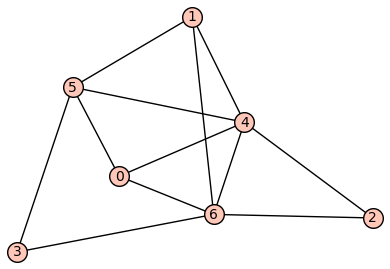

Graf  with wmdim_k = 5.0


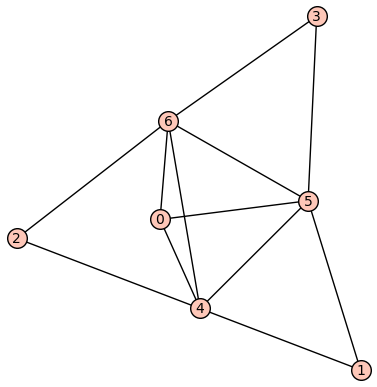

Graf  with wmdim_k = 6.0


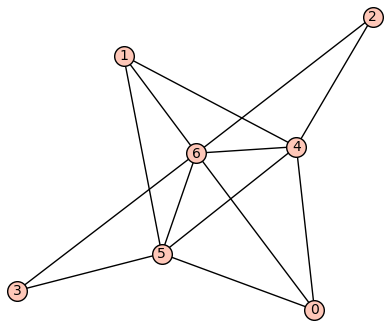

Graf  with wmdim_k = 6.0


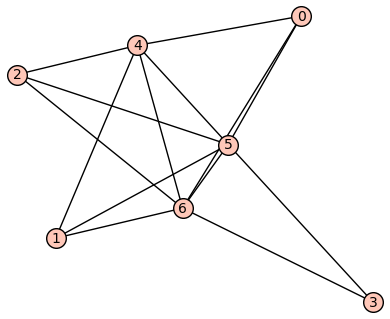

Graf  with wmdim_k = 7.0


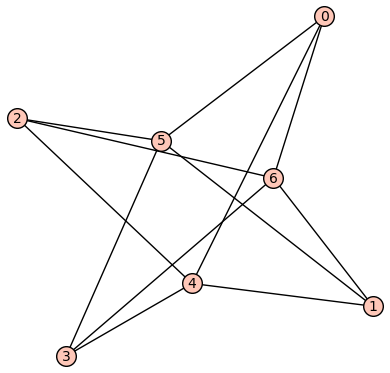

Graf  with wmdim_k = 5.0


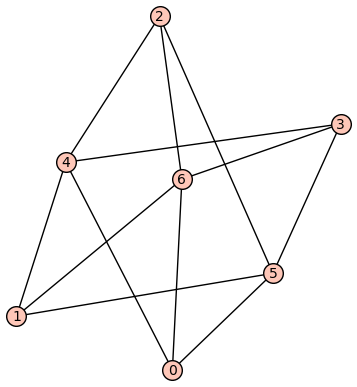

Graf  with wmdim_k = 7.0


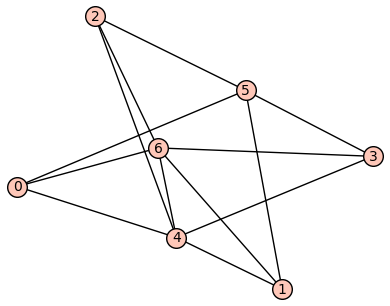

Graf  with wmdim_k = 6.0


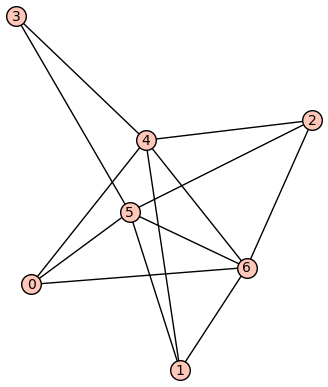

Graf  with wmdim_k = 6.0


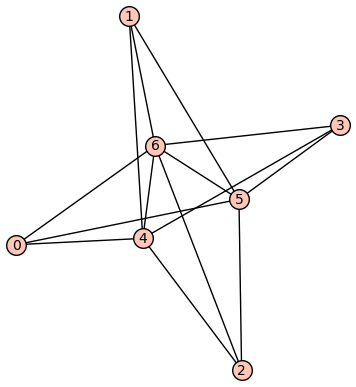

Graf  with wmdim_k = 6.0


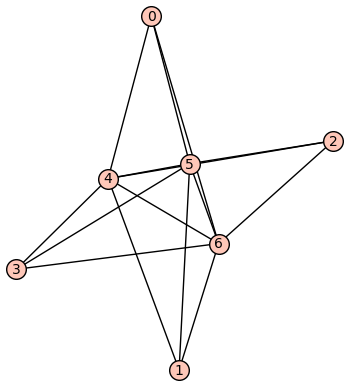

Graf  with wmdim_k = 7.0


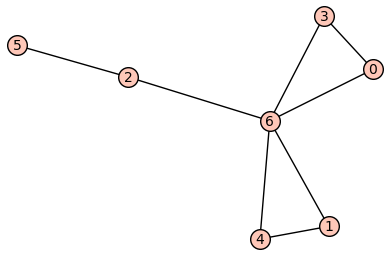

Graf  with wmdim_k = 5.0


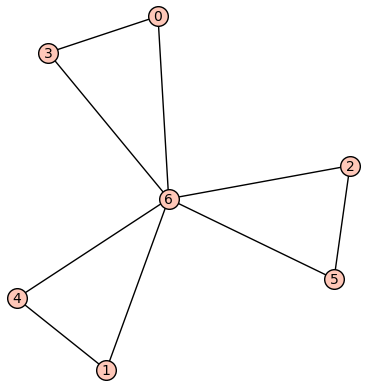

Graf  with wmdim_k = 6.0


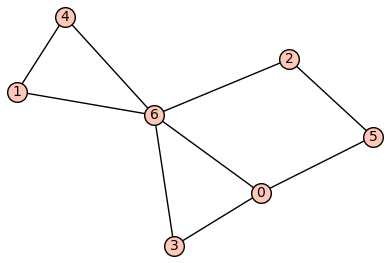

Graf  with wmdim_k = 5.0


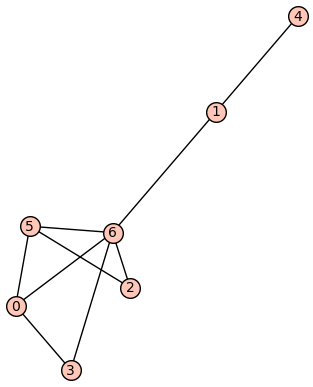

Graf  with wmdim_k = 5.0


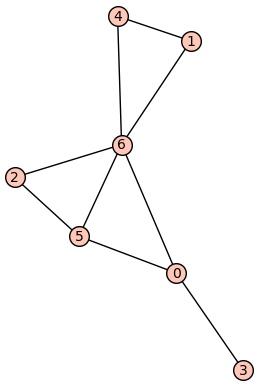

Graf  with wmdim_k = 5.0


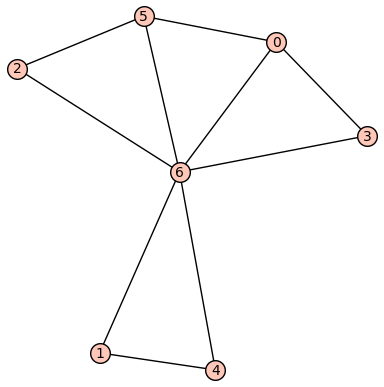

Graf  with wmdim_k = 6.0


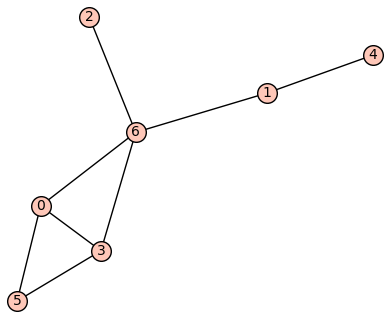

Graf  with wmdim_k = 5.0


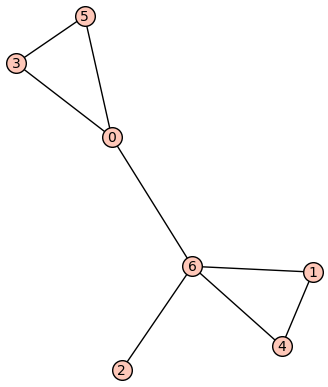

Graf  with wmdim_k = 5.0


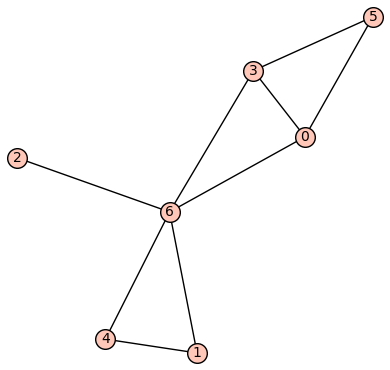

Graf  with wmdim_k = 6.0


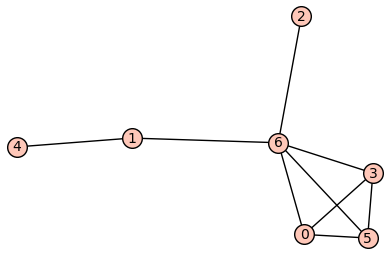

Graf  with wmdim_k = 5.0


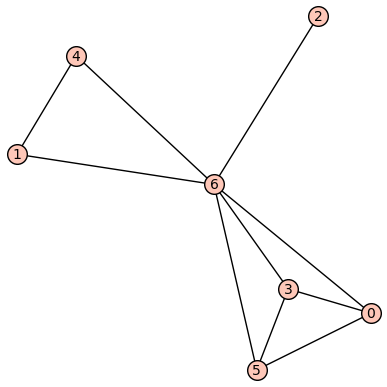

Graf  with wmdim_k = 6.0


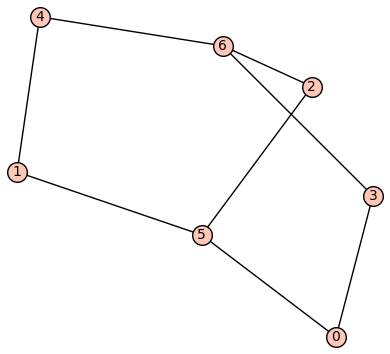

Graf  with wmdim_k = 7.0


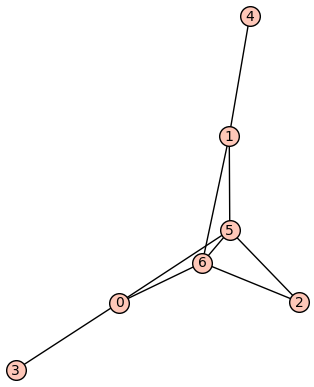

Graf  with wmdim_k = 5.0


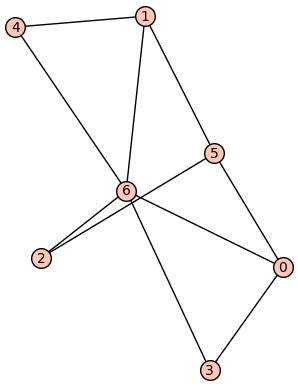

Graf  with wmdim_k = 5.0


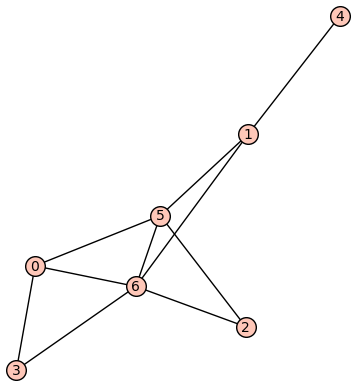

Graf  with wmdim_k = 5.0


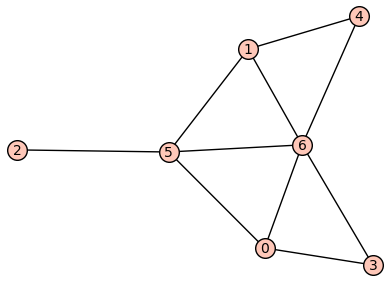

Graf  with wmdim_k = 5.0


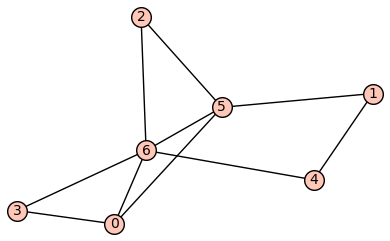

Graf  with wmdim_k = 5.0


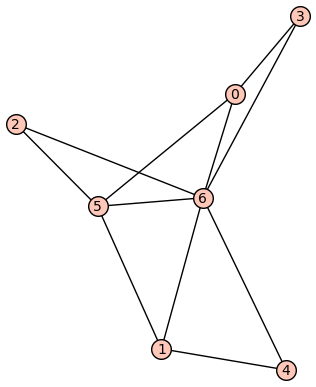

Graf  with wmdim_k = 6.0


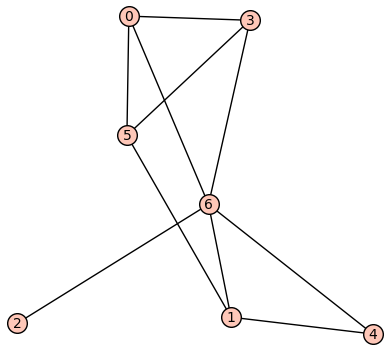

Graf  with wmdim_k = 5.0


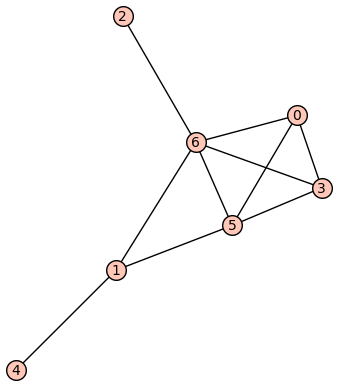

Graf  with wmdim_k = 5.0


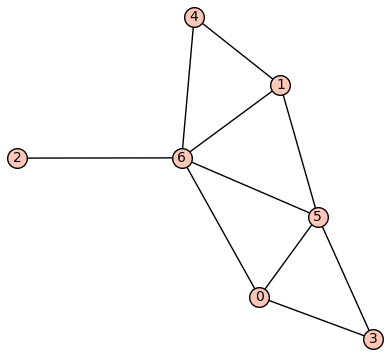

Graf  with wmdim_k = 5.0


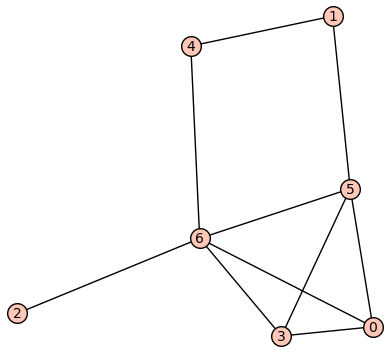

Graf  with wmdim_k = 5.0


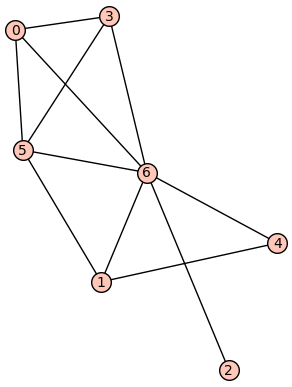

Graf  with wmdim_k = 6.0


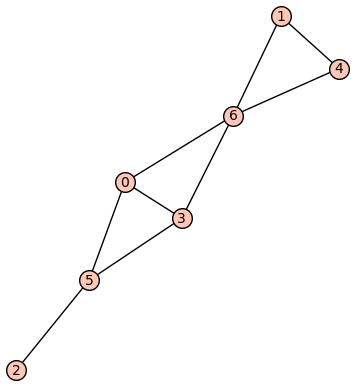

Graf  with wmdim_k = 5.0


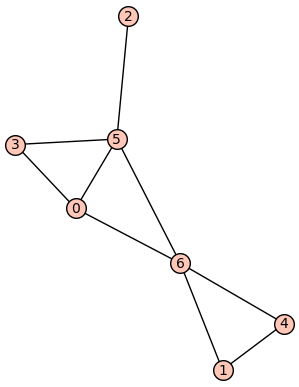

Graf  with wmdim_k = 5.0


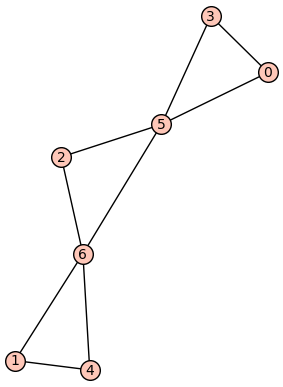

Graf  with wmdim_k = 5.0


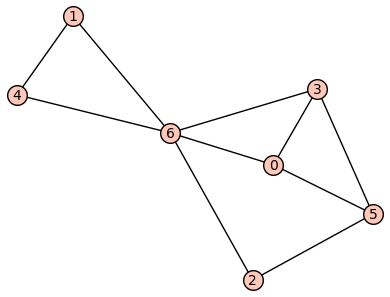

Graf  with wmdim_k = 5.0


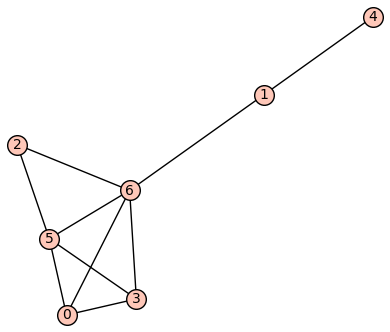

Graf  with wmdim_k = 5.0


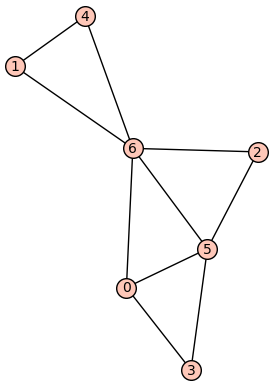

Graf  with wmdim_k = 5.0


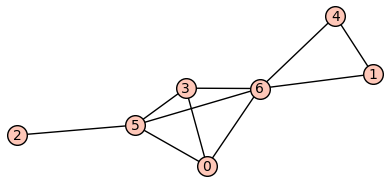

Graf  with wmdim_k = 5.0


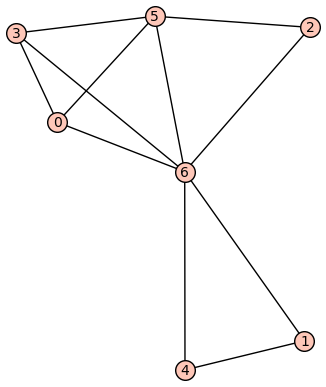

Graf  with wmdim_k = 6.0


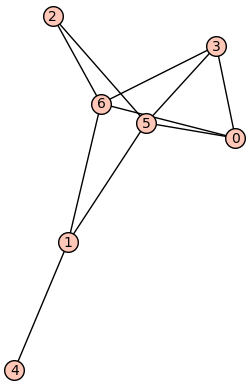

Graf  with wmdim_k = 5.0


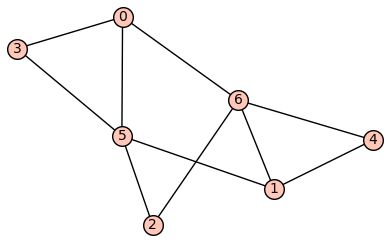

Graf  with wmdim_k = 5.0


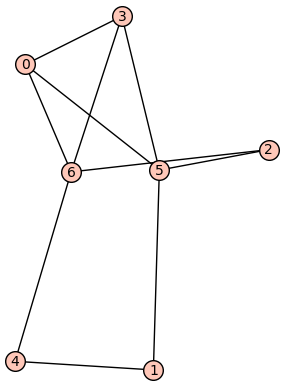

Graf  with wmdim_k = 5.0


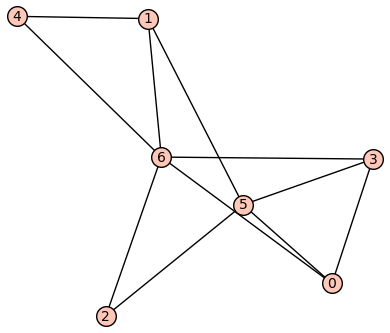

Graf  with wmdim_k = 5.0


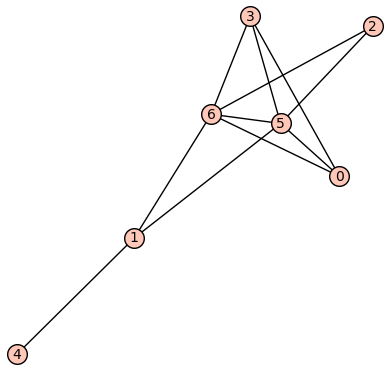

Graf  with wmdim_k = 6.0


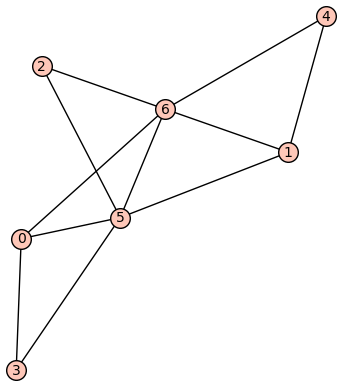

Graf  with wmdim_k = 5.0


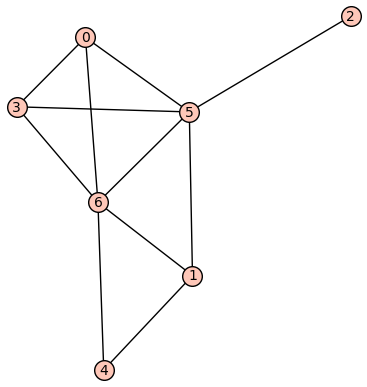

Graf  with wmdim_k = 5.0


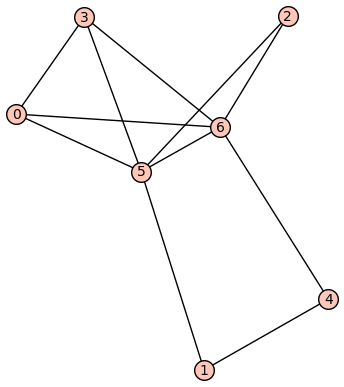

Graf  with wmdim_k = 5.0


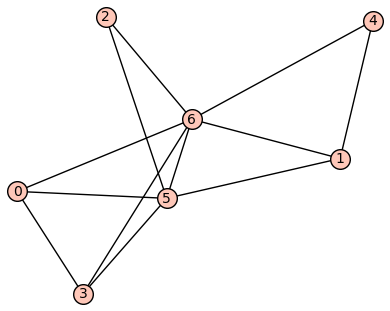

Graf  with wmdim_k = 6.0


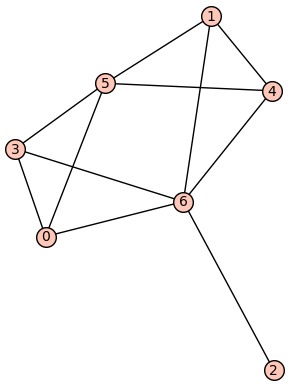

Graf  with wmdim_k = 5.0


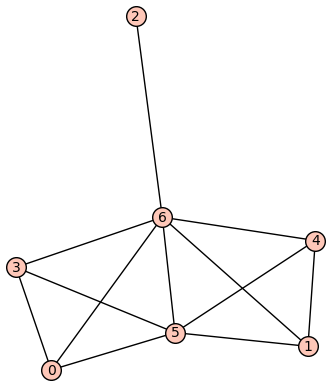

Graf  with wmdim_k = 6.0


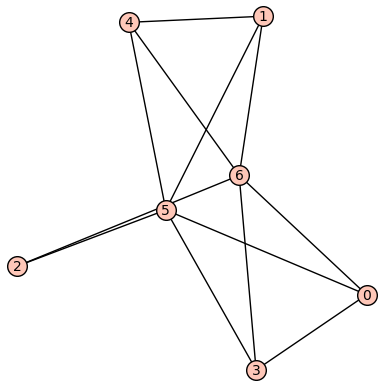

Graf  with wmdim_k = 6.0


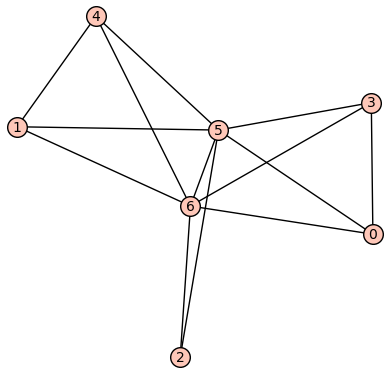

Graf  with wmdim_k = 7.0


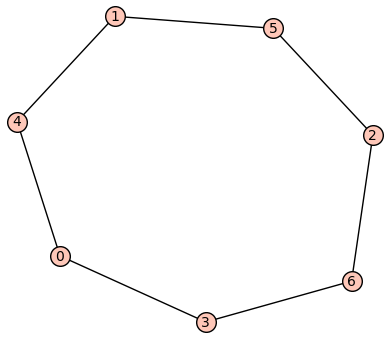

Graf  with wmdim_k = 5.0


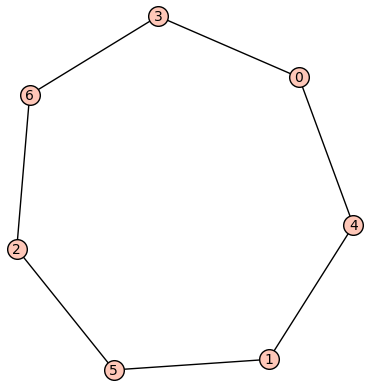

Graf  with wmdim_k = 7.0


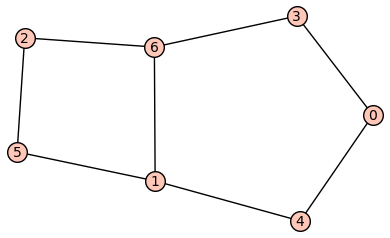

Graf  with wmdim_k = 5.0


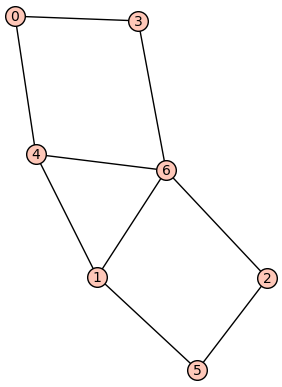

Graf  with wmdim_k = 6.0


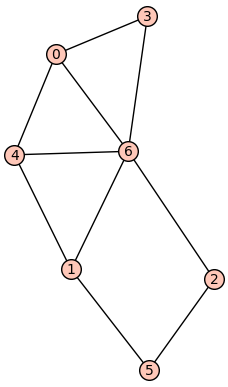

Graf  with wmdim_k = 5.0


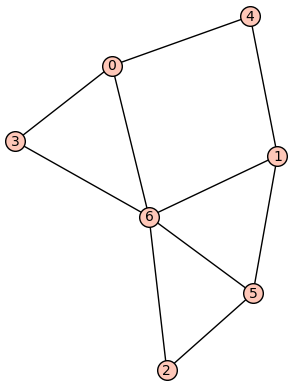

Graf  with wmdim_k = 5.0


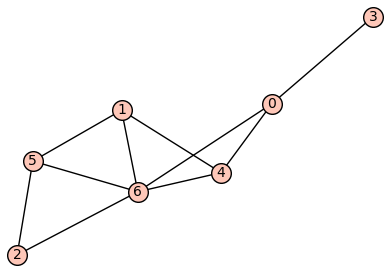

Graf  with wmdim_k = 5.0


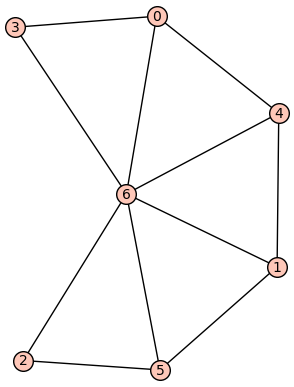

Graf  with wmdim_k = 6.0


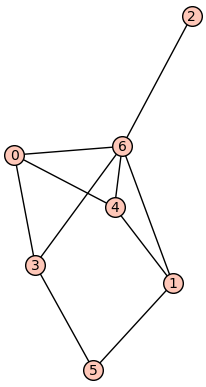

Graf  with wmdim_k = 5.0


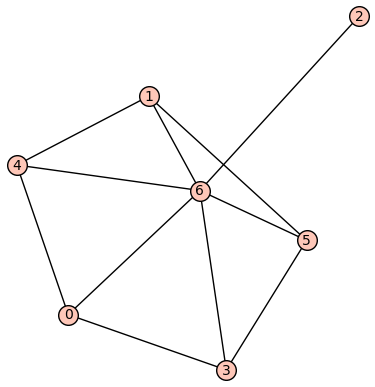

Graf  with wmdim_k = 6.0


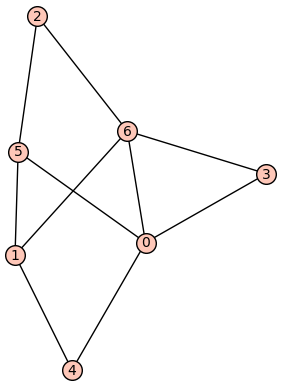

Graf  with wmdim_k = 5.0


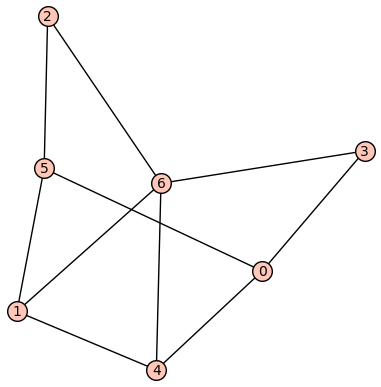

Graf  with wmdim_k = 7.0


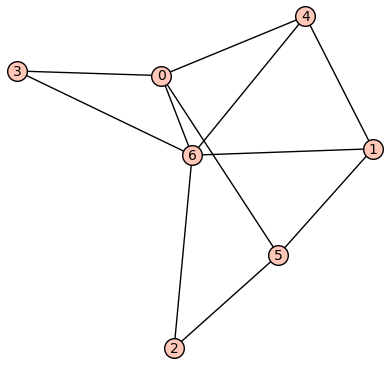

Graf  with wmdim_k = 5.0


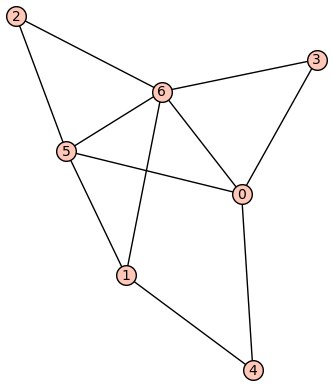

Graf  with wmdim_k = 5.0


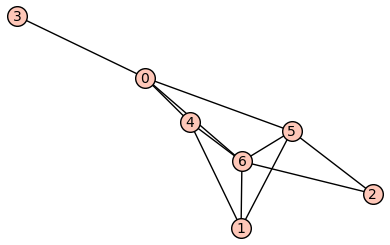

Graf  with wmdim_k = 5.0


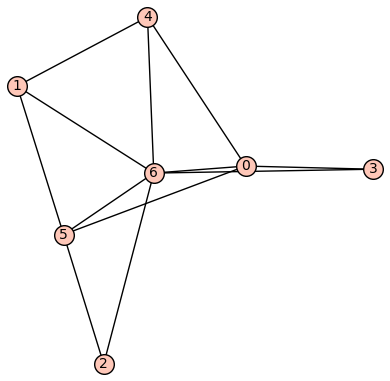

Graf  with wmdim_k = 6.0


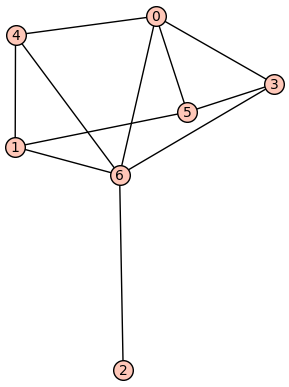

Graf  with wmdim_k = 5.0


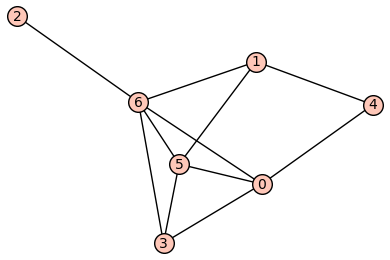

Graf  with wmdim_k = 5.0


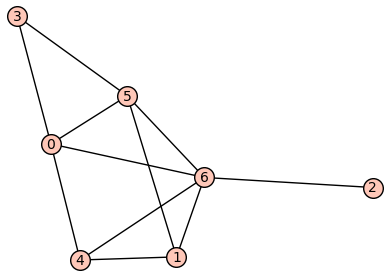

Graf  with wmdim_k = 5.0


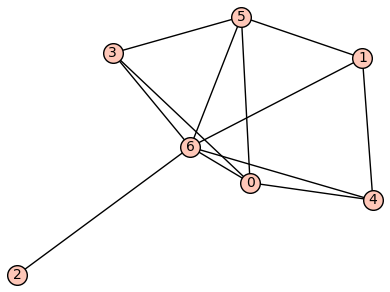

Graf  with wmdim_k = 6.0


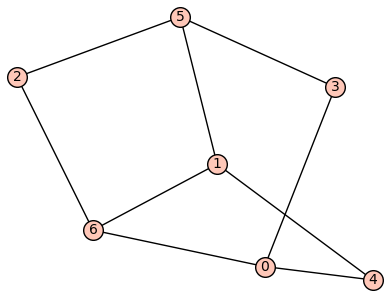

Graf  with wmdim_k = 7.0


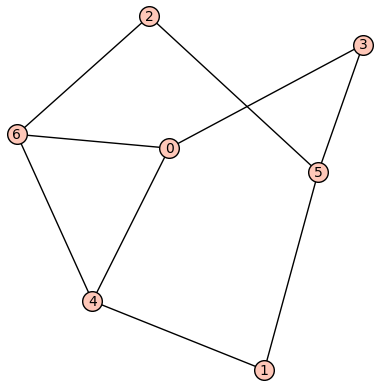

Graf  with wmdim_k = 7.0


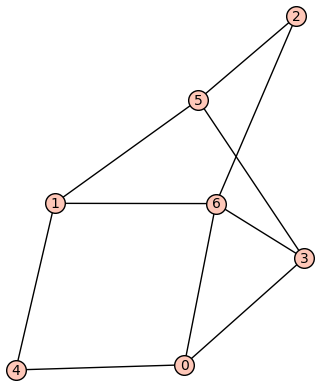

Graf  with wmdim_k = 7.0


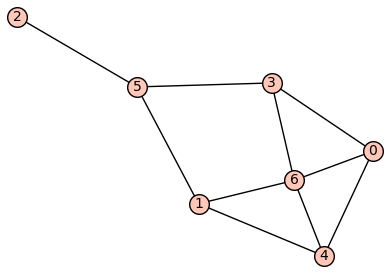

Graf  with wmdim_k = 5.0


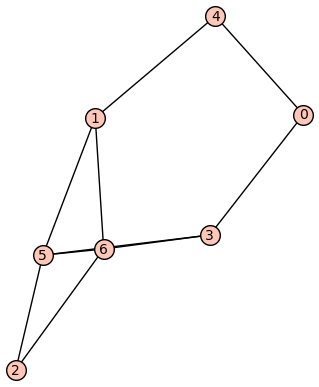

Graf  with wmdim_k = 5.0


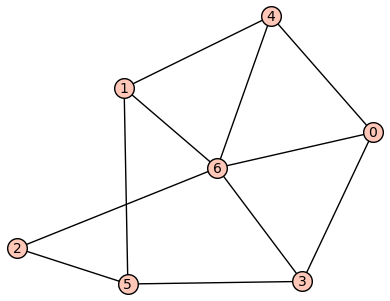

Graf  with wmdim_k = 5.0


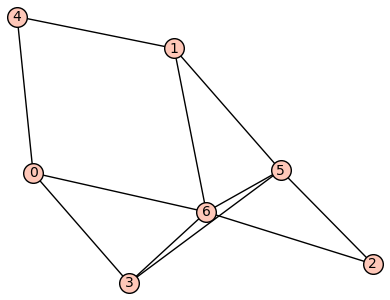

Graf  with wmdim_k = 5.0


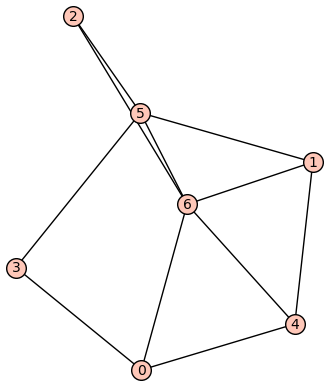

Graf  with wmdim_k = 5.0


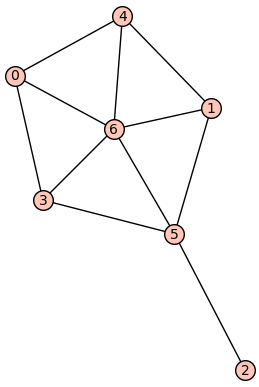

Graf  with wmdim_k = 5.0


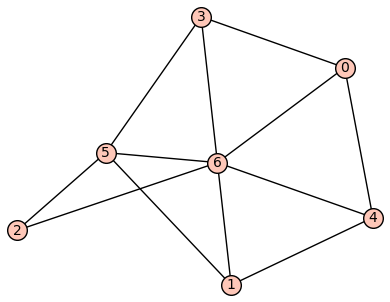

Graf  with wmdim_k = 6.0


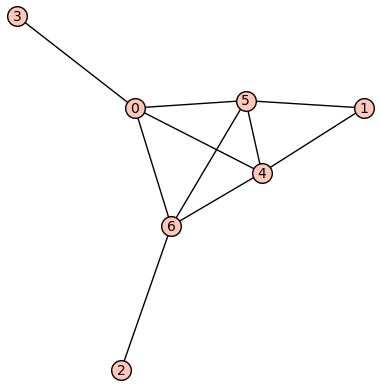

Graf  with wmdim_k = 5.0


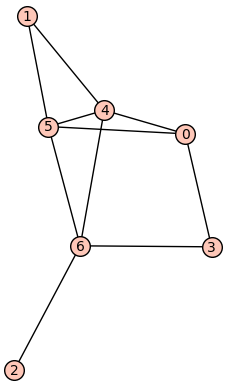

Graf  with wmdim_k = 5.0


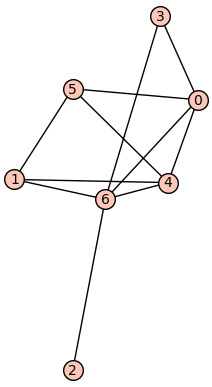

Graf  with wmdim_k = 5.0


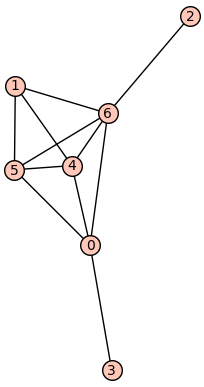

Graf  with wmdim_k = 5.0


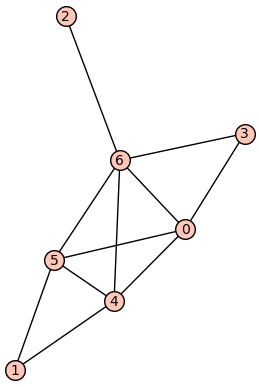

Graf  with wmdim_k = 6.0


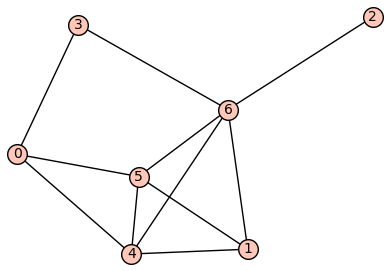

Graf  with wmdim_k = 5.0


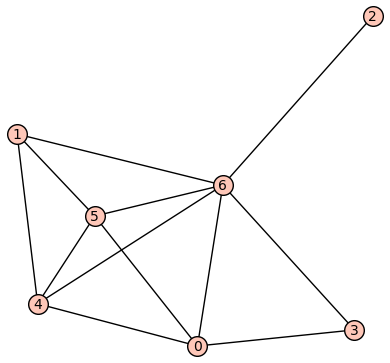

Graf  with wmdim_k = 6.0


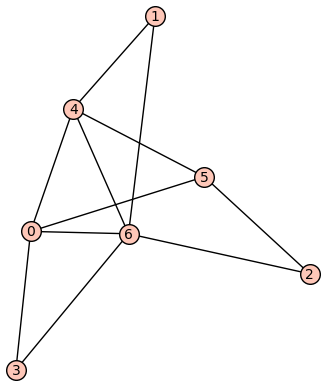

Graf  with wmdim_k = 5.0


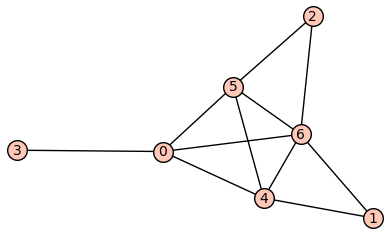

Graf  with wmdim_k = 5.0


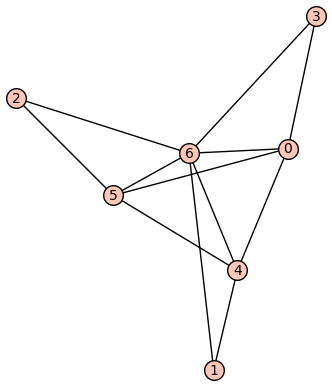

Graf  with wmdim_k = 6.0


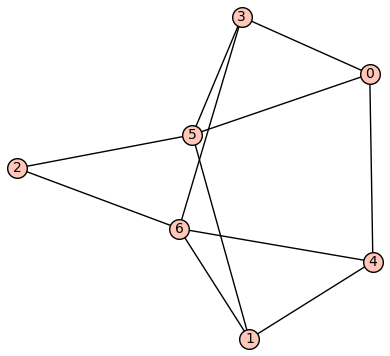

Graf  with wmdim_k = 5.0


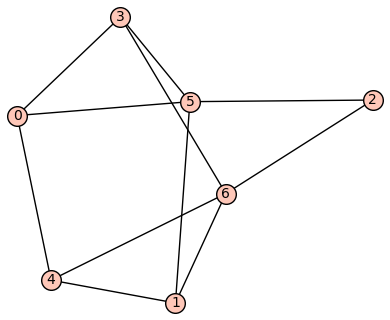

Graf  with wmdim_k = 7.0


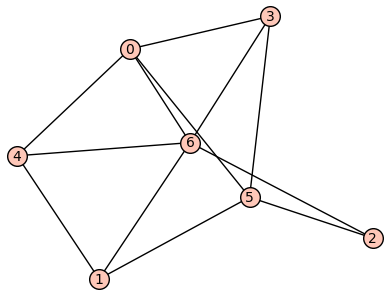

Graf  with wmdim_k = 5.0


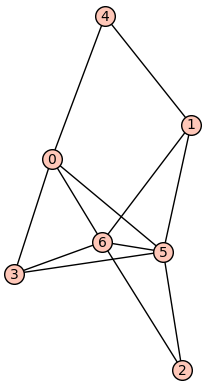

Graf  with wmdim_k = 6.0


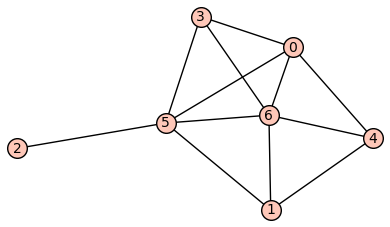

Graf  with wmdim_k = 5.0


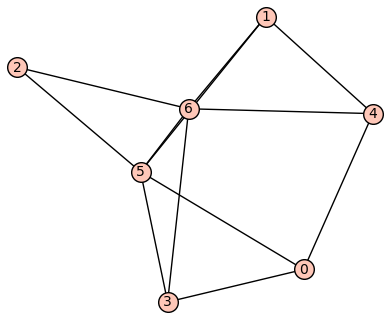

Graf  with wmdim_k = 5.0


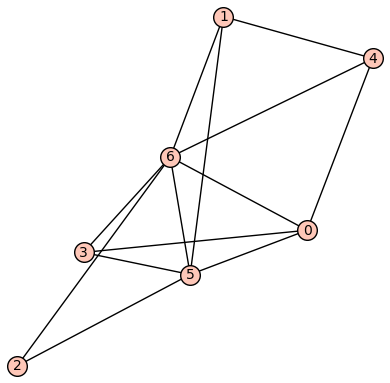

Graf  with wmdim_k = 6.0


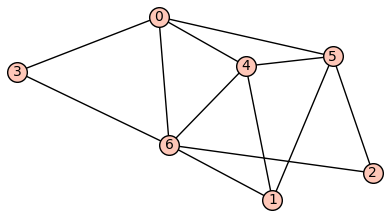

Graf  with wmdim_k = 5.0


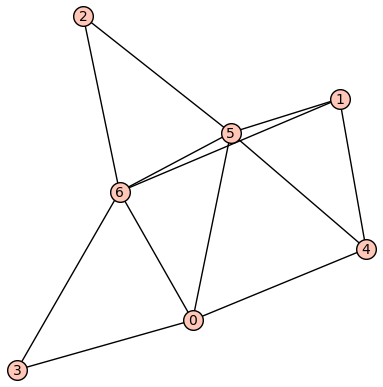

Graf  with wmdim_k = 6.0


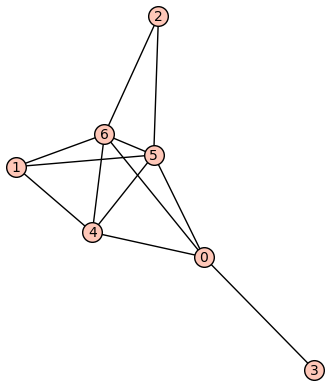

Graf  with wmdim_k = 6.0


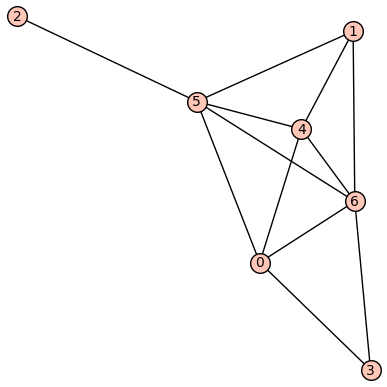

Graf  with wmdim_k = 5.0


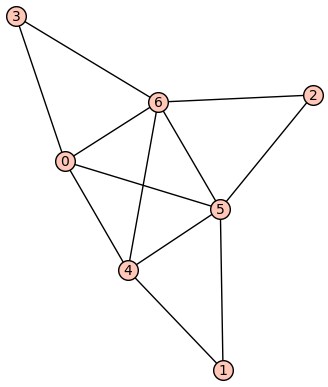

Graf  with wmdim_k = 5.0


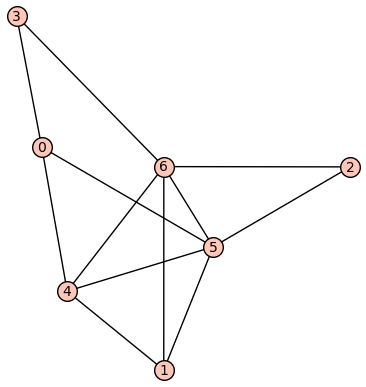

Graf  with wmdim_k = 5.0


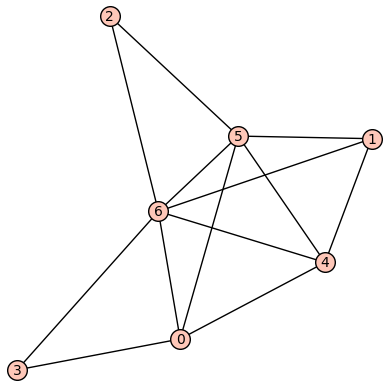

Graf  with wmdim_k = 6.0


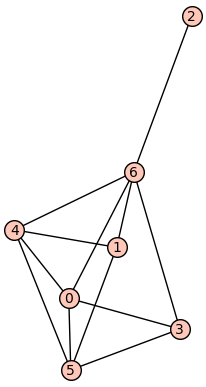

Graf  with wmdim_k = 5.0


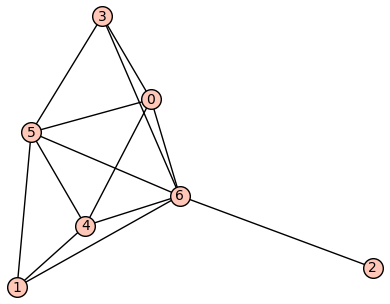

Graf  with wmdim_k = 6.0


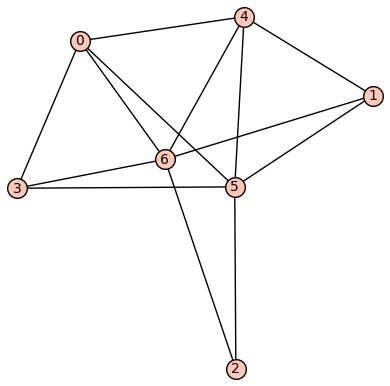

Graf  with wmdim_k = 6.0


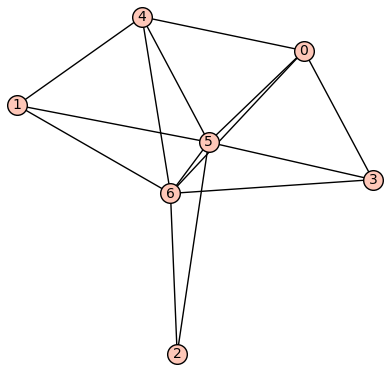

Graf  with wmdim_k = 7.0


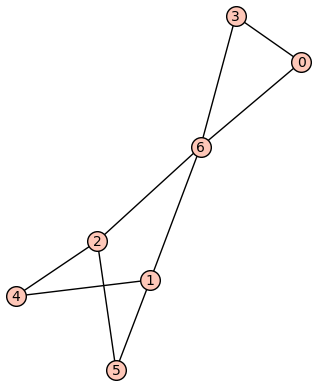

Graf  with wmdim_k = 5.0


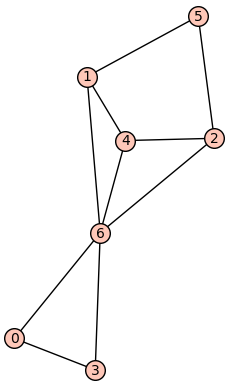

Graf  with wmdim_k = 5.0


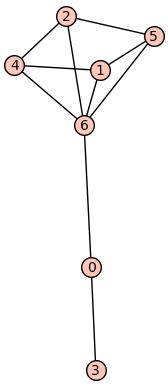

Graf  with wmdim_k = 5.0


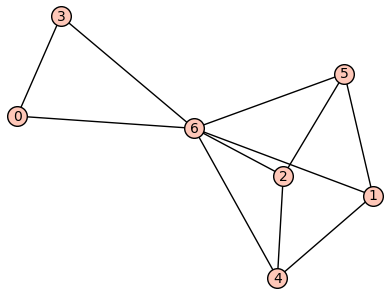

Graf  with wmdim_k = 6.0


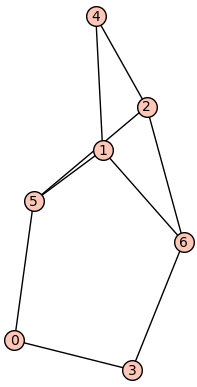

Graf  with wmdim_k = 7.0


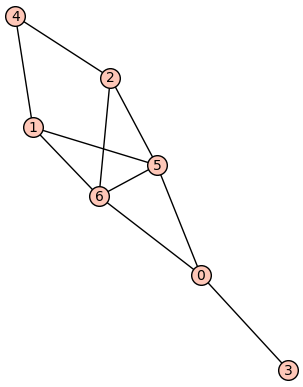

Graf  with wmdim_k = 5.0


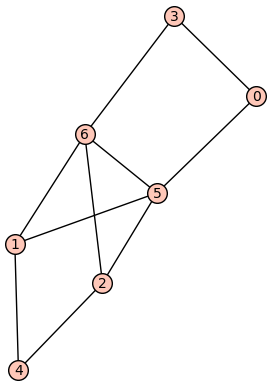

Graf  with wmdim_k = 7.0


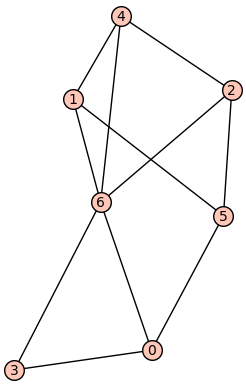

Graf  with wmdim_k = 5.0


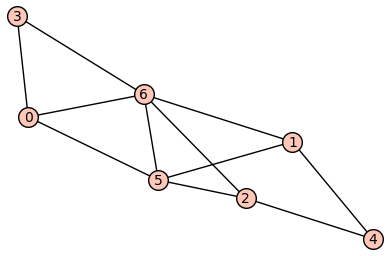

Graf  with wmdim_k = 5.0


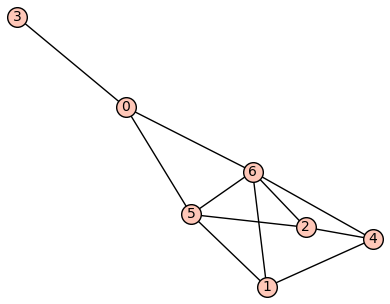

Graf  with wmdim_k = 5.0


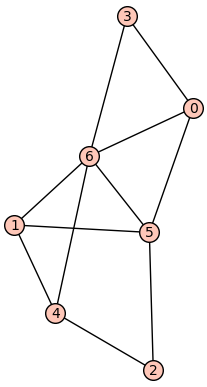

Graf  with wmdim_k = 5.0


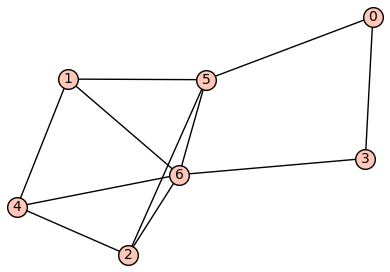

Graf  with wmdim_k = 5.0


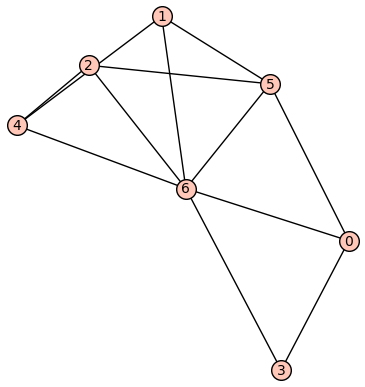

Graf  with wmdim_k = 6.0


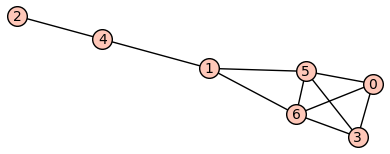

Graf  with wmdim_k = 5.0


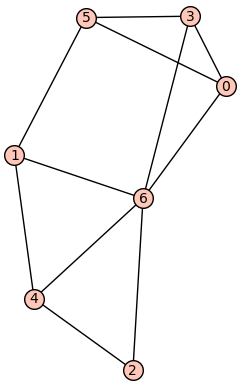

Graf  with wmdim_k = 5.0


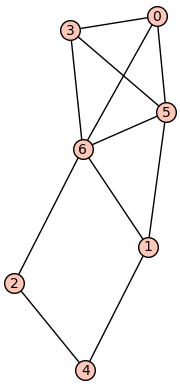

Graf  with wmdim_k = 5.0


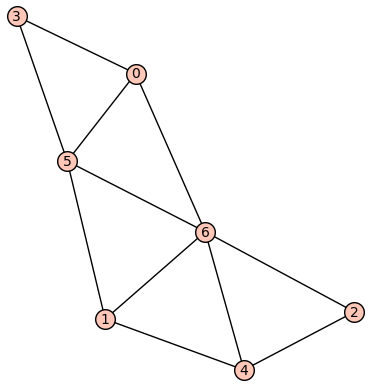

Graf  with wmdim_k = 5.0


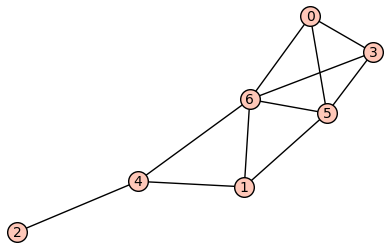

Graf  with wmdim_k = 5.0


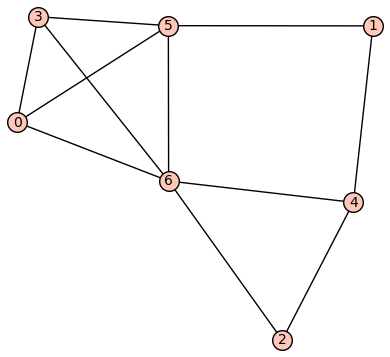

Graf  with wmdim_k = 5.0


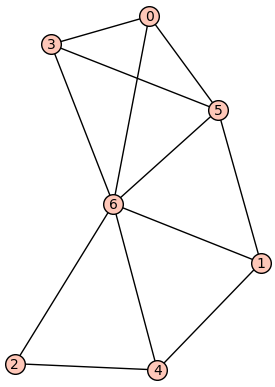

Graf  with wmdim_k = 6.0


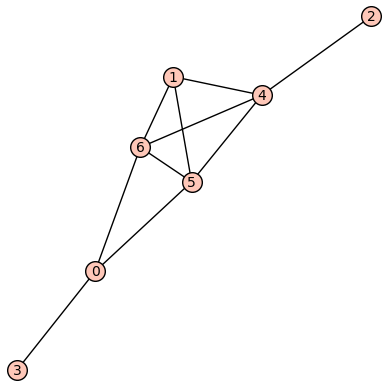

Graf  with wmdim_k = 5.0


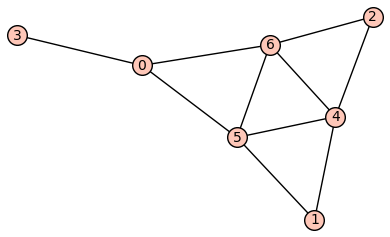

Graf  with wmdim_k = 5.0


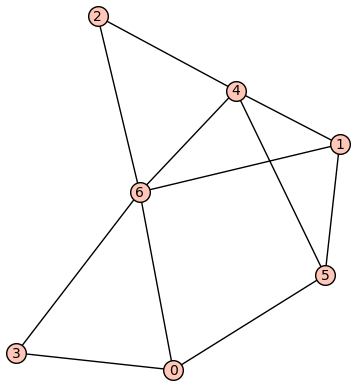

Graf  with wmdim_k = 5.0


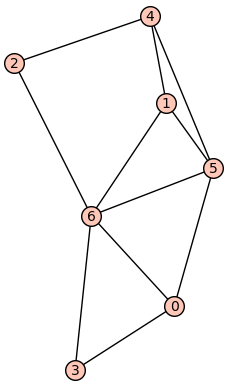

Graf  with wmdim_k = 5.0


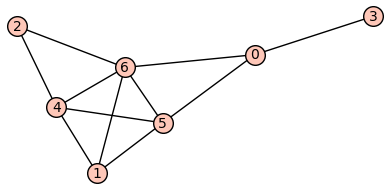

Graf  with wmdim_k = 5.0


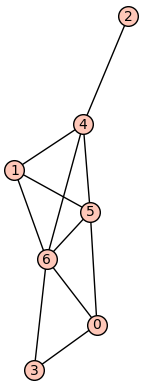

Graf  with wmdim_k = 5.0


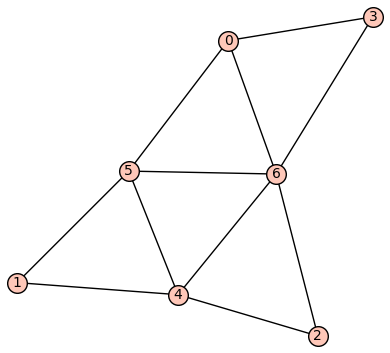

Graf  with wmdim_k = 5.0


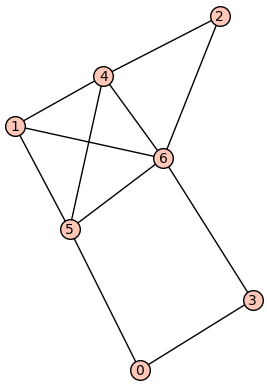

Graf  with wmdim_k = 5.0


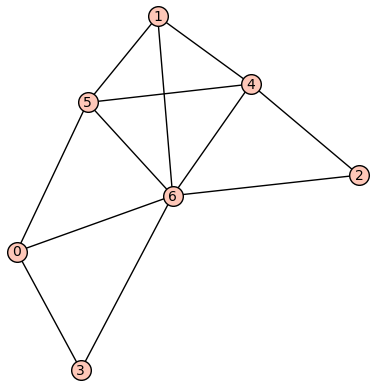

Graf  with wmdim_k = 6.0


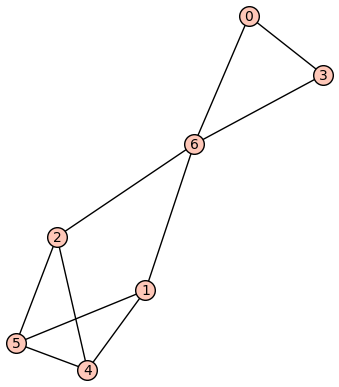

Graf  with wmdim_k = 5.0


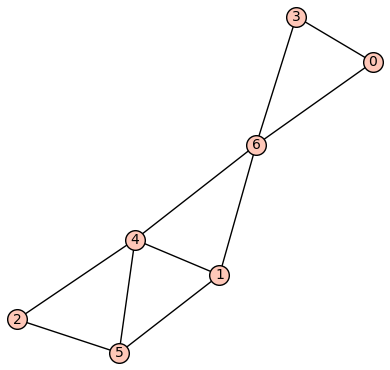

Graf  with wmdim_k = 5.0


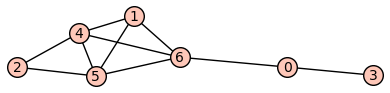

Graf  with wmdim_k = 5.0


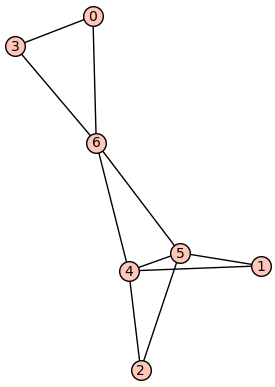

Graf  with wmdim_k = 6.0


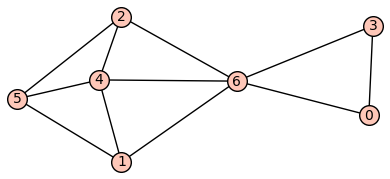

Graf  with wmdim_k = 5.0


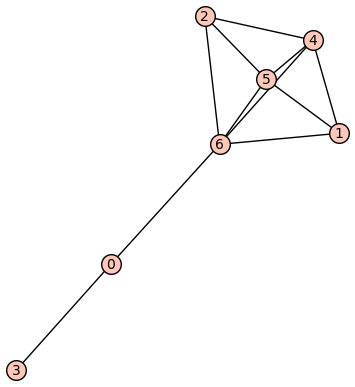

Graf  with wmdim_k = 5.0


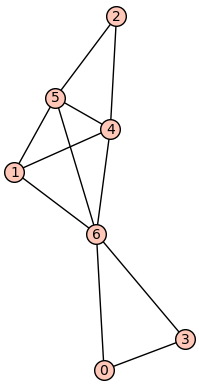

Graf  with wmdim_k = 6.0


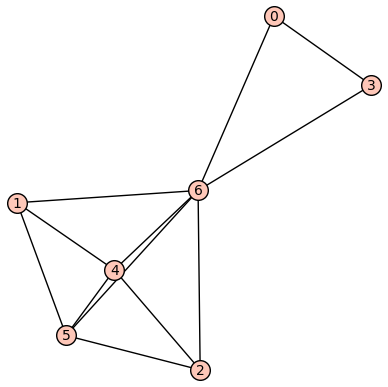

Graf  with wmdim_k = 6.0


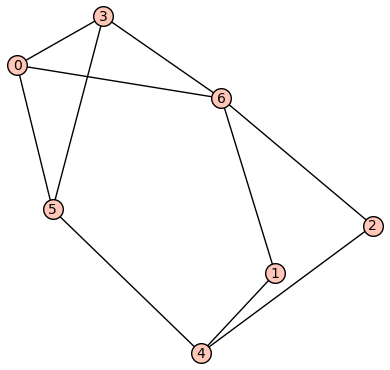

Graf  with wmdim_k = 5.0


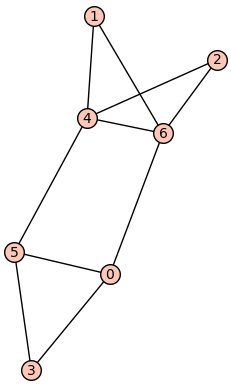

Graf  with wmdim_k = 5.0


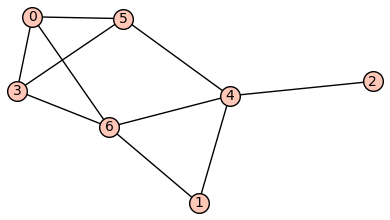

Graf  with wmdim_k = 5.0


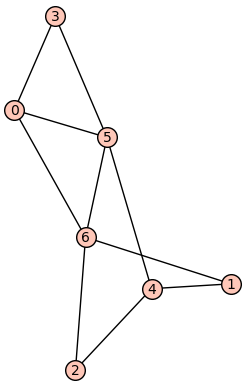

Graf  with wmdim_k = 5.0


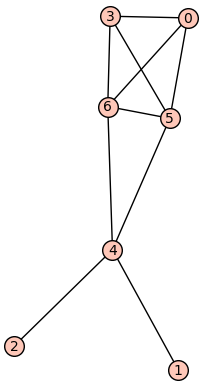

Graf  with wmdim_k = 6.0


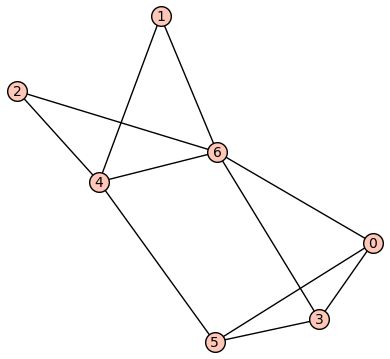

Graf  with wmdim_k = 5.0


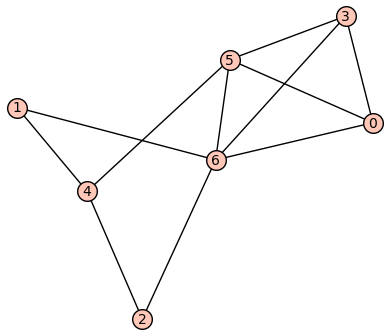

Graf  with wmdim_k = 5.0


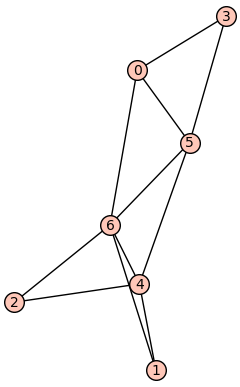

Graf  with wmdim_k = 5.0


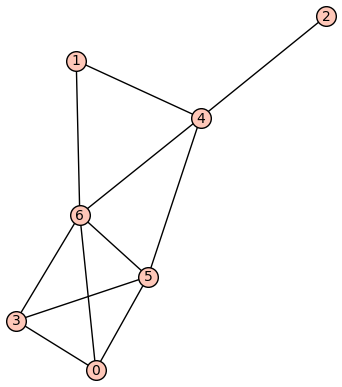

Graf  with wmdim_k = 5.0


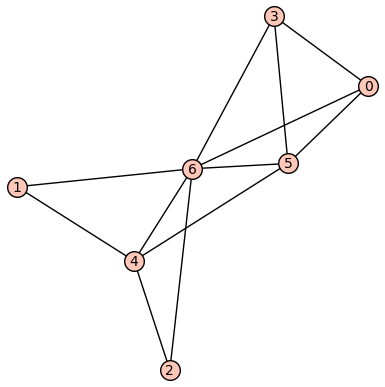

Graf  with wmdim_k = 6.0


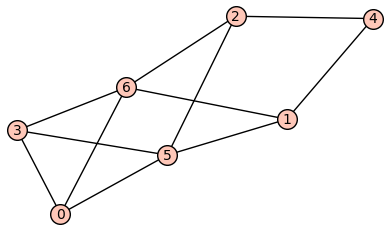

Graf  with wmdim_k = 5.0


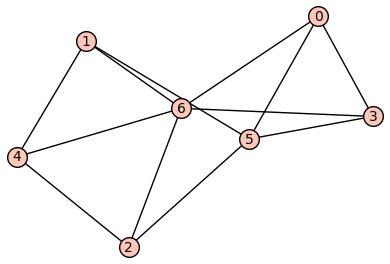

Graf  with wmdim_k = 5.0


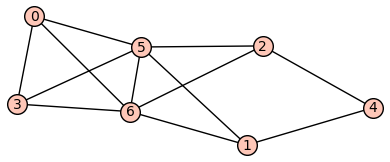

Graf  with wmdim_k = 6.0


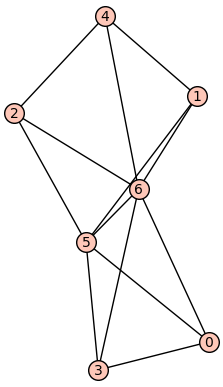

Graf  with wmdim_k = 6.0


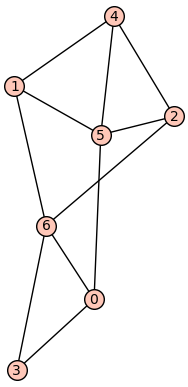

Graf  with wmdim_k = 5.0


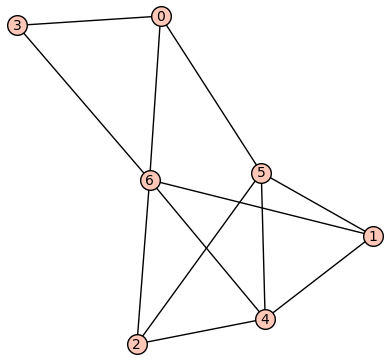

Graf  with wmdim_k = 5.0


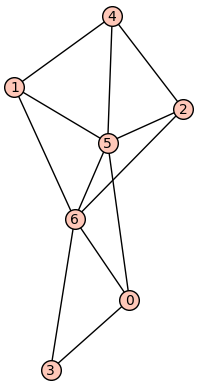

Graf  with wmdim_k = 5.0


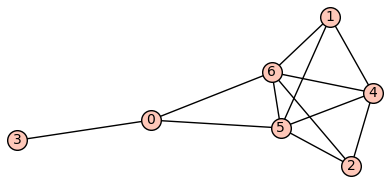

Graf  with wmdim_k = 6.0


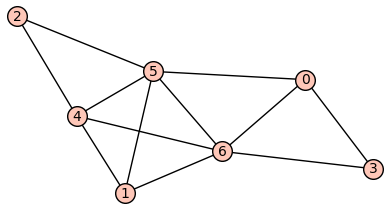

Graf  with wmdim_k = 5.0


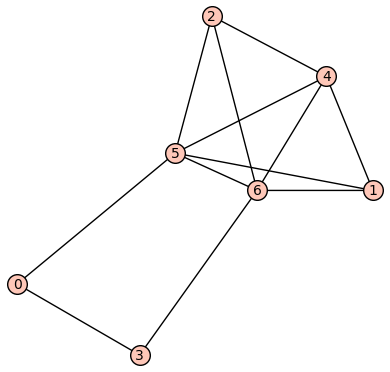

Graf  with wmdim_k = 5.0


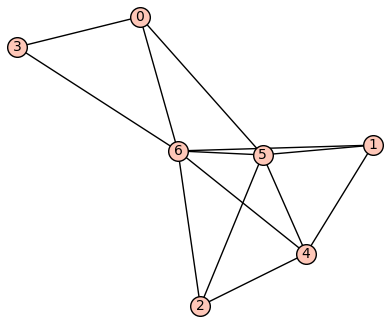

Graf  with wmdim_k = 6.0


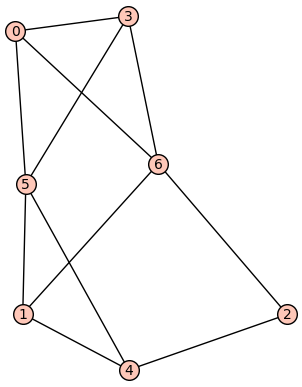

Graf  with wmdim_k = 5.0


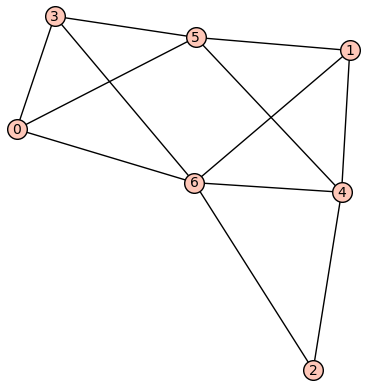

Graf  with wmdim_k = 5.0


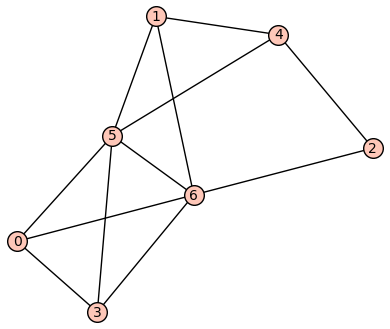

Graf  with wmdim_k = 5.0


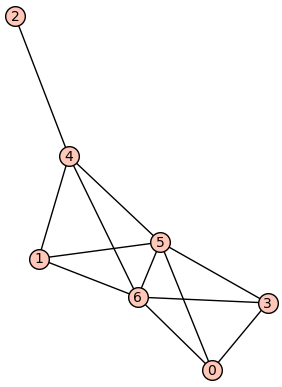

Graf  with wmdim_k = 6.0


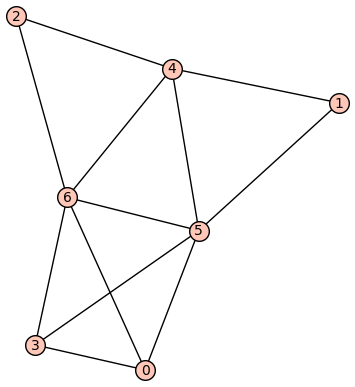

Graf  with wmdim_k = 6.0


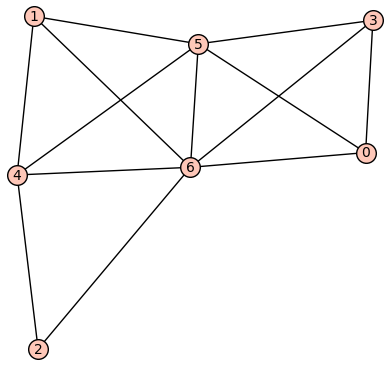

Graf  with wmdim_k = 6.0


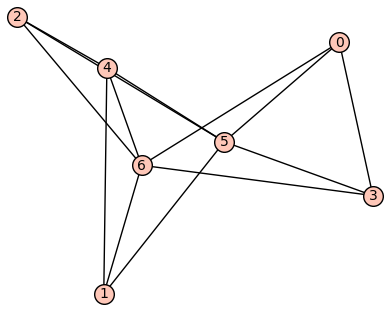

Graf  with wmdim_k = 6.0


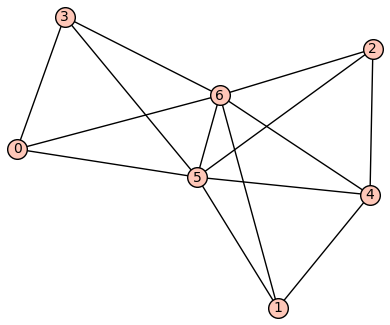

Graf  with wmdim_k = 7.0


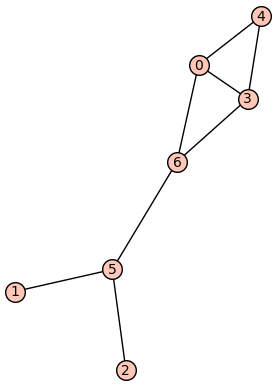

Graf  with wmdim_k = 5.0


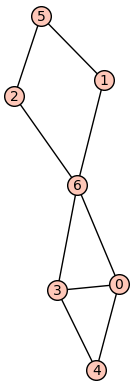

Graf  with wmdim_k = 5.0


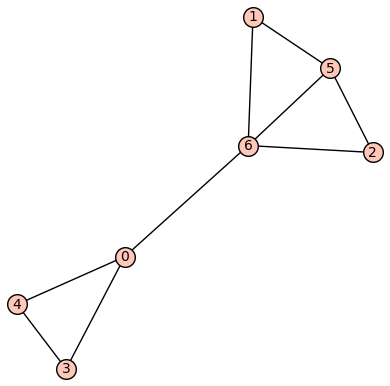

Graf  with wmdim_k = 5.0


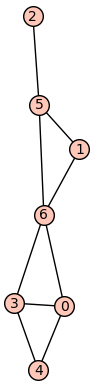

Graf  with wmdim_k = 5.0


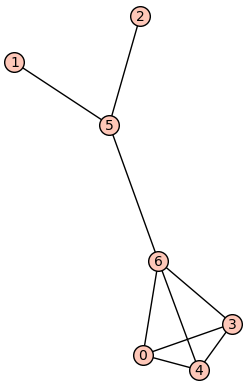

Graf  with wmdim_k = 5.0


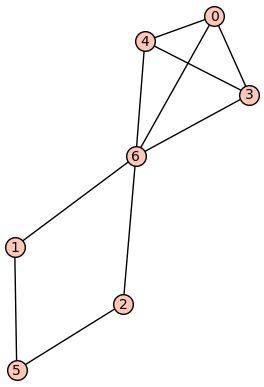

Graf  with wmdim_k = 5.0


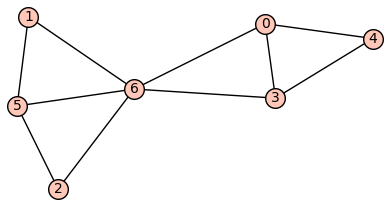

Graf  with wmdim_k = 6.0


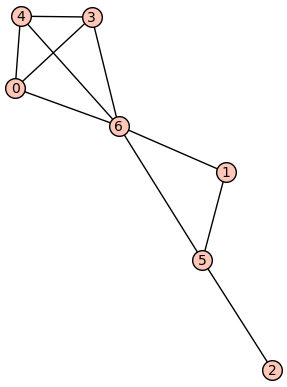

Graf  with wmdim_k = 5.0


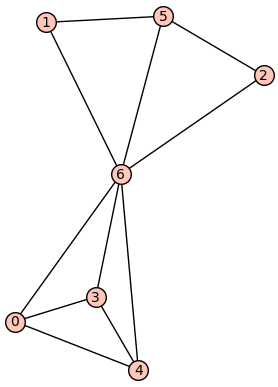

Graf  with wmdim_k = 6.0


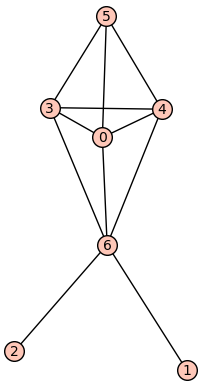

Graf  with wmdim_k = 6.0


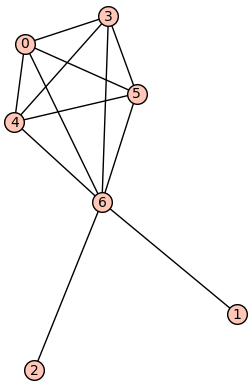

Graf  with wmdim_k = 6.0


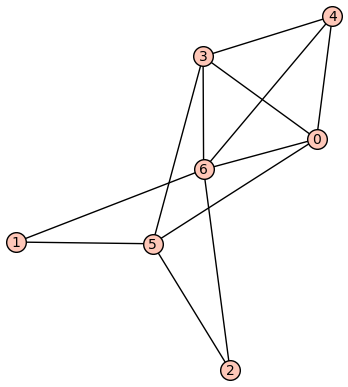

Graf  with wmdim_k = 6.0


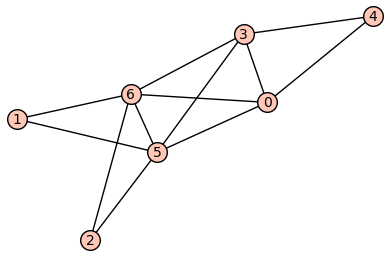

Graf  with wmdim_k = 7.0


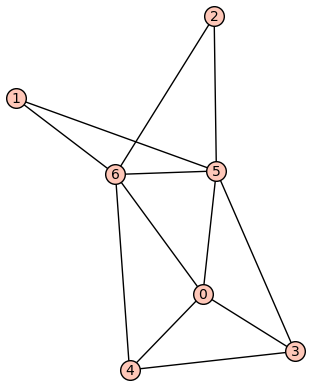

Graf  with wmdim_k = 6.0


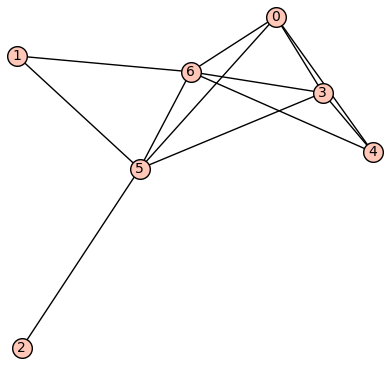

Graf  with wmdim_k = 5.0


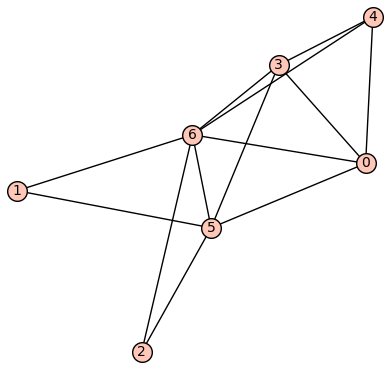

Graf  with wmdim_k = 6.0


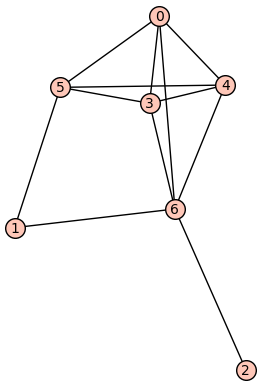

Graf  with wmdim_k = 5.0


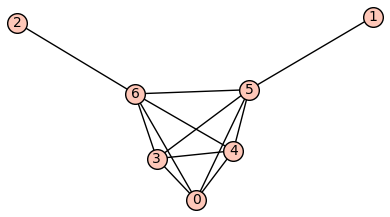

Graf  with wmdim_k = 5.0


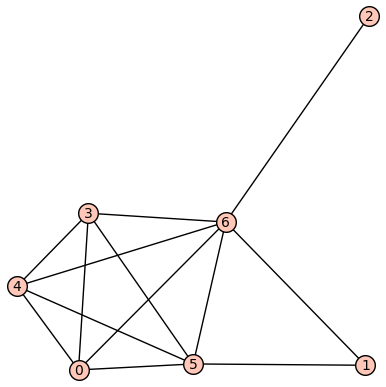

Graf  with wmdim_k = 6.0


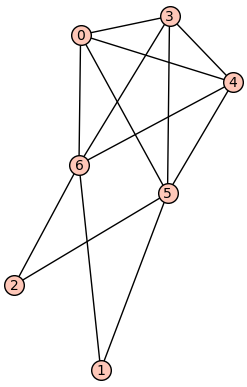

Graf  with wmdim_k = 6.0


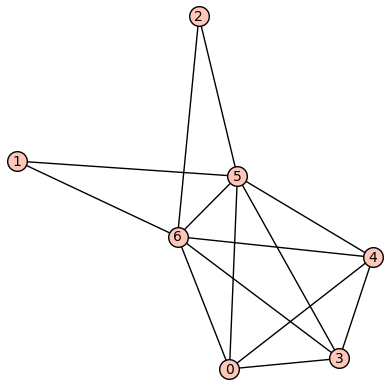

Graf  with wmdim_k = 7.0


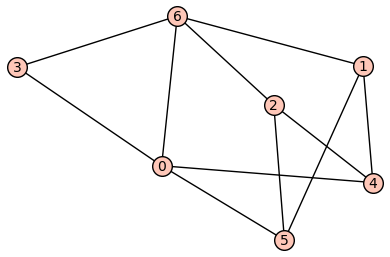

Graf  with wmdim_k = 5.0


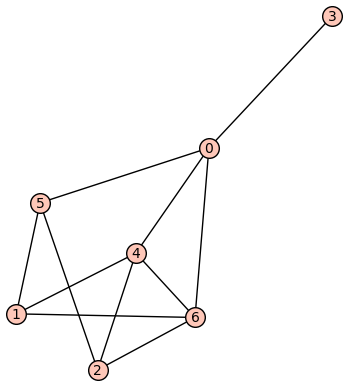

Graf  with wmdim_k = 5.0


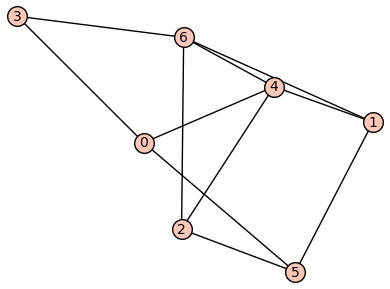

Graf  with wmdim_k = 7.0


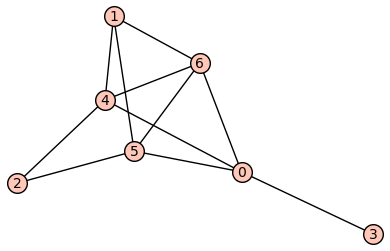

Graf  with wmdim_k = 5.0


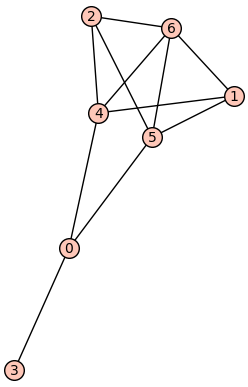

Graf  with wmdim_k = 5.0


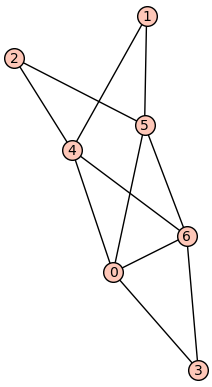

Graf  with wmdim_k = 6.0


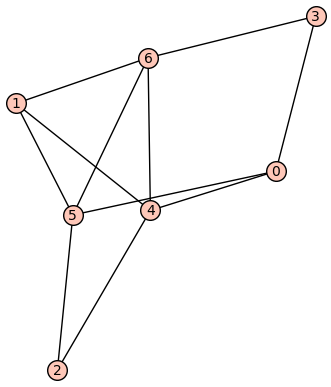

Graf  with wmdim_k = 5.0


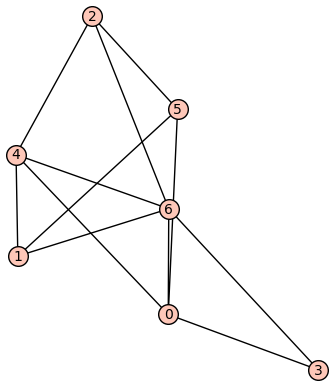

Graf  with wmdim_k = 5.0


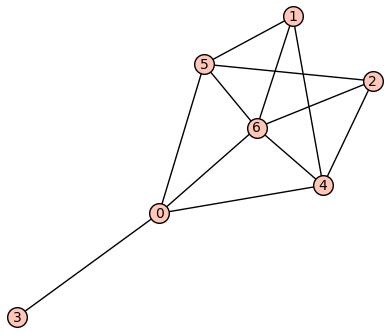

Graf  with wmdim_k = 5.0


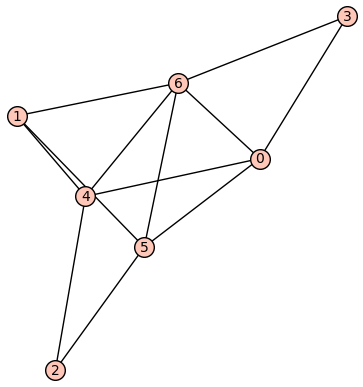

Graf  with wmdim_k = 5.0


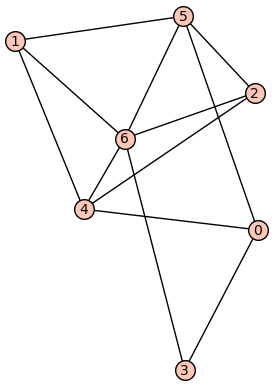

Graf  with wmdim_k = 5.0


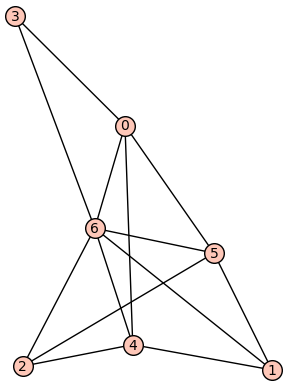

Graf  with wmdim_k = 6.0


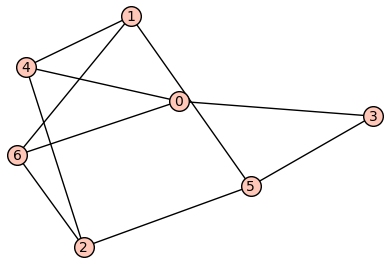

Graf  with wmdim_k = 7.0


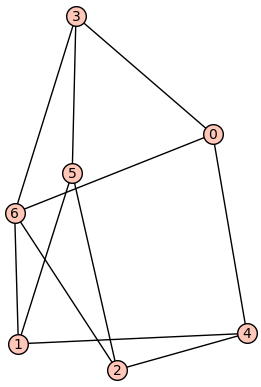

Graf  with wmdim_k = 7.0


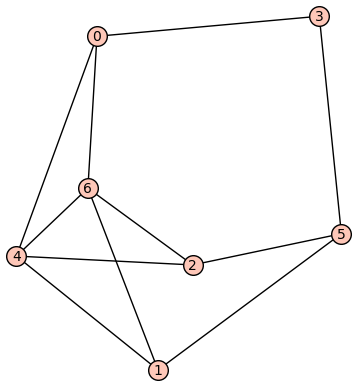

Graf  with wmdim_k = 5.0


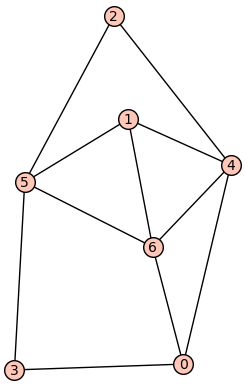

Graf  with wmdim_k = 5.0


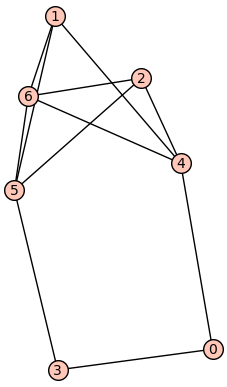

Graf  with wmdim_k = 5.0


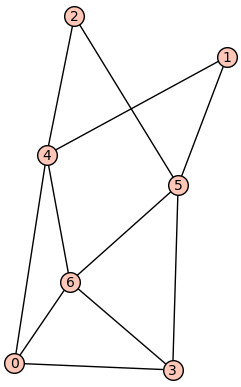

Graf  with wmdim_k = 5.0


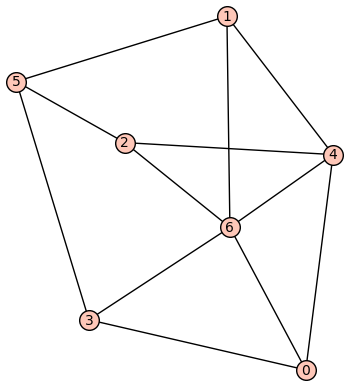

Graf  with wmdim_k = 5.0


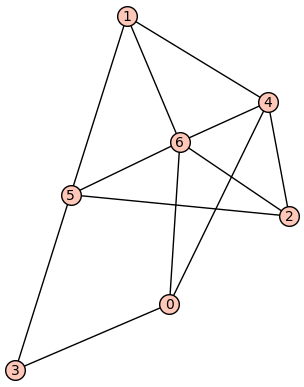

Graf  with wmdim_k = 5.0


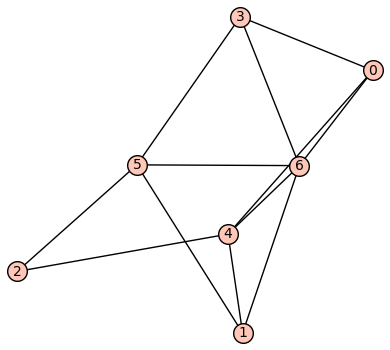

Graf  with wmdim_k = 5.0


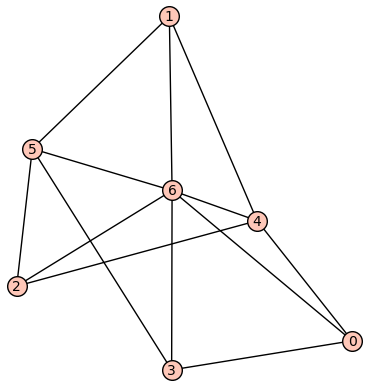

Graf  with wmdim_k = 6.0


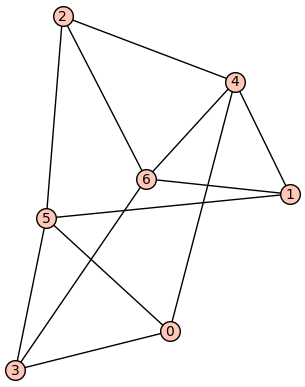

Graf  with wmdim_k = 5.0


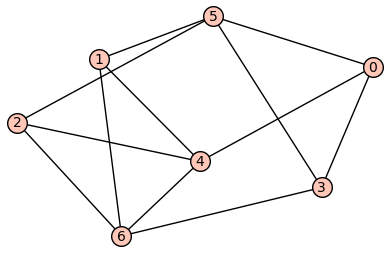

Graf  with wmdim_k = 7.0


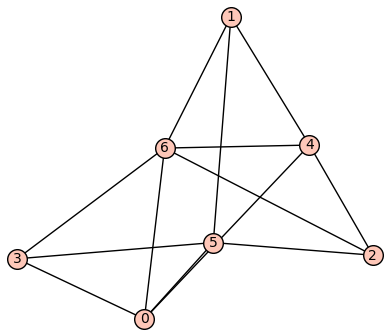

Graf  with wmdim_k = 5.0


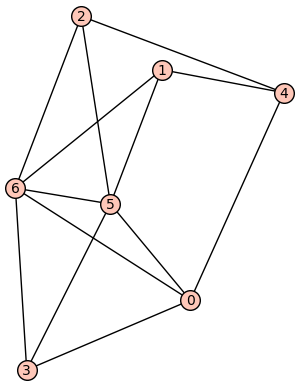

Graf  with wmdim_k = 6.0


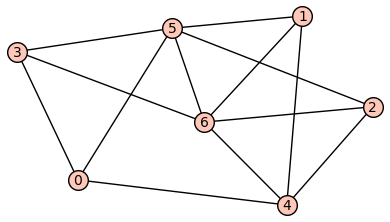

Graf  with wmdim_k = 5.0


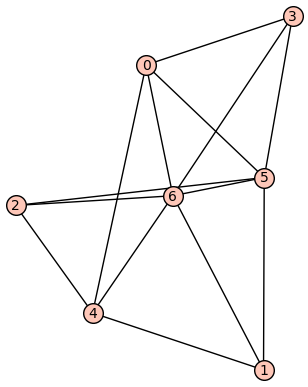

Graf  with wmdim_k = 6.0


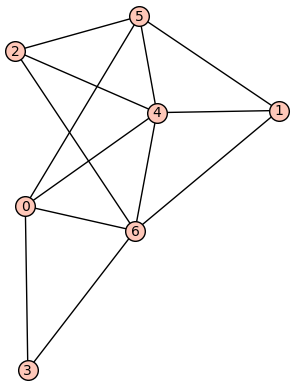

Graf  with wmdim_k = 6.0


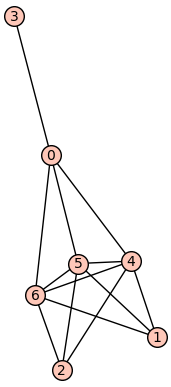

Graf  with wmdim_k = 6.0


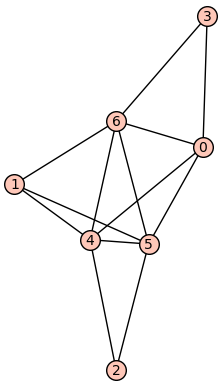

Graf  with wmdim_k = 6.0


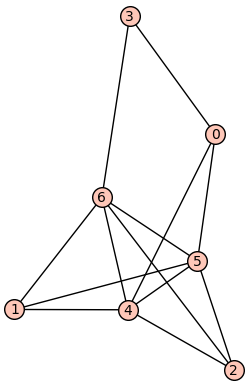

Graf  with wmdim_k = 6.0


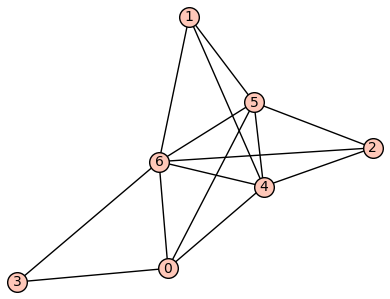

Graf  with wmdim_k = 6.0


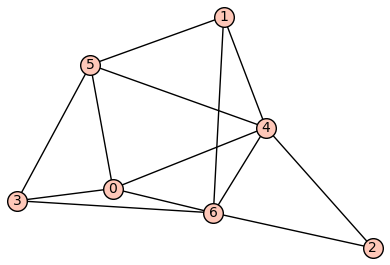

Graf  with wmdim_k = 6.0


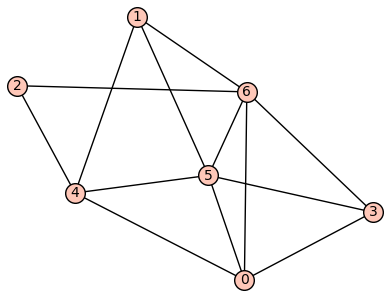

Graf  with wmdim_k = 5.0


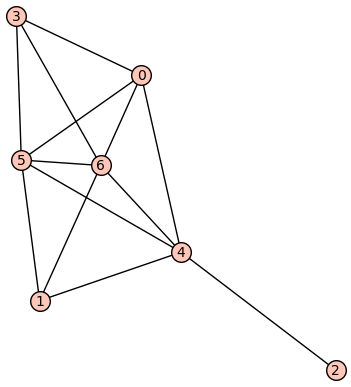

Graf  with wmdim_k = 6.0


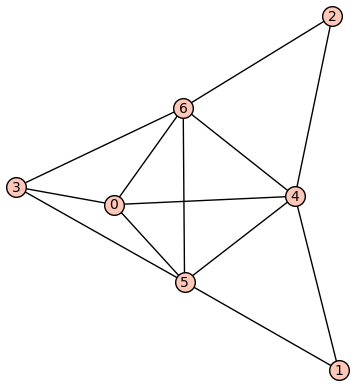

Graf  with wmdim_k = 6.0


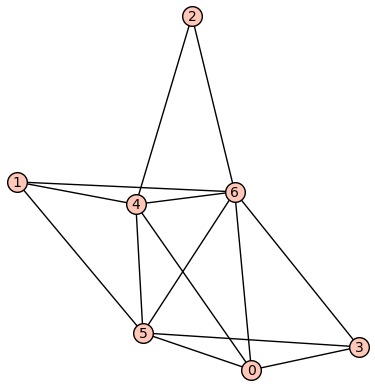

Graf  with wmdim_k = 6.0


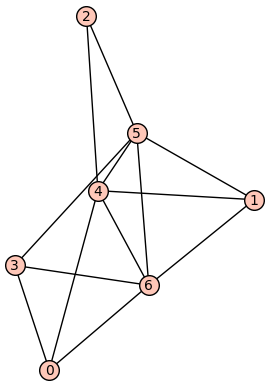

Graf  with wmdim_k = 6.0


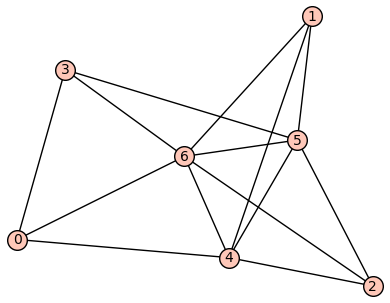

Graf  with wmdim_k = 6.0


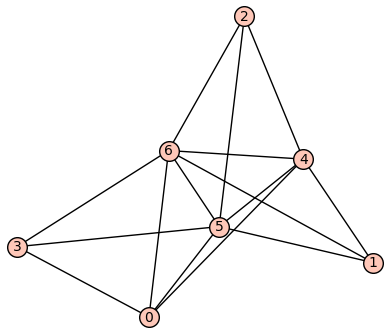

Graf  with wmdim_k = 7.0


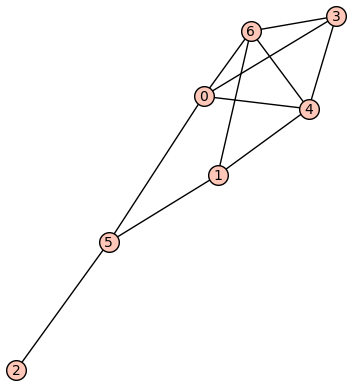

Graf  with wmdim_k = 5.0


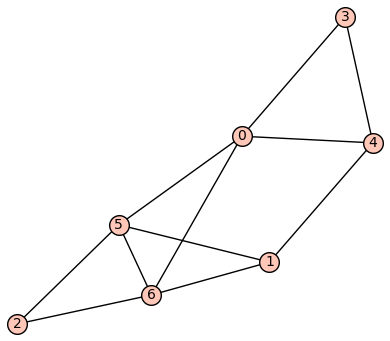

Graf  with wmdim_k = 5.0


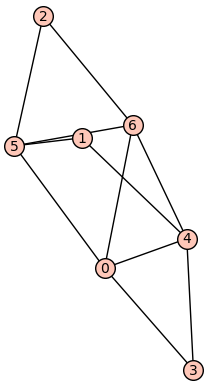

Graf  with wmdim_k = 5.0


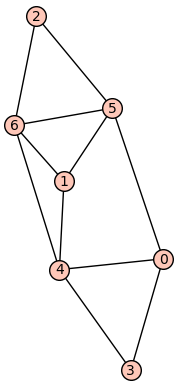

Graf  with wmdim_k = 5.0


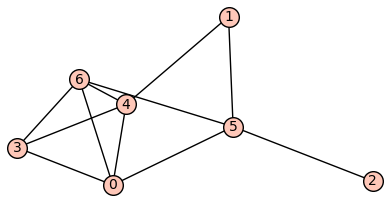

Graf  with wmdim_k = 5.0


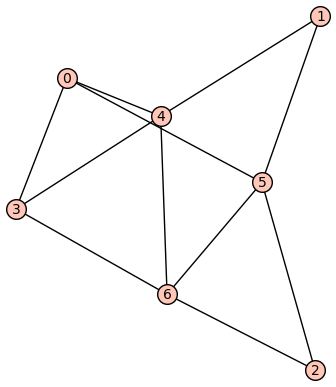

Graf  with wmdim_k = 5.0


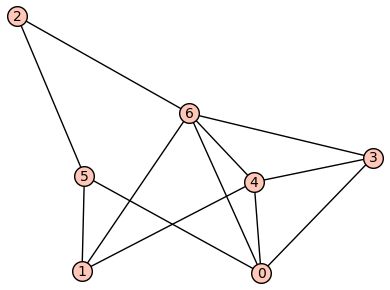

Graf  with wmdim_k = 5.0


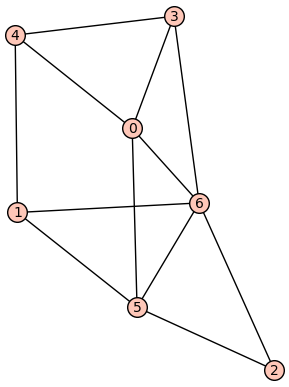

Graf  with wmdim_k = 5.0


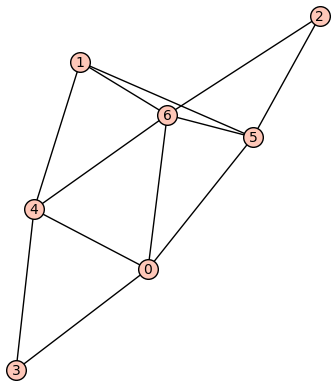

Graf  with wmdim_k = 5.0


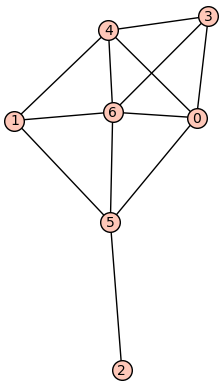

Graf  with wmdim_k = 5.0


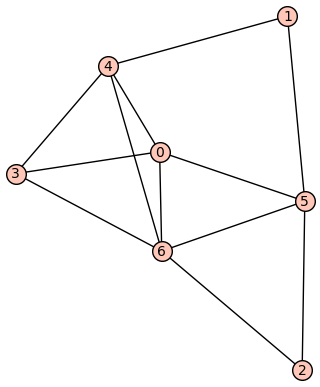

Graf  with wmdim_k = 5.0


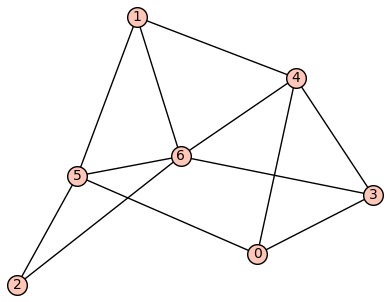

Graf  with wmdim_k = 5.0


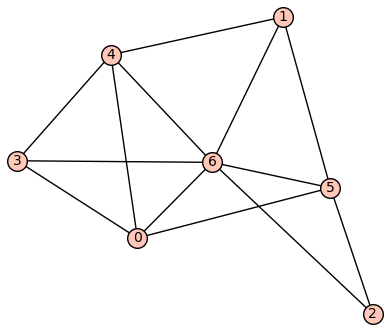

Graf  with wmdim_k = 6.0


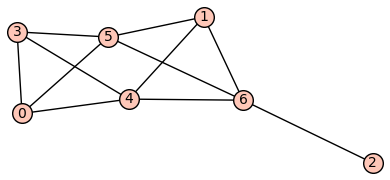

Graf  with wmdim_k = 5.0


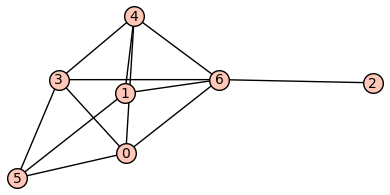

Graf  with wmdim_k = 5.0


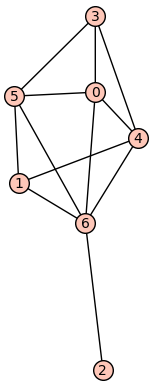

Graf  with wmdim_k = 5.0


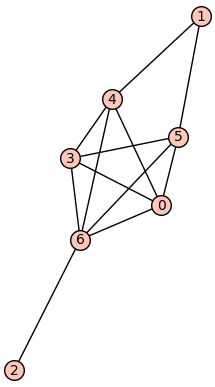

Graf  with wmdim_k = 5.0


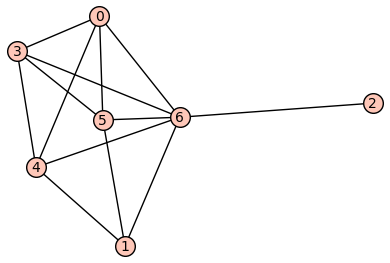

Graf  with wmdim_k = 6.0


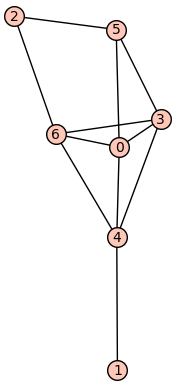

Graf  with wmdim_k = 5.0


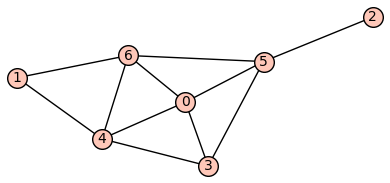

Graf  with wmdim_k = 5.0


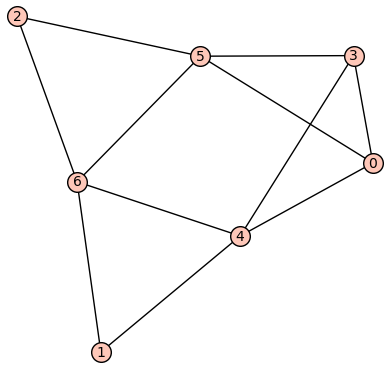

Graf  with wmdim_k = 5.0


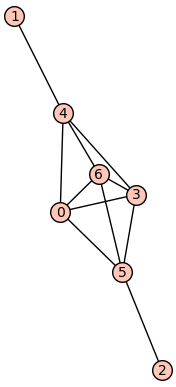

Graf  with wmdim_k = 5.0


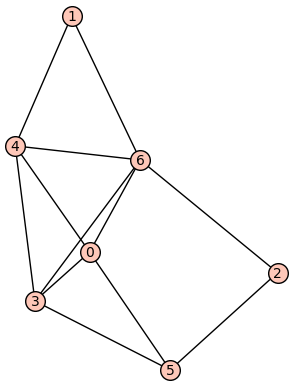

Graf  with wmdim_k = 5.0


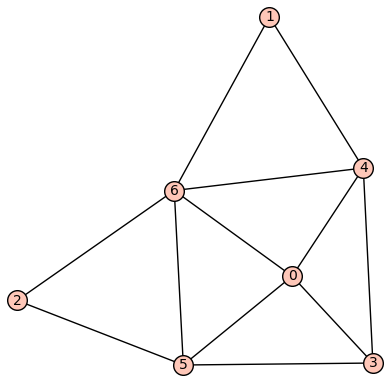

Graf  with wmdim_k = 5.0


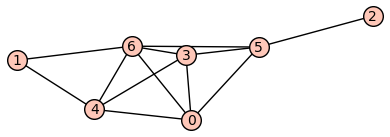

Graf  with wmdim_k = 5.0


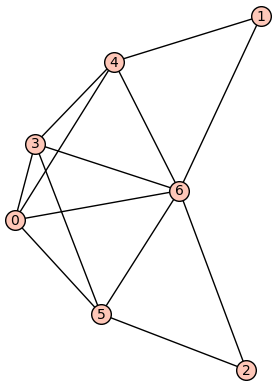

Graf  with wmdim_k = 6.0


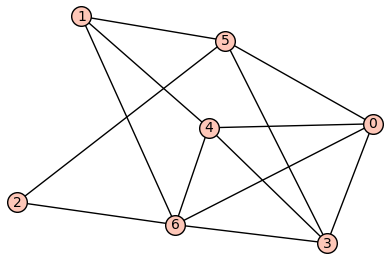

Graf  with wmdim_k = 5.0


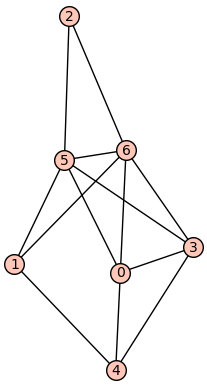

Graf  with wmdim_k = 6.0


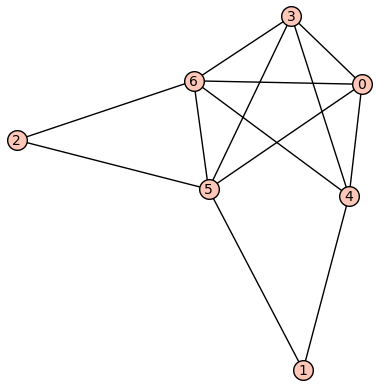

Graf  with wmdim_k = 5.0


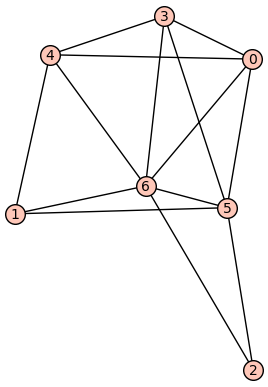

Graf  with wmdim_k = 6.0


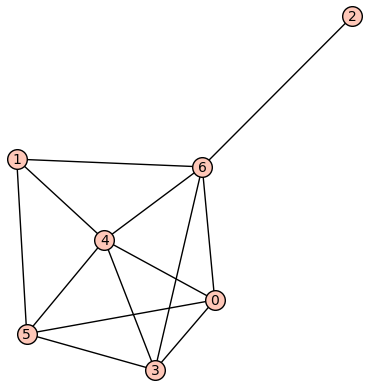

Graf  with wmdim_k = 5.0


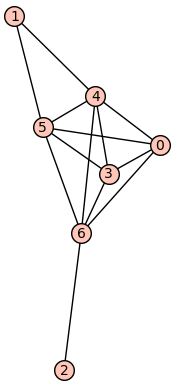

Graf  with wmdim_k = 6.0


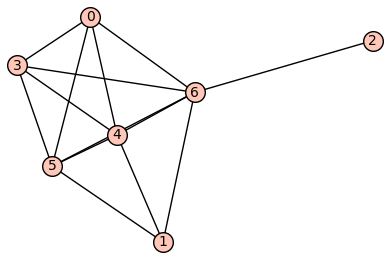

Graf  with wmdim_k = 6.0


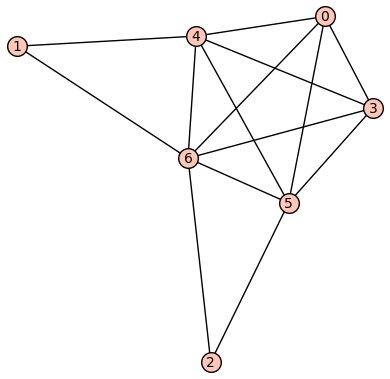

Graf  with wmdim_k = 6.0


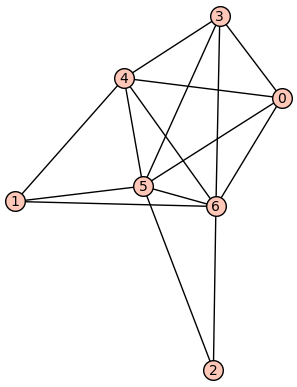

Graf  with wmdim_k = 7.0


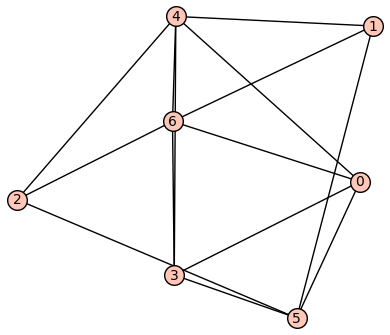

Graf  with wmdim_k = 6.0


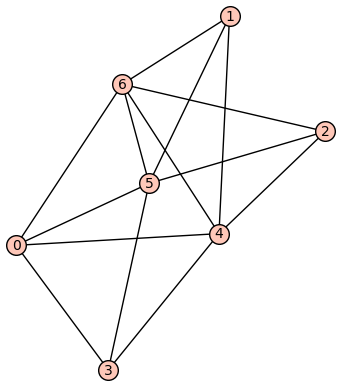

Graf  with wmdim_k = 6.0


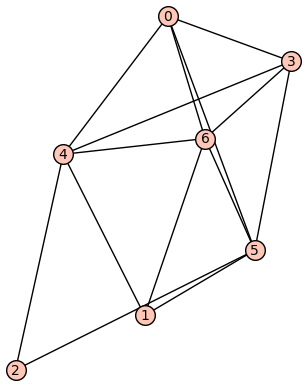

Graf  with wmdim_k = 6.0


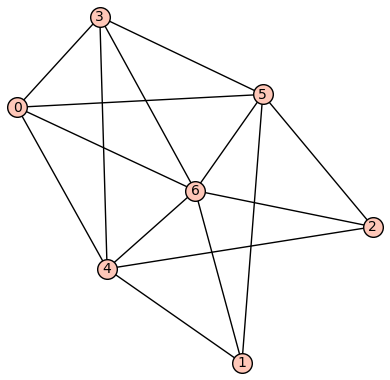

Graf  with wmdim_k = 6.0


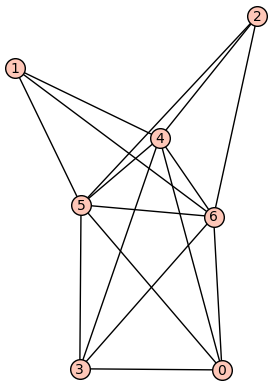

Graf  with wmdim_k = 7.0


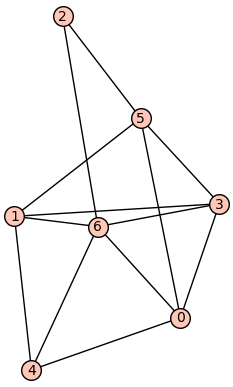

Graf  with wmdim_k = 5.0


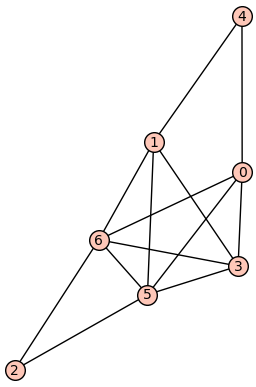

Graf  with wmdim_k = 6.0


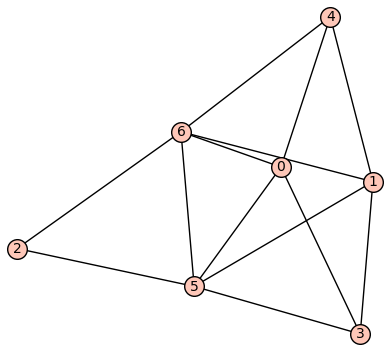

Graf  with wmdim_k = 6.0


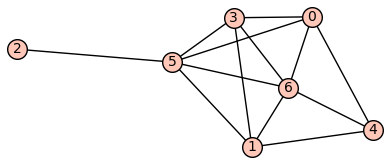

Graf  with wmdim_k = 5.0


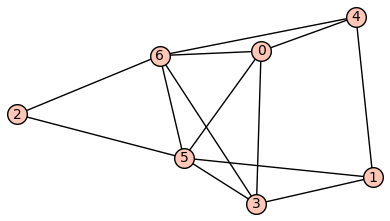

Graf  with wmdim_k = 5.0


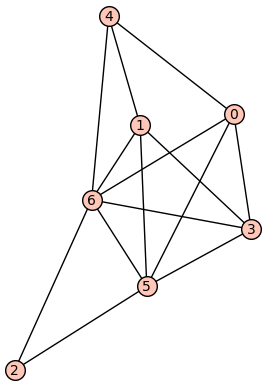

Graf  with wmdim_k = 6.0


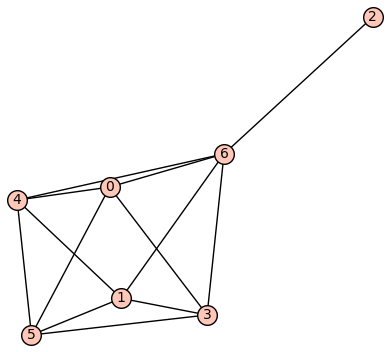

Graf  with wmdim_k = 5.0


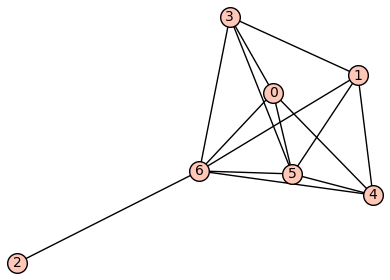

Graf  with wmdim_k = 6.0


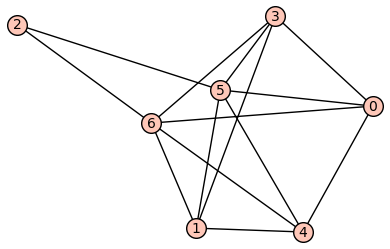

Graf  with wmdim_k = 6.0


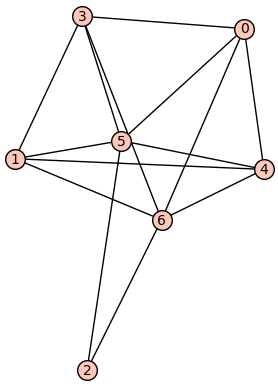

Graf  with wmdim_k = 7.0


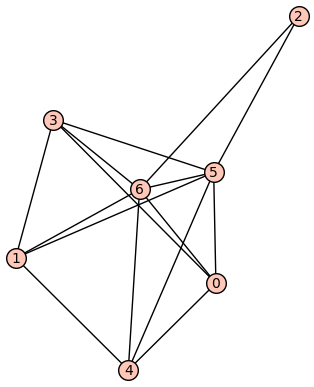

Graf  with wmdim_k = 7.0


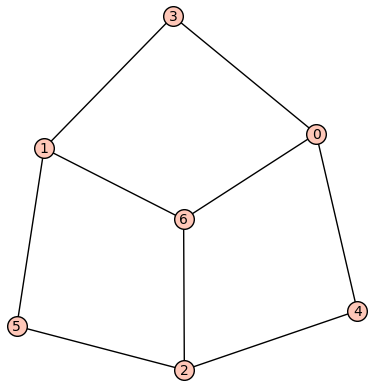

Graf  with wmdim_k = 7.0


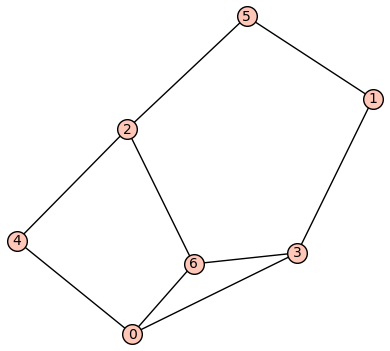

Graf  with wmdim_k = 7.0


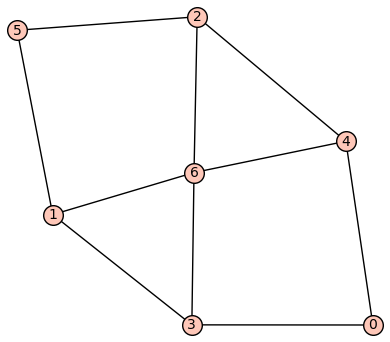

Graf  with wmdim_k = 6.0


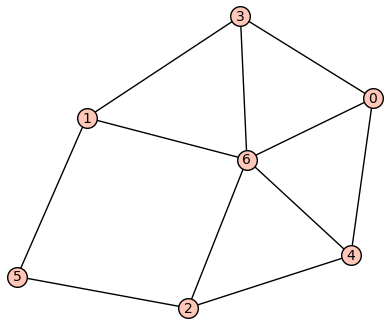

Graf  with wmdim_k = 5.0


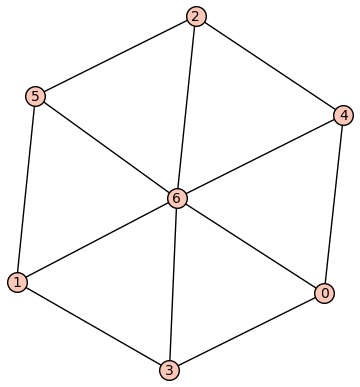

Graf  with wmdim_k = 6.0


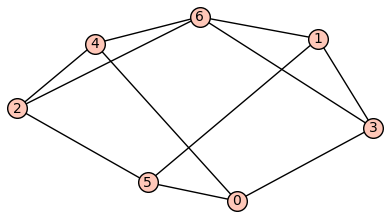

Graf  with wmdim_k = 6.0


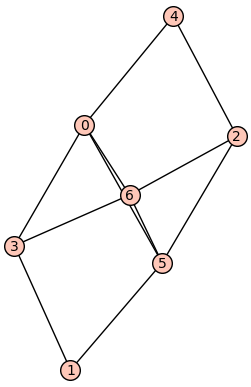

Graf  with wmdim_k = 7.0


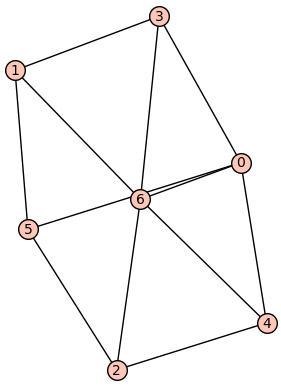

Graf  with wmdim_k = 5.0


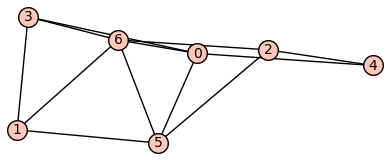

Graf  with wmdim_k = 5.0


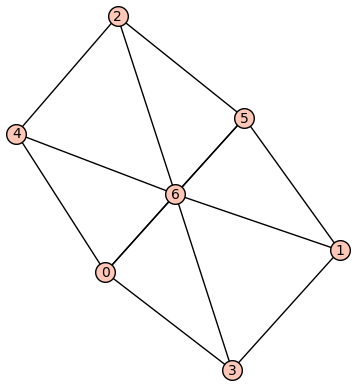

Graf  with wmdim_k = 6.0


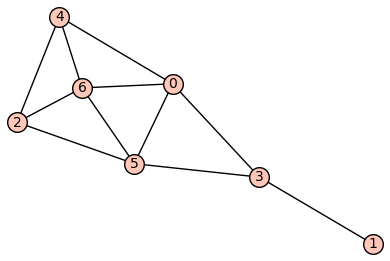

Graf  with wmdim_k = 5.0


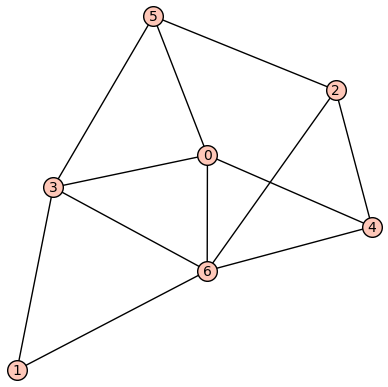

Graf  with wmdim_k = 5.0


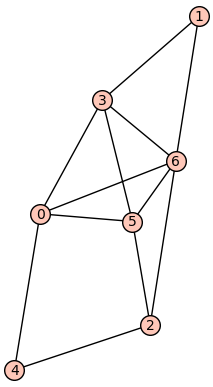

Graf  with wmdim_k = 5.0


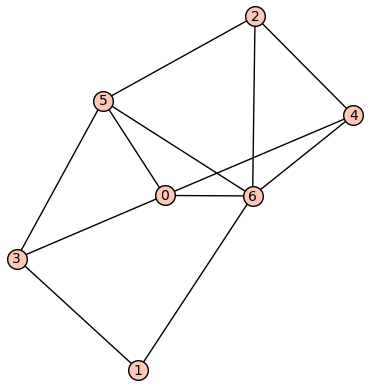

Graf  with wmdim_k = 5.0


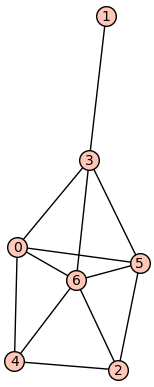

Graf  with wmdim_k = 5.0


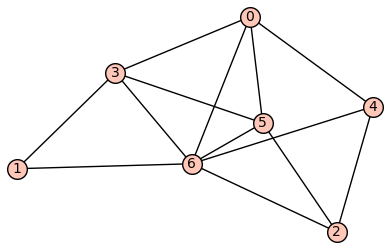

Graf  with wmdim_k = 6.0


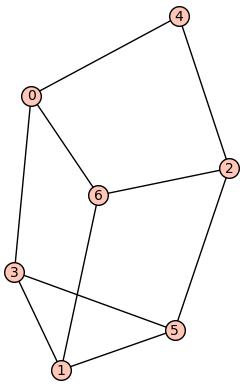

Graf  with wmdim_k = 7.0


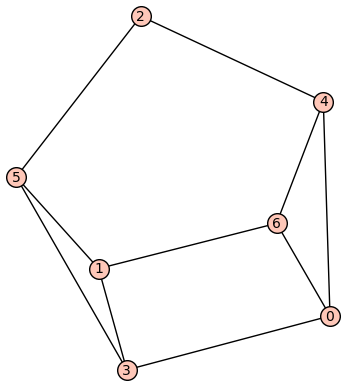

Graf  with wmdim_k = 7.0


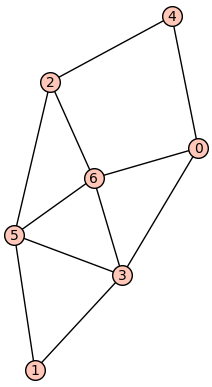

Graf  with wmdim_k = 5.0


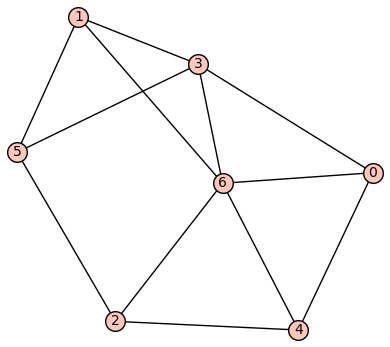

Graf  with wmdim_k = 5.0


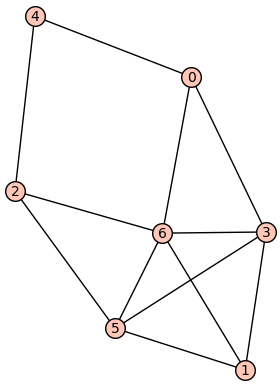

Graf  with wmdim_k = 5.0


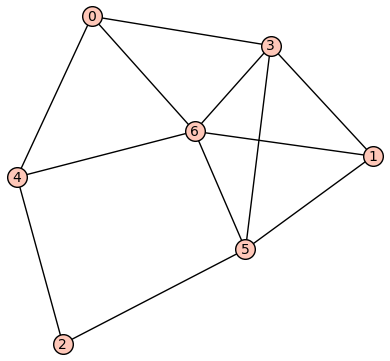

Graf  with wmdim_k = 5.0


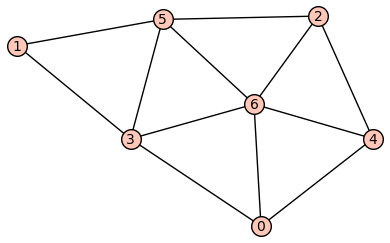

Graf  with wmdim_k = 5.0


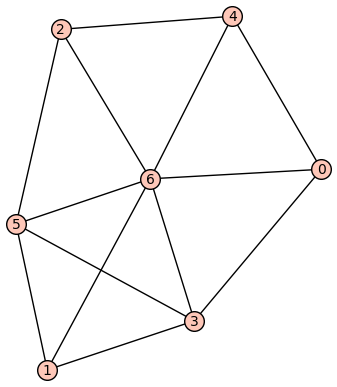

Graf  with wmdim_k = 6.0


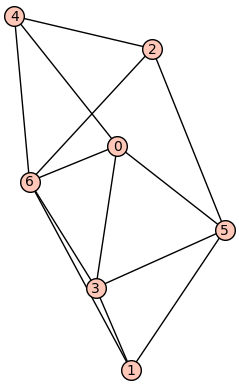

Graf  with wmdim_k = 5.0


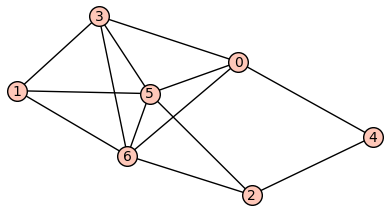

Graf  with wmdim_k = 6.0


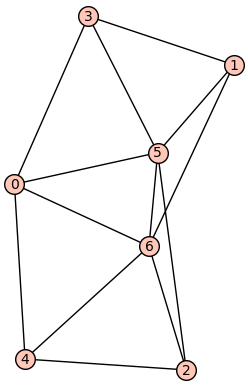

Graf  with wmdim_k = 6.0


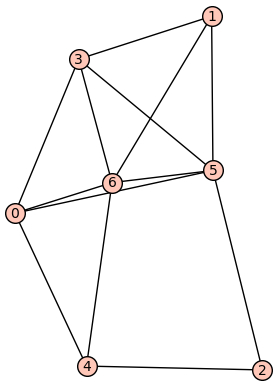

Graf  with wmdim_k = 5.0


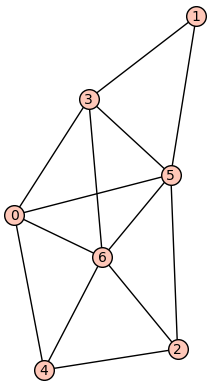

Graf  with wmdim_k = 5.0


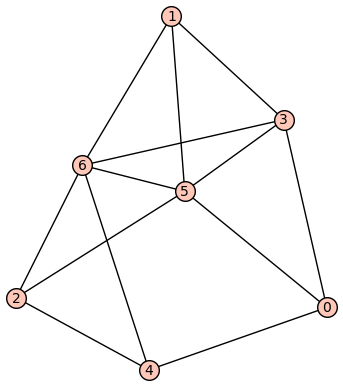

Graf  with wmdim_k = 5.0


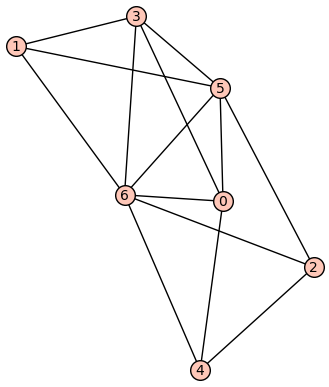

Graf  with wmdim_k = 6.0


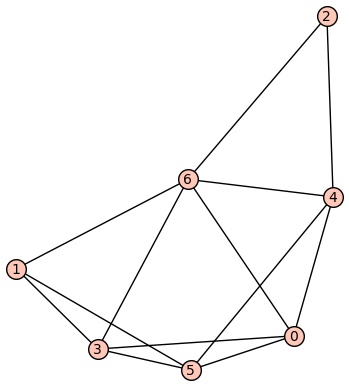

Graf  with wmdim_k = 5.0


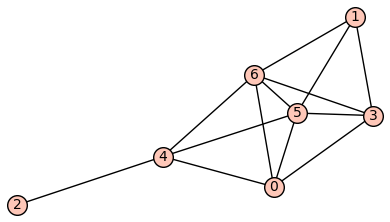

Graf  with wmdim_k = 6.0


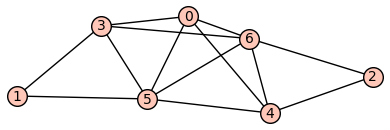

Graf  with wmdim_k = 5.0


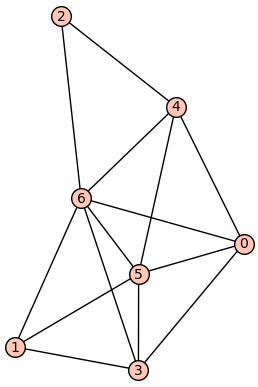

Graf  with wmdim_k = 6.0


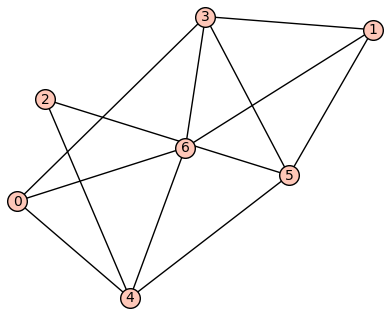

Graf  with wmdim_k = 5.0


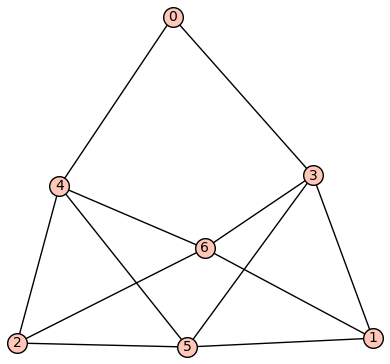

Graf  with wmdim_k = 5.0


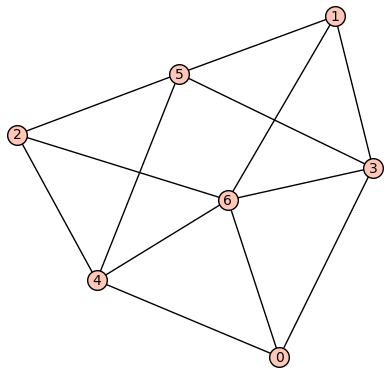

Graf  with wmdim_k = 5.0


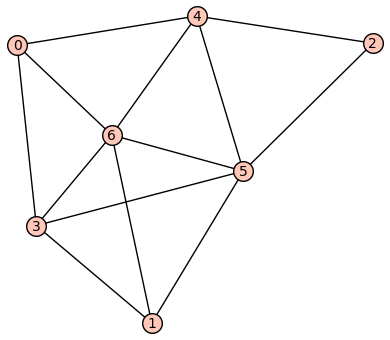

Graf  with wmdim_k = 6.0


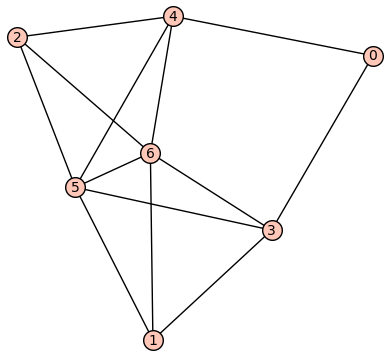

Graf  with wmdim_k = 6.0


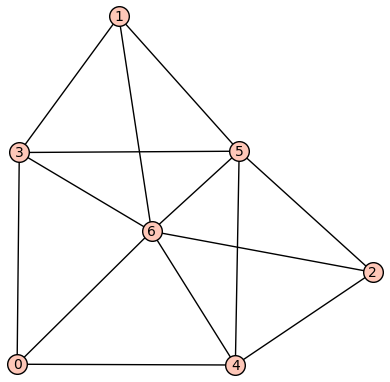

Graf  with wmdim_k = 6.0


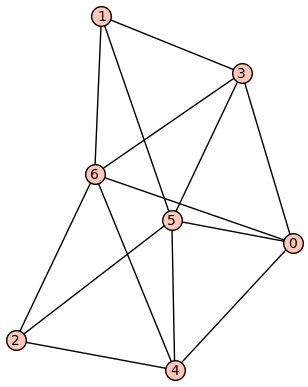

Graf  with wmdim_k = 6.0


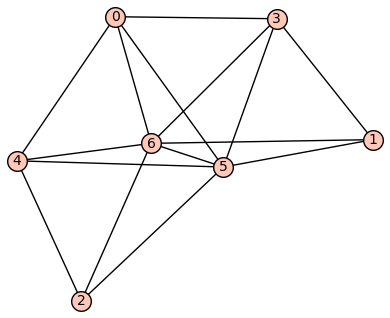

Graf  with wmdim_k = 7.0


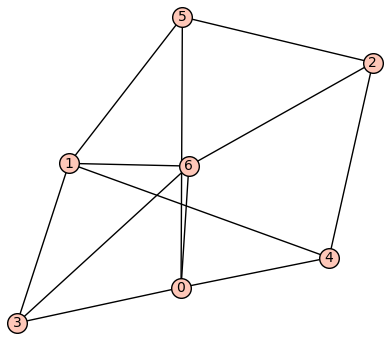

Graf  with wmdim_k = 5.0


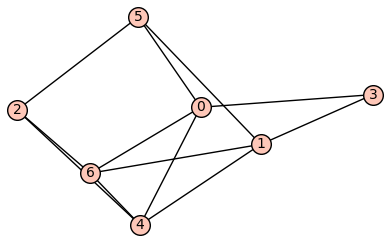

Graf  with wmdim_k = 5.0


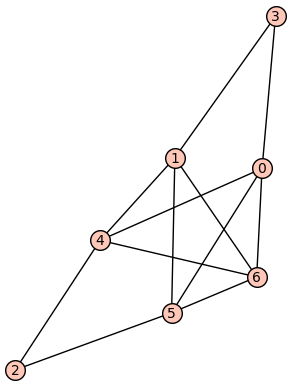

Graf  with wmdim_k = 5.0


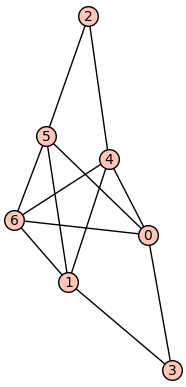

Graf  with wmdim_k = 7.0


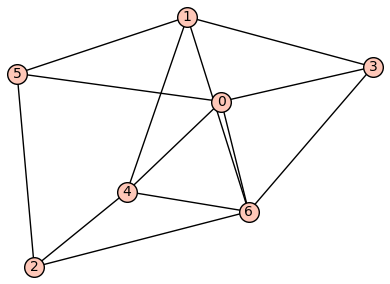

Graf  with wmdim_k = 5.0


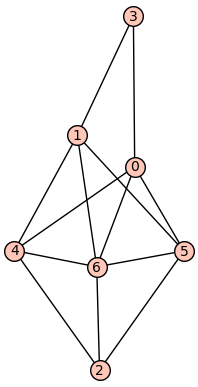

Graf  with wmdim_k = 5.0


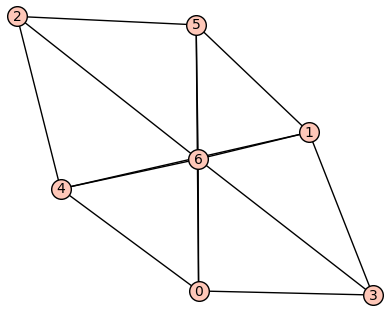

Graf  with wmdim_k = 6.0


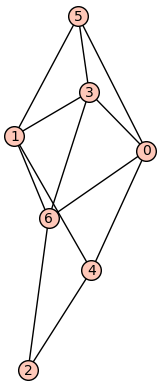

Graf  with wmdim_k = 5.0


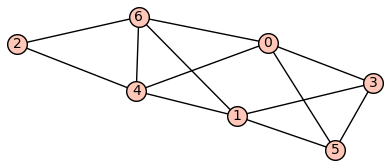

Graf  with wmdim_k = 6.0


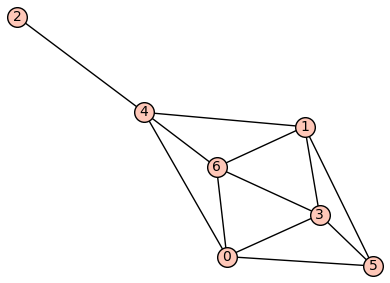

Graf  with wmdim_k = 5.0


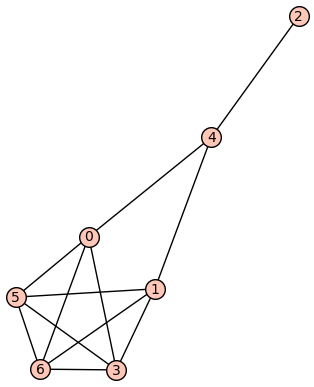

Graf  with wmdim_k = 5.0


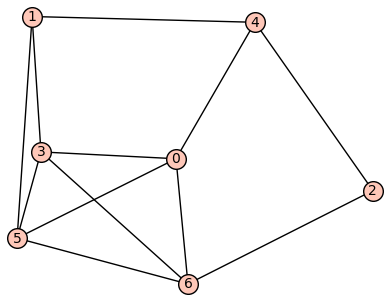

Graf  with wmdim_k = 5.0


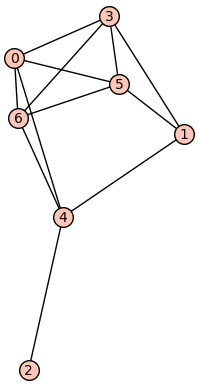

Graf  with wmdim_k = 5.0


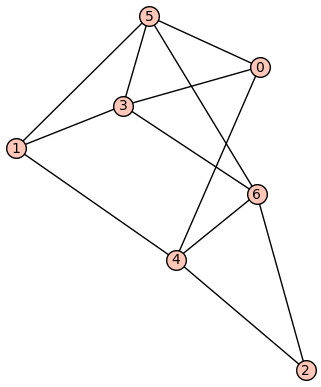

Graf  with wmdim_k = 5.0


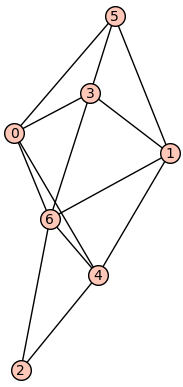

Graf  with wmdim_k = 5.0


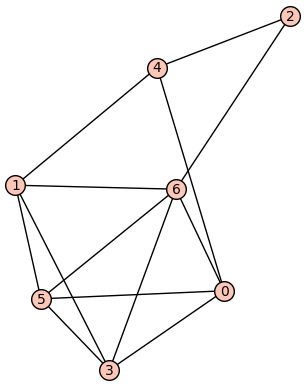

Graf  with wmdim_k = 5.0


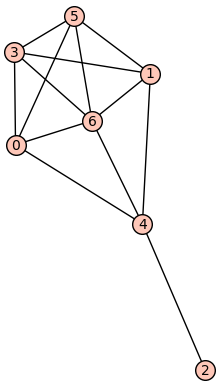

Graf  with wmdim_k = 5.0


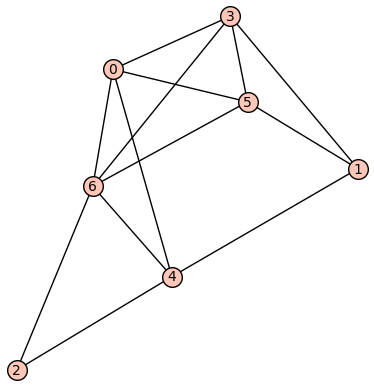

Graf  with wmdim_k = 5.0


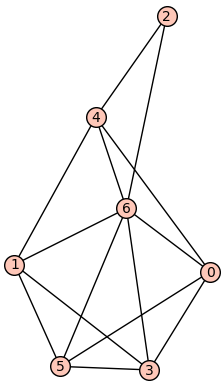

Graf  with wmdim_k = 6.0


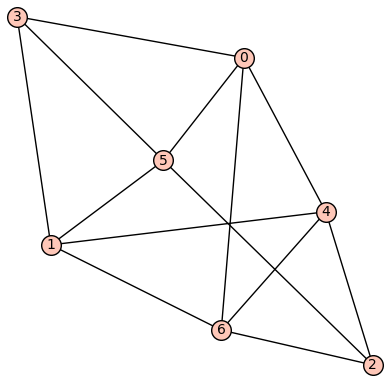

Graf  with wmdim_k = 5.0


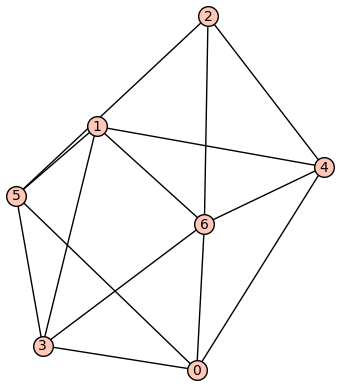

Graf  with wmdim_k = 5.0


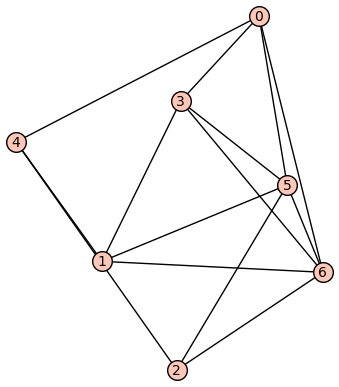

Graf  with wmdim_k = 6.0


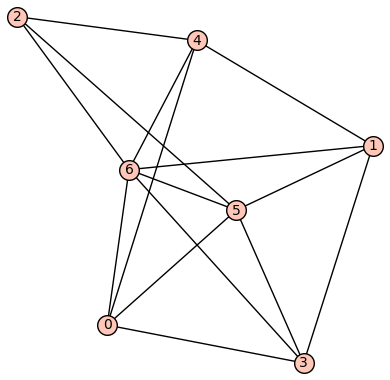

Graf  with wmdim_k = 6.0


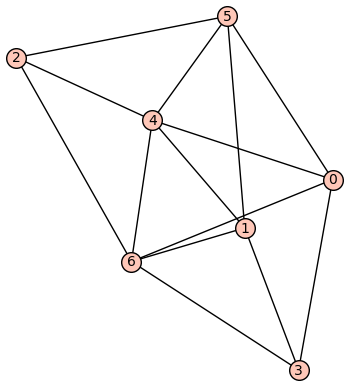

Graf  with wmdim_k = 6.0


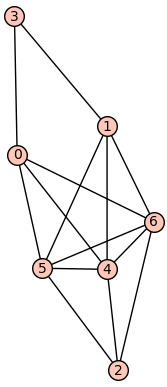

Graf  with wmdim_k = 6.0


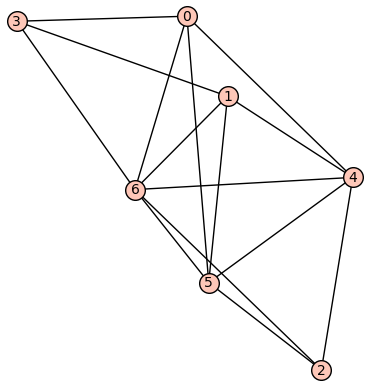

Graf  with wmdim_k = 6.0


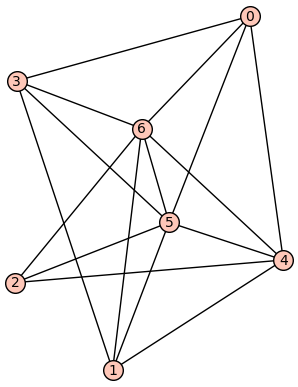

Graf  with wmdim_k = 7.0


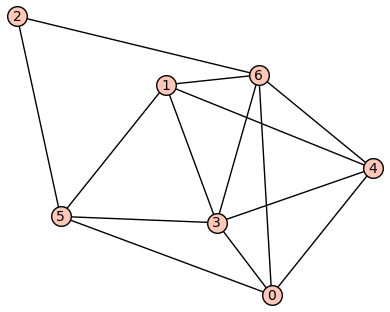

Graf  with wmdim_k = 5.0


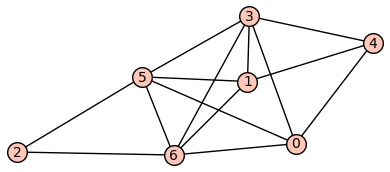

Graf  with wmdim_k = 6.0


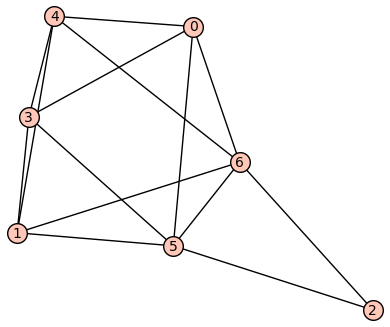

Graf  with wmdim_k = 6.0


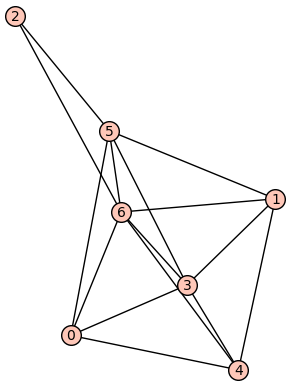

Graf  with wmdim_k = 6.0


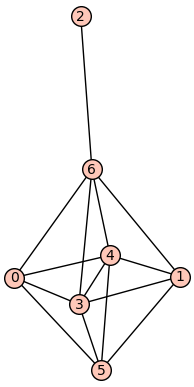

Graf  with wmdim_k = 6.0


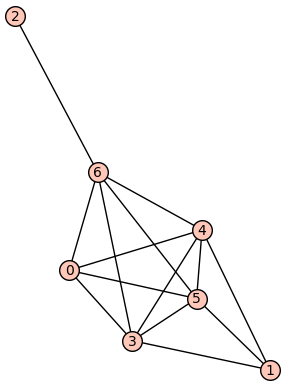

Graf  with wmdim_k = 6.0


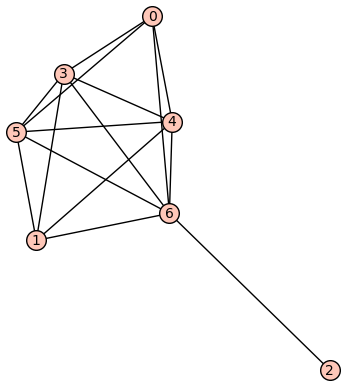

Graf  with wmdim_k = 6.0


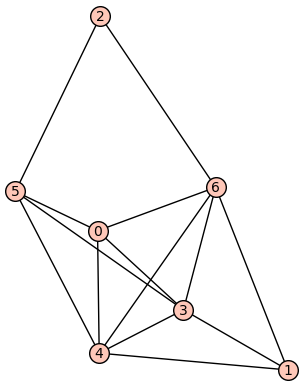

Graf  with wmdim_k = 6.0


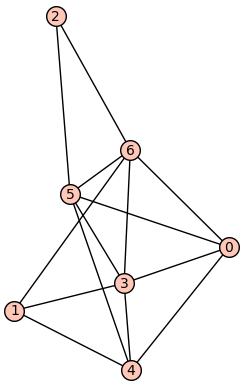

Graf  with wmdim_k = 6.0


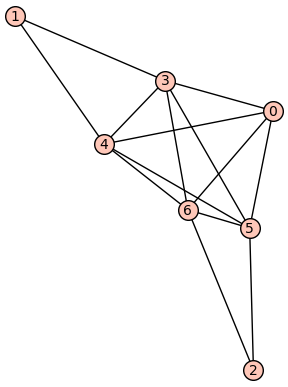

Graf  with wmdim_k = 7.0


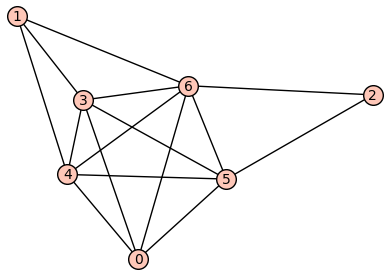

Graf  with wmdim_k = 6.0


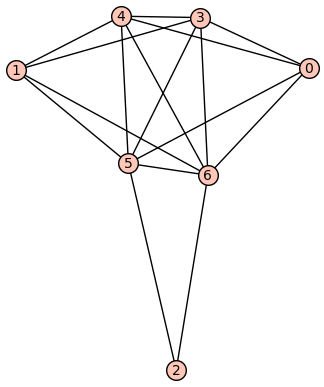

Graf  with wmdim_k = 7.0


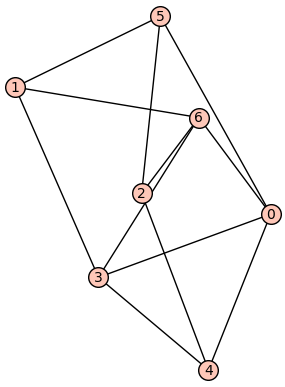

Graf  with wmdim_k = 7.0


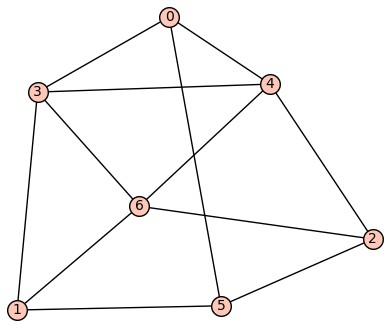

Graf  with wmdim_k = 5.0


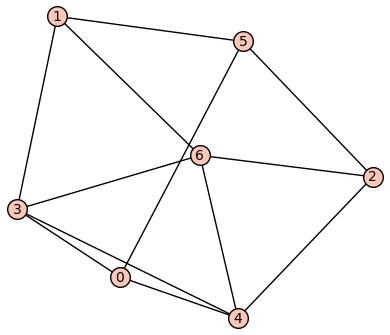

Graf  with wmdim_k = 7.0


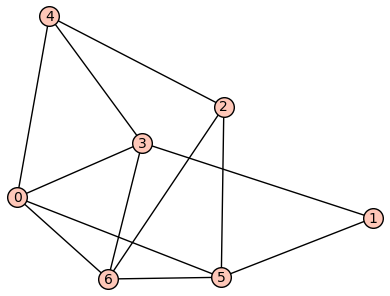

Graf  with wmdim_k = 5.0


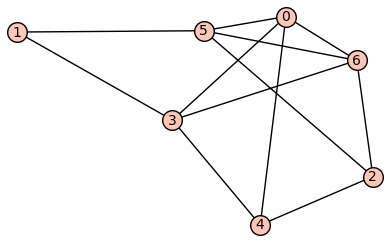

Graf  with wmdim_k = 7.0


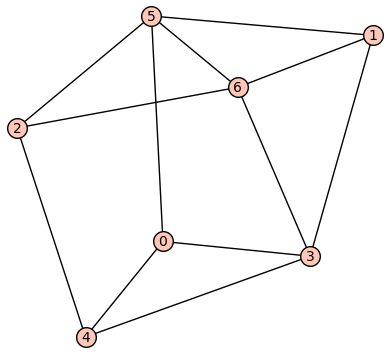

Graf  with wmdim_k = 5.0


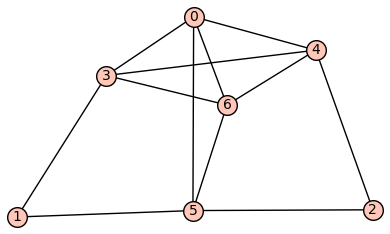

Graf  with wmdim_k = 5.0


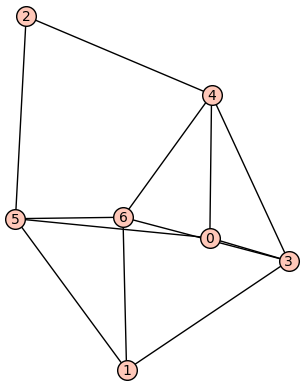

Graf  with wmdim_k = 5.0


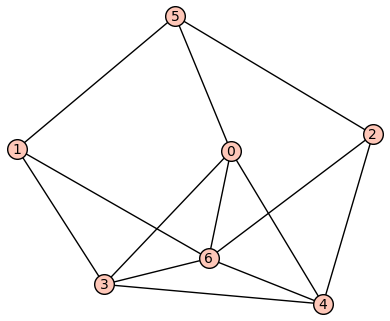

Graf  with wmdim_k = 5.0


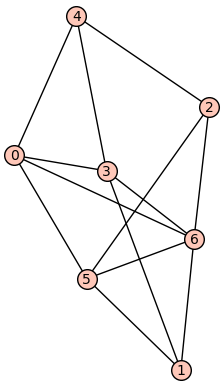

Graf  with wmdim_k = 5.0


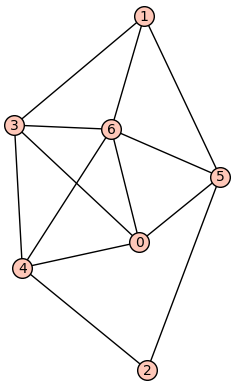

Graf  with wmdim_k = 5.0


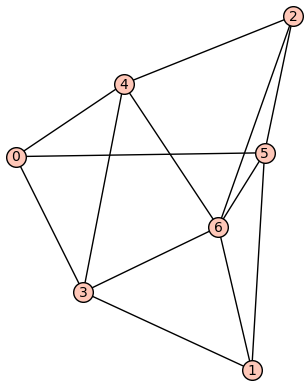

Graf  with wmdim_k = 5.0


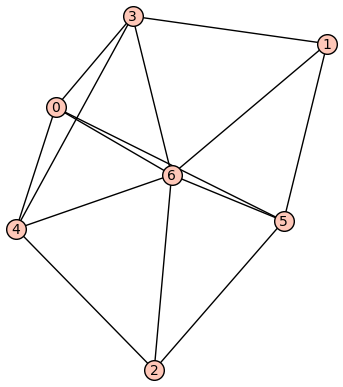

Graf  with wmdim_k = 6.0


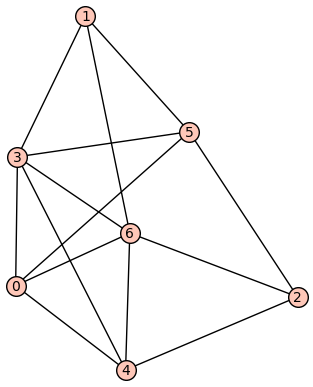

Graf  with wmdim_k = 5.0


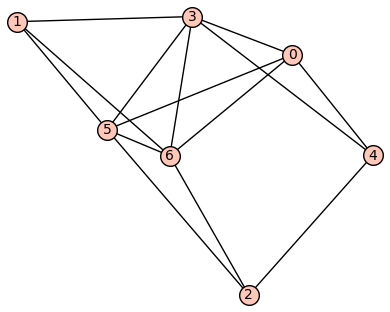

Graf  with wmdim_k = 6.0


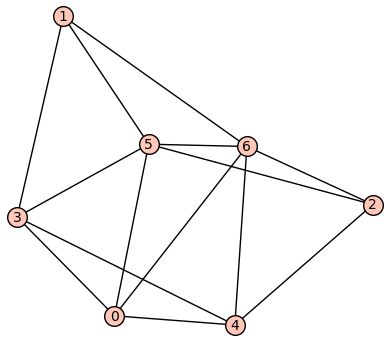

Graf  with wmdim_k = 6.0


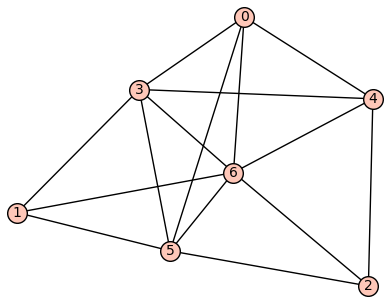

Graf  with wmdim_k = 6.0


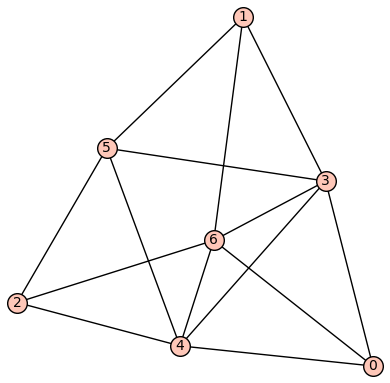

Graf  with wmdim_k = 6.0


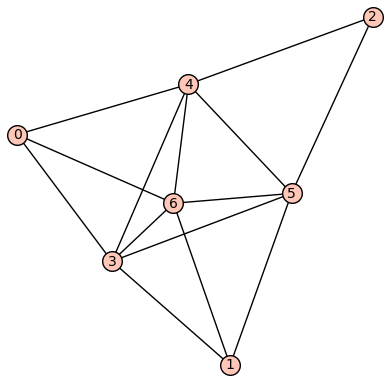

Graf  with wmdim_k = 6.0


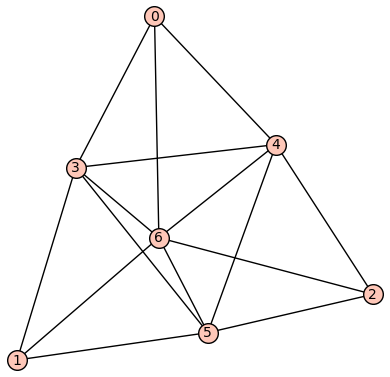

Graf  with wmdim_k = 6.0


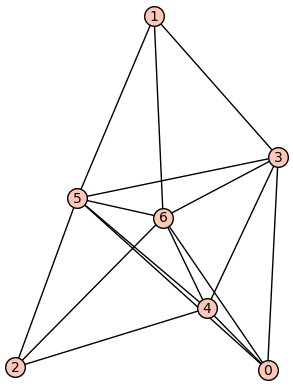

Graf  with wmdim_k = 7.0


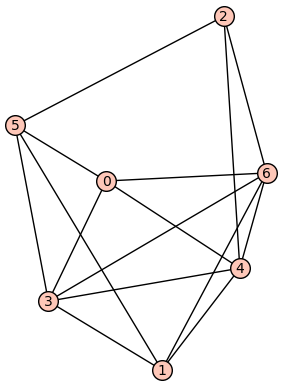

Graf  with wmdim_k = 6.0


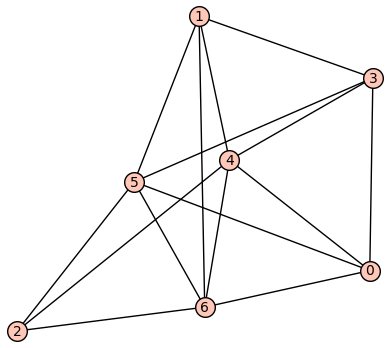

Graf  with wmdim_k = 6.0


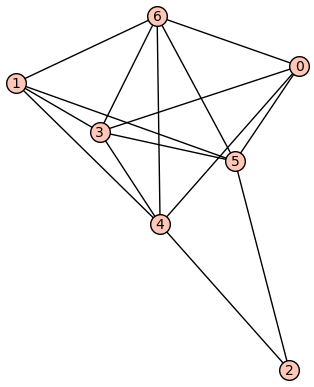

Graf  with wmdim_k = 6.0


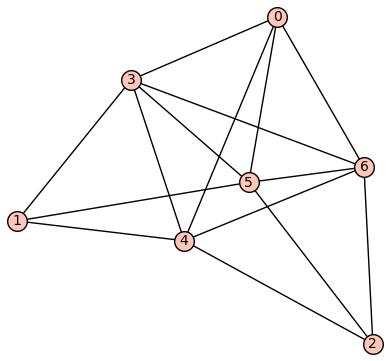

Graf  with wmdim_k = 6.0


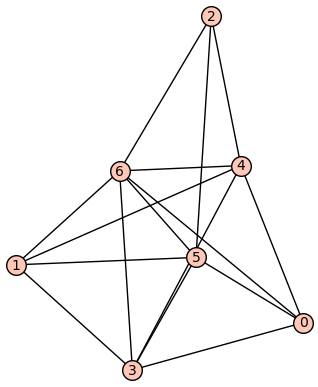

Graf  with wmdim_k = 6.0


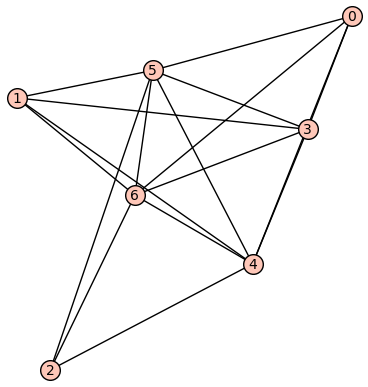

Graf  with wmdim_k = 7.0


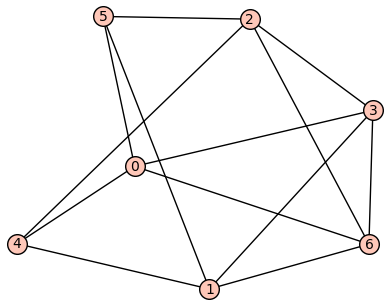

Graf  with wmdim_k = 5.0


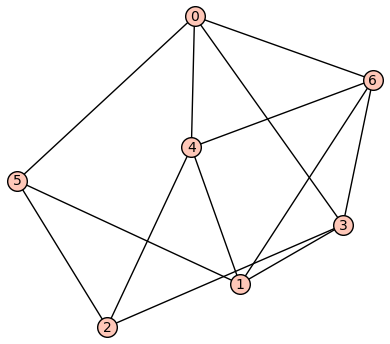

Graf  with wmdim_k = 5.0


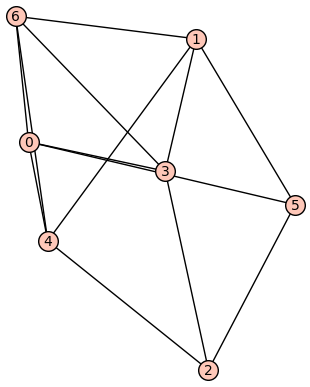

Graf  with wmdim_k = 7.0


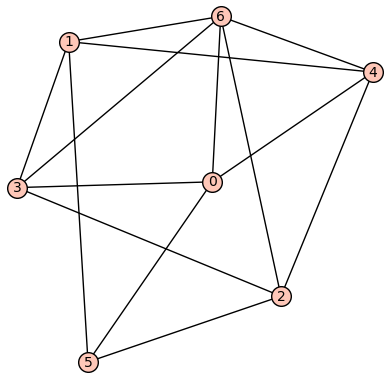

Graf  with wmdim_k = 5.0


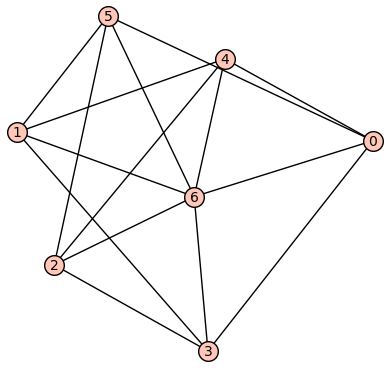

Graf  with wmdim_k = 6.0


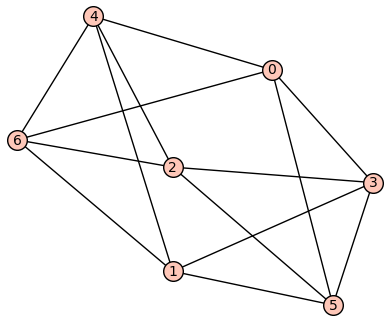

Graf  with wmdim_k = 6.0


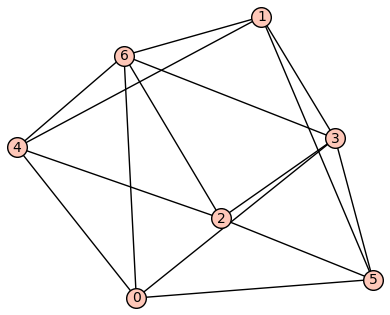

Graf  with wmdim_k = 6.0


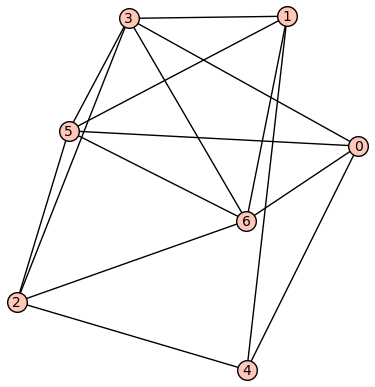

Graf  with wmdim_k = 6.0


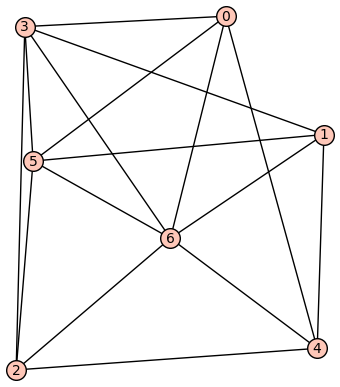

Graf  with wmdim_k = 6.0


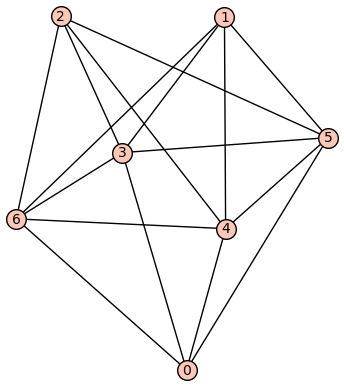

Graf  with wmdim_k = 6.0


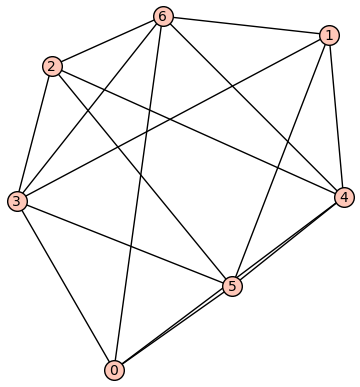

Graf  with wmdim_k = 7.0


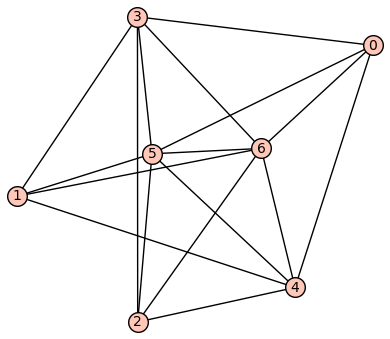

Graf  with wmdim_k = 7.0


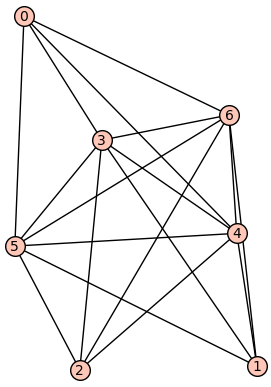

Graf  with wmdim_k = 7.0


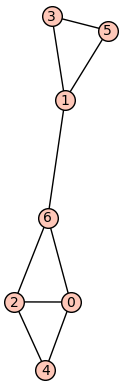

Graf  with wmdim_k = 5.0


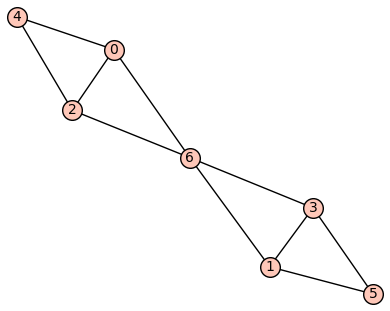

Graf  with wmdim_k = 6.0


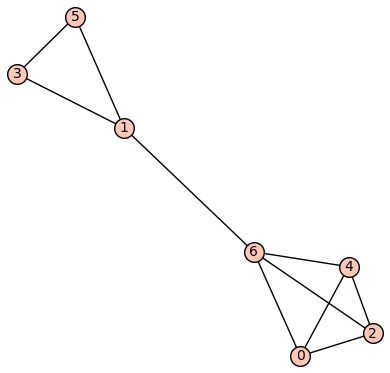

Graf  with wmdim_k = 5.0


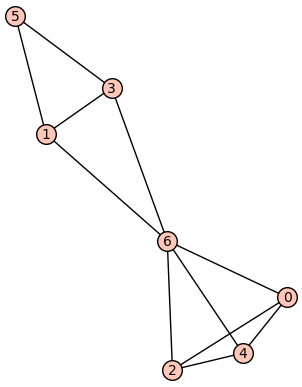

Graf  with wmdim_k = 6.0


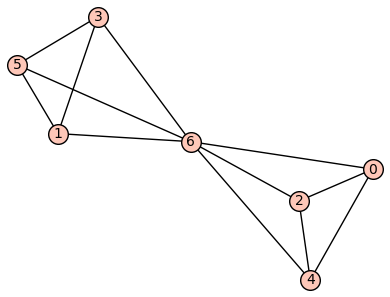

Graf  with wmdim_k = 6.0


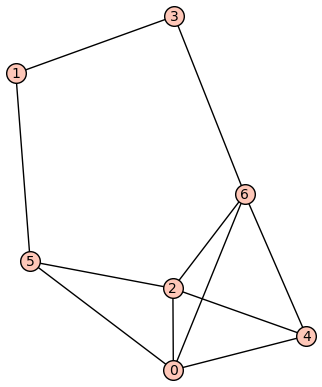

Graf  with wmdim_k = 5.0


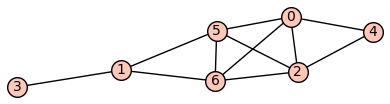

Graf  with wmdim_k = 6.0


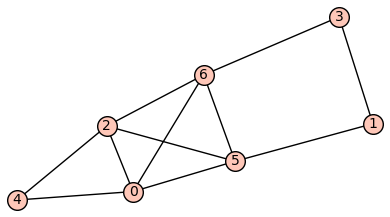

Graf  with wmdim_k = 5.0


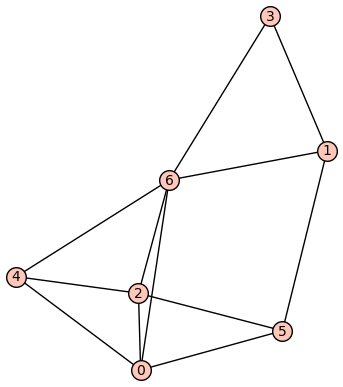

Graf  with wmdim_k = 5.0


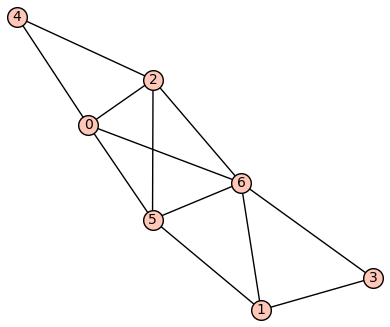

Graf  with wmdim_k = 6.0


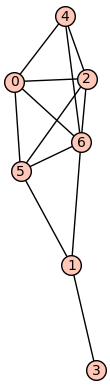

Graf  with wmdim_k = 5.0


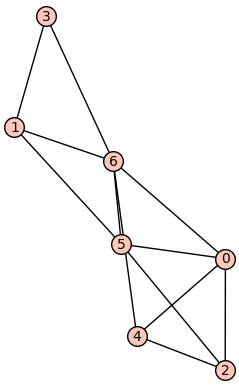

Graf  with wmdim_k = 5.0


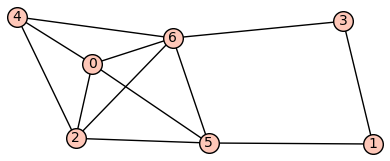

Graf  with wmdim_k = 5.0


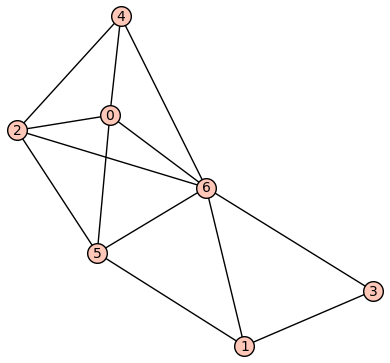

Graf  with wmdim_k = 6.0


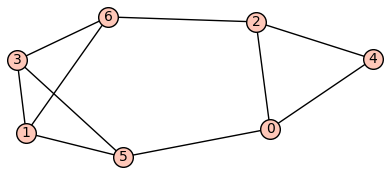

Graf  with wmdim_k = 5.0


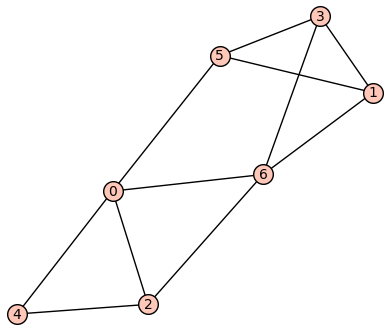

Graf  with wmdim_k = 5.0


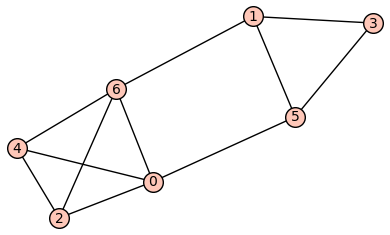

Graf  with wmdim_k = 5.0


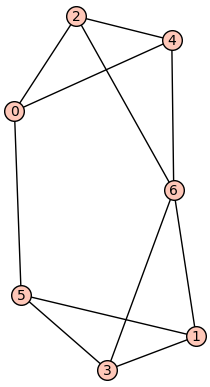

Graf  with wmdim_k = 5.0


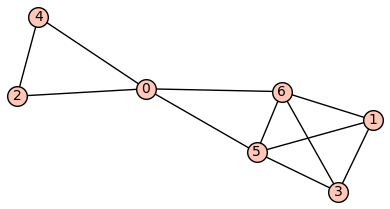

Graf  with wmdim_k = 6.0


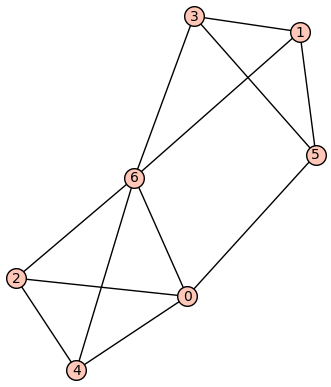

Graf  with wmdim_k = 5.0


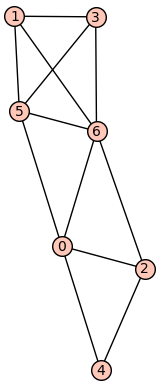

Graf  with wmdim_k = 5.0


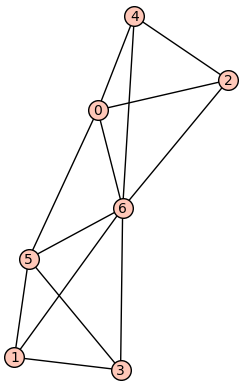

Graf  with wmdim_k = 6.0


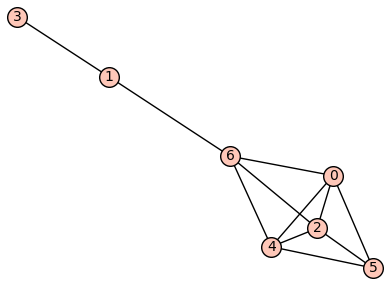

Graf  with wmdim_k = 5.0


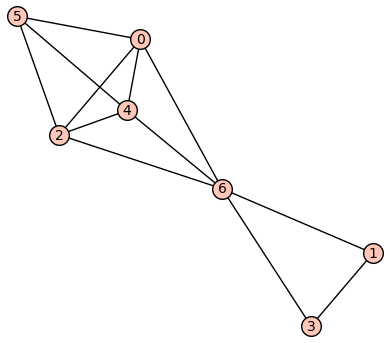

Graf  with wmdim_k = 6.0


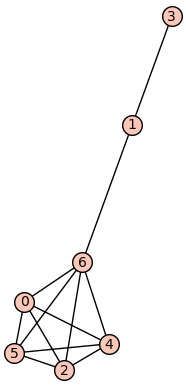

Graf  with wmdim_k = 5.0


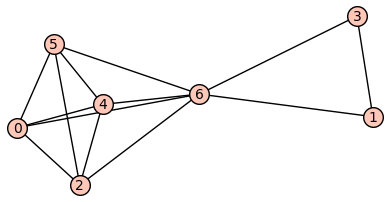

Graf  with wmdim_k = 6.0


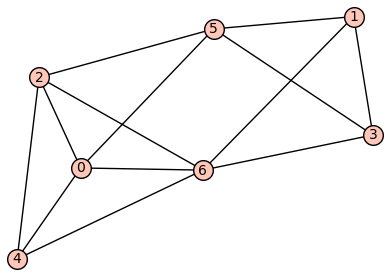

Graf  with wmdim_k = 6.0


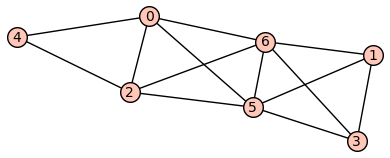

Graf  with wmdim_k = 7.0


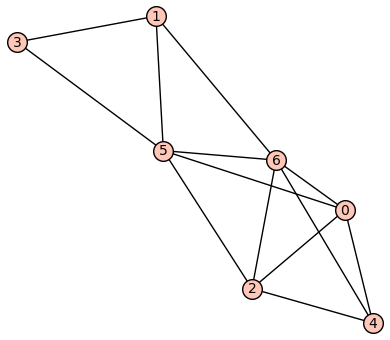

Graf  with wmdim_k = 5.0


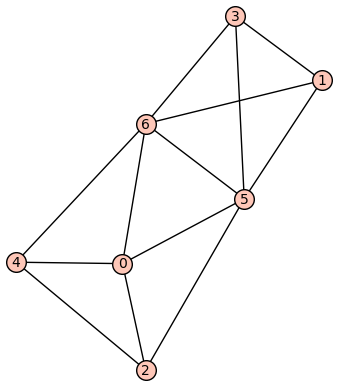

Graf  with wmdim_k = 6.0


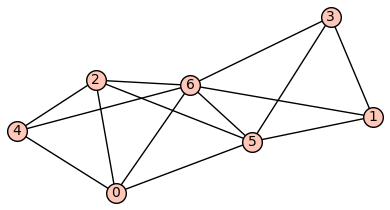

Graf  with wmdim_k = 6.0


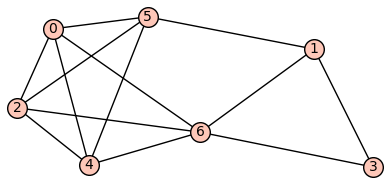

Graf  with wmdim_k = 5.0


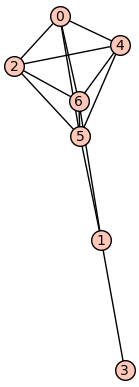

Graf  with wmdim_k = 6.0


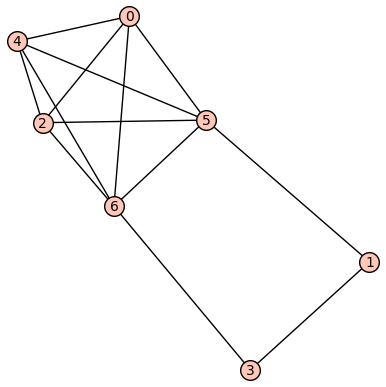

Graf  with wmdim_k = 5.0


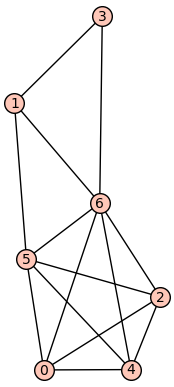

Graf  with wmdim_k = 6.0


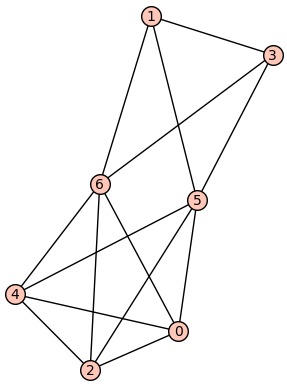

Graf  with wmdim_k = 6.0


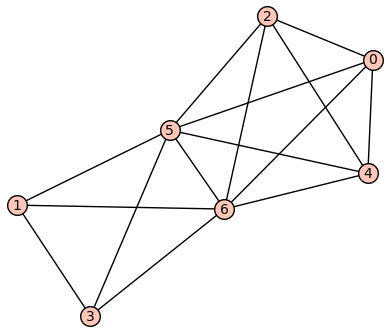

Graf  with wmdim_k = 7.0


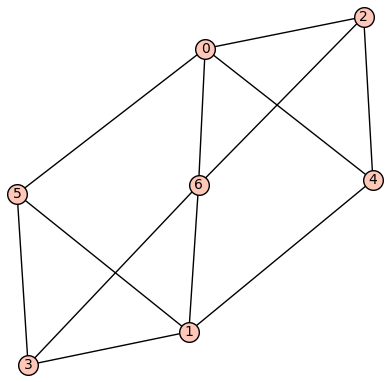

Graf  with wmdim_k = 5.0


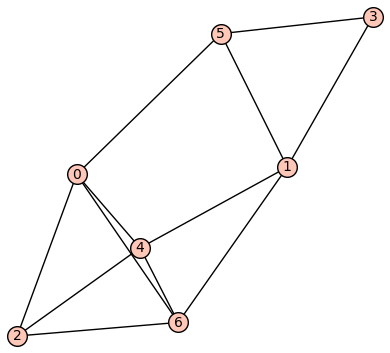

Graf  with wmdim_k = 5.0


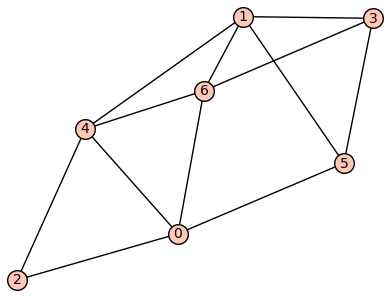

Graf  with wmdim_k = 5.0


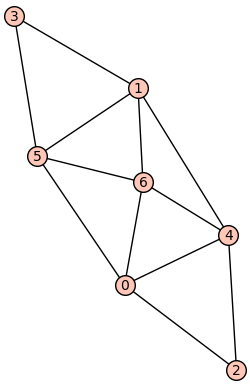

Graf  with wmdim_k = 5.0


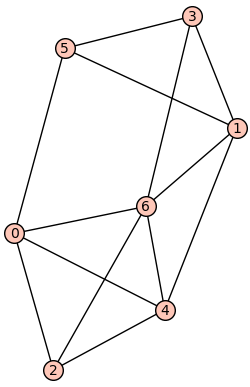

Graf  with wmdim_k = 5.0


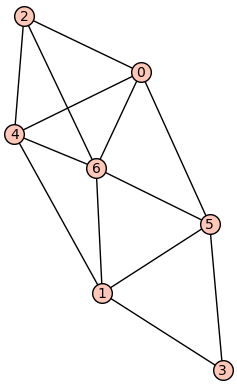

Graf  with wmdim_k = 6.0


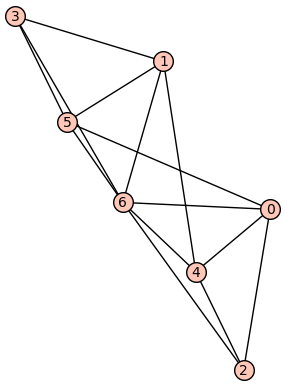

Graf  with wmdim_k = 6.0


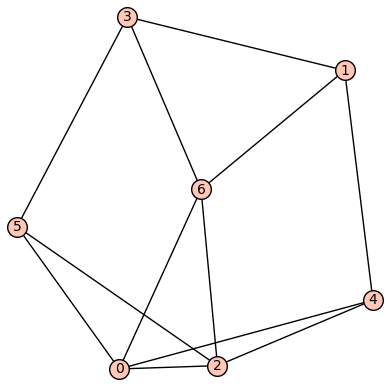

Graf  with wmdim_k = 5.0


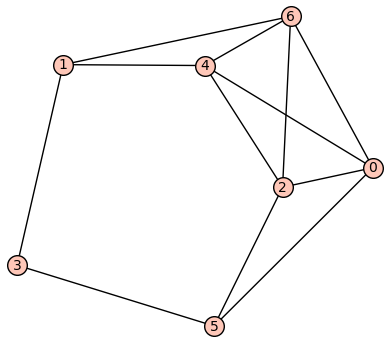

Graf  with wmdim_k = 5.0


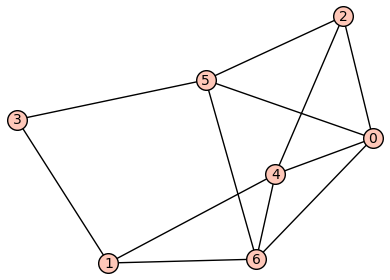

Graf  with wmdim_k = 5.0


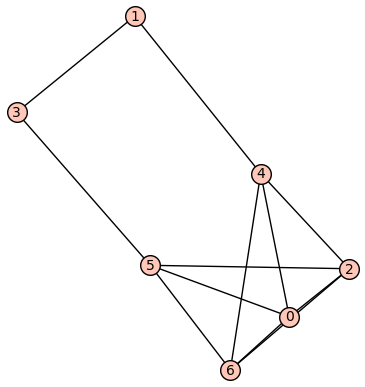

Graf  with wmdim_k = 5.0


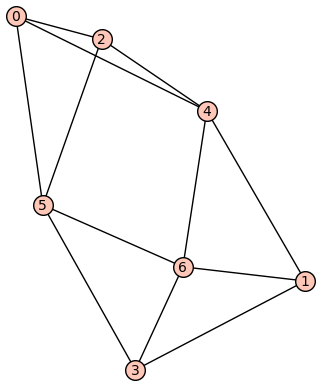

Graf  with wmdim_k = 6.0


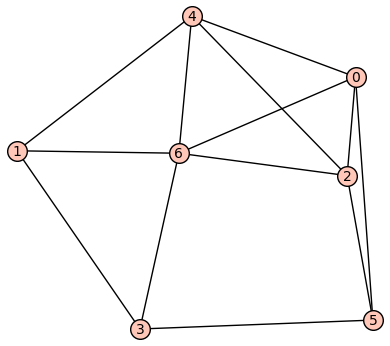

Graf  with wmdim_k = 5.0


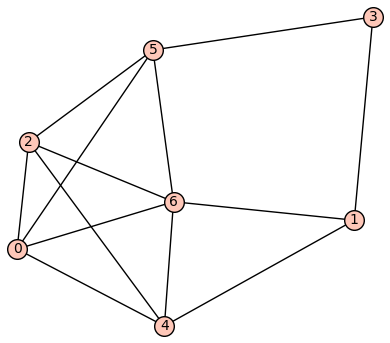

Graf  with wmdim_k = 5.0


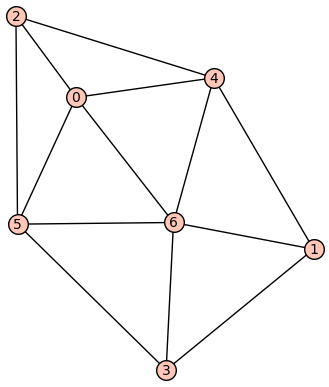

Graf  with wmdim_k = 5.0


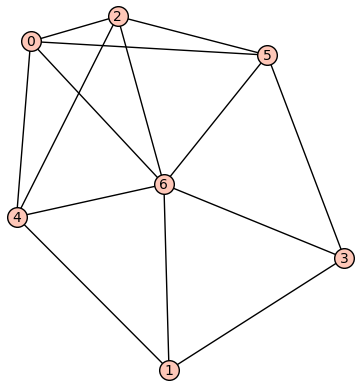

Graf  with wmdim_k = 6.0


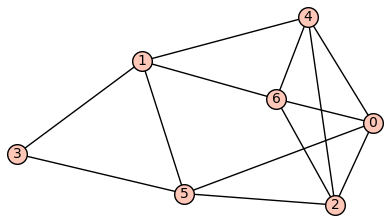

Graf  with wmdim_k = 5.0


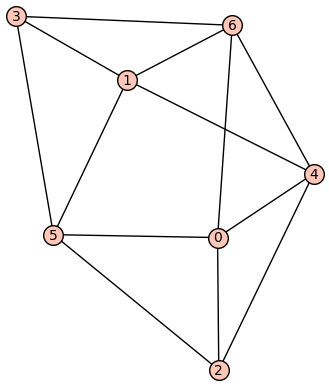

Graf  with wmdim_k = 5.0


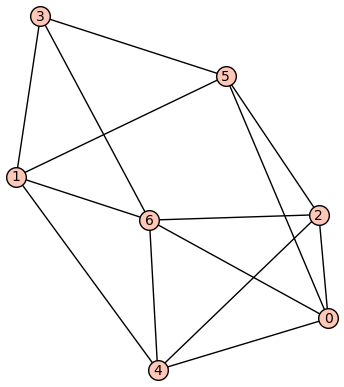

Graf  with wmdim_k = 5.0


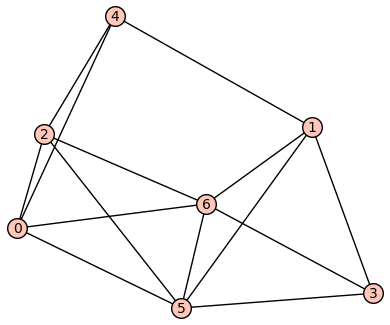

Graf  with wmdim_k = 6.0


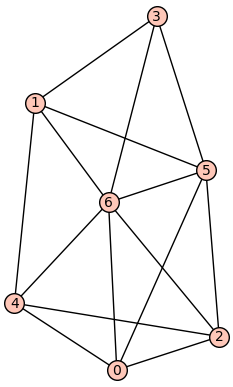

Graf  with wmdim_k = 6.0


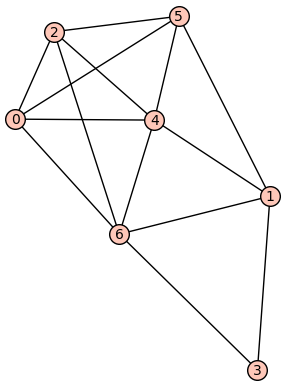

Graf  with wmdim_k = 6.0


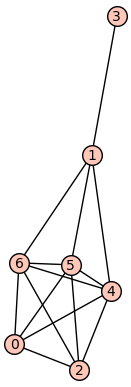

Graf  with wmdim_k = 6.0


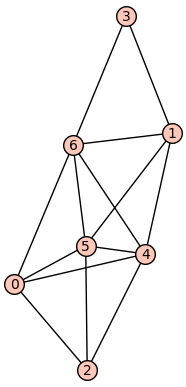

Graf  with wmdim_k = 6.0


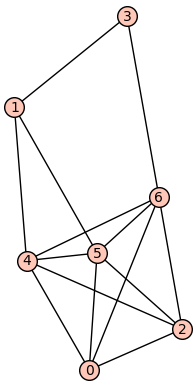

Graf  with wmdim_k = 6.0


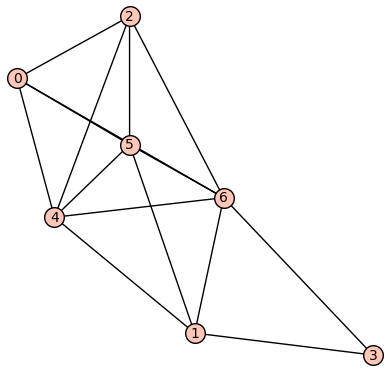

Graf  with wmdim_k = 6.0


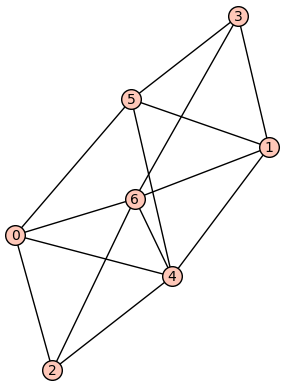

Graf  with wmdim_k = 6.0


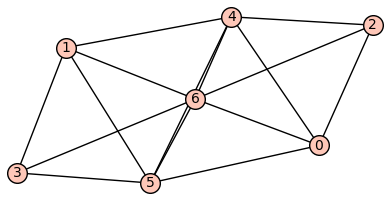

Graf  with wmdim_k = 6.0


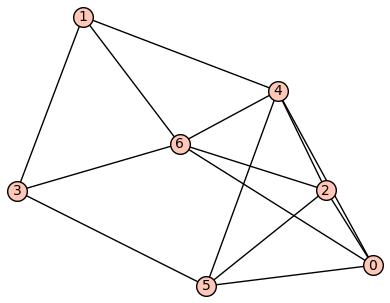

Graf  with wmdim_k = 5.0


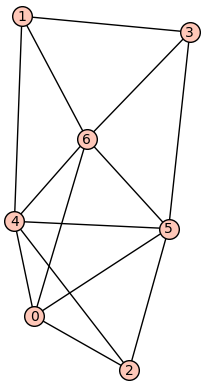

Graf  with wmdim_k = 6.0


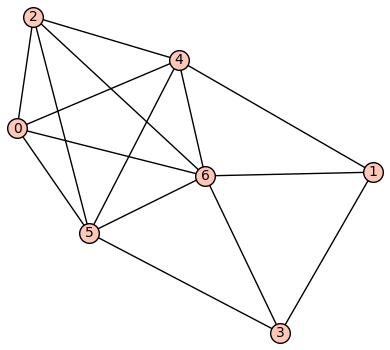

Graf  with wmdim_k = 6.0


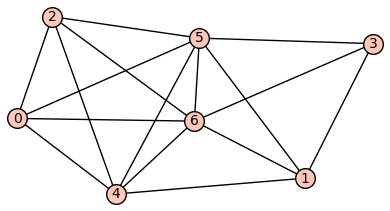

Graf  with wmdim_k = 7.0


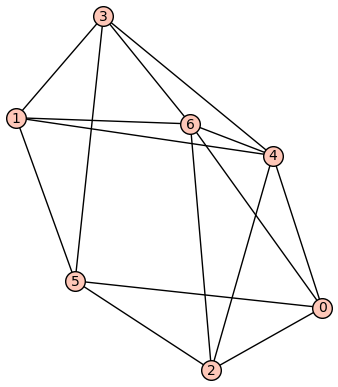

Graf  with wmdim_k = 6.0


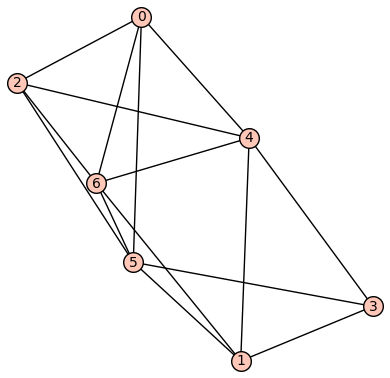

Graf  with wmdim_k = 6.0


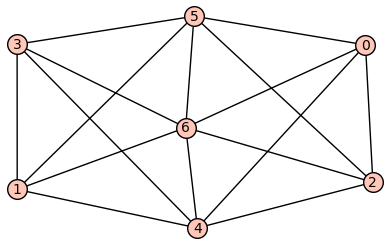

Graf  with wmdim_k = 6.0


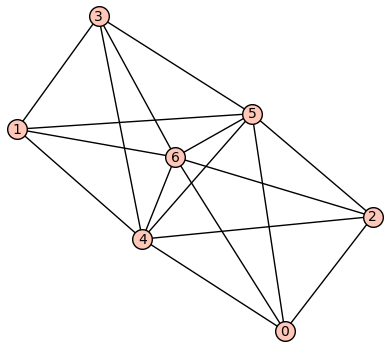

Graf  with wmdim_k = 7.0


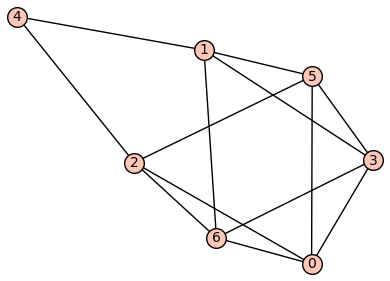

Graf  with wmdim_k = 5.0


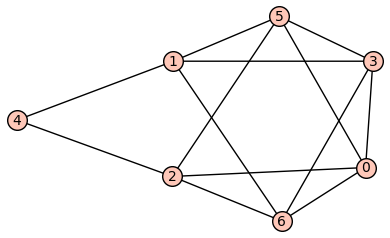

Graf  with wmdim_k = 7.0


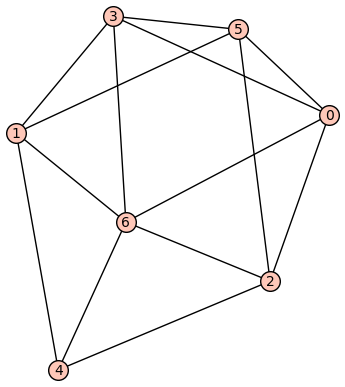

Graf  with wmdim_k = 5.0


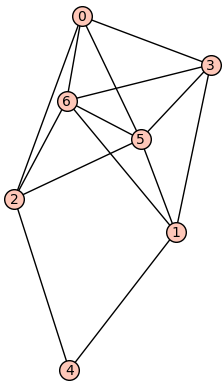

Graf  with wmdim_k = 6.0


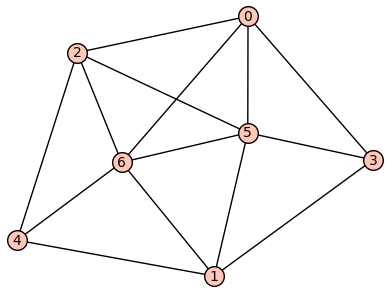

Graf  with wmdim_k = 6.0


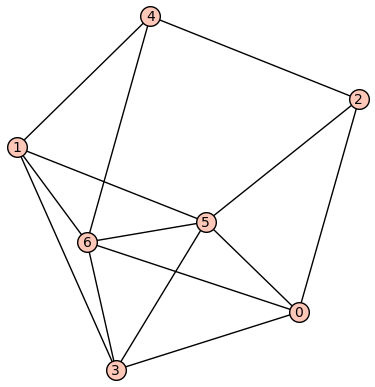

Graf  with wmdim_k = 5.0


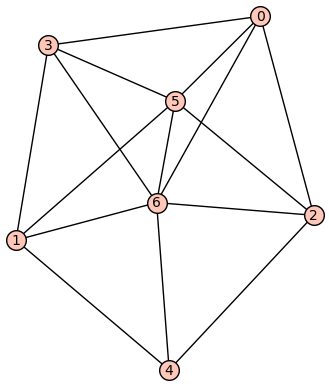

Graf  with wmdim_k = 6.0


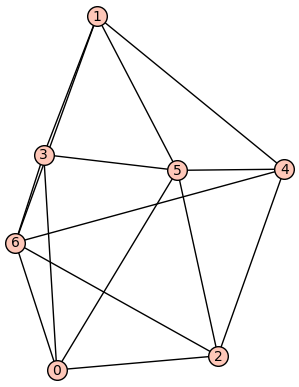

Graf  with wmdim_k = 6.0


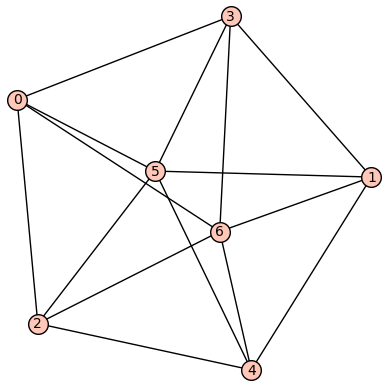

Graf  with wmdim_k = 7.0


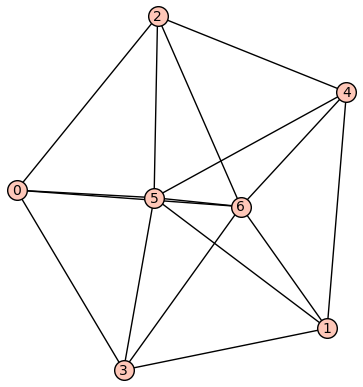

Graf  with wmdim_k = 7.0


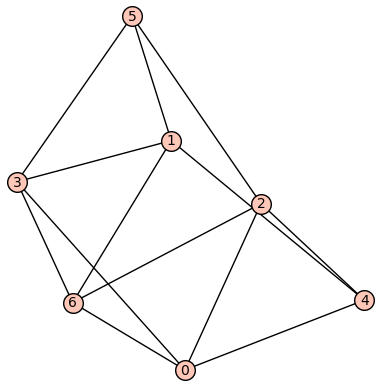

Graf  with wmdim_k = 5.0


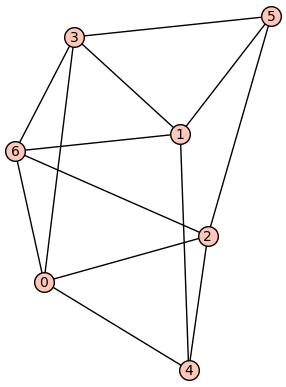

Graf  with wmdim_k = 7.0


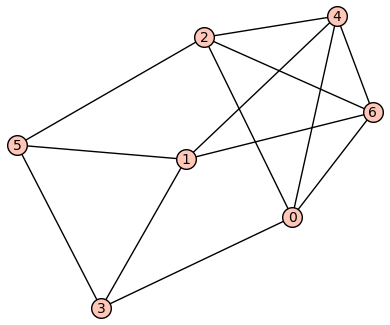

Graf  with wmdim_k = 5.0


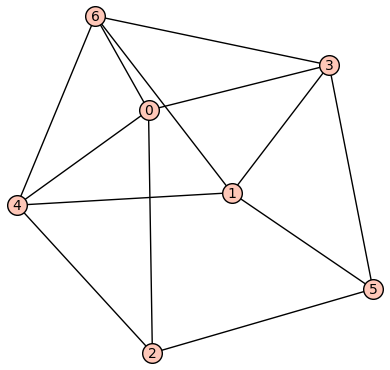

Graf  with wmdim_k = 5.0


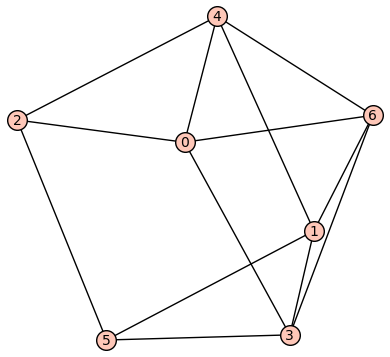

Graf  with wmdim_k = 7.0


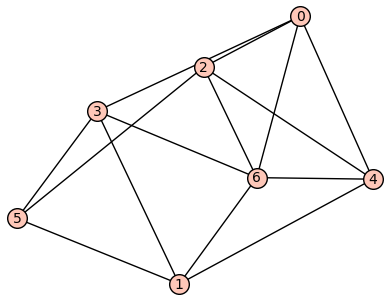

Graf  with wmdim_k = 5.0


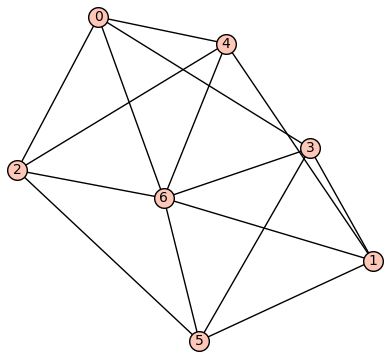

Graf  with wmdim_k = 6.0


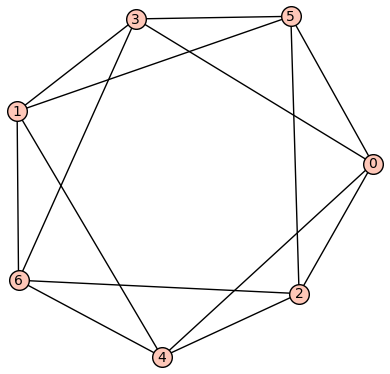

Graf  with wmdim_k = 5.0


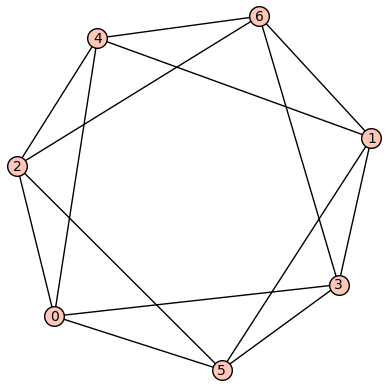

Graf  with wmdim_k = 7.0


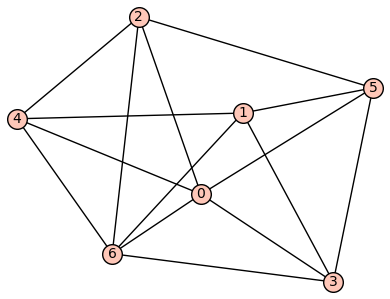

Graf  with wmdim_k = 6.0


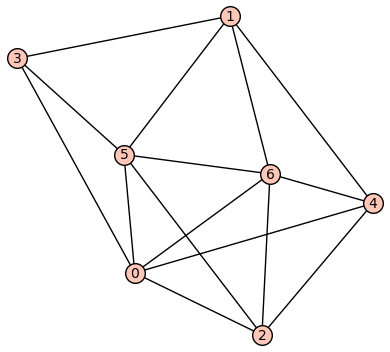

Graf  with wmdim_k = 6.0


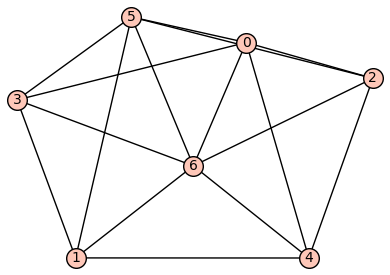

Graf  with wmdim_k = 6.0


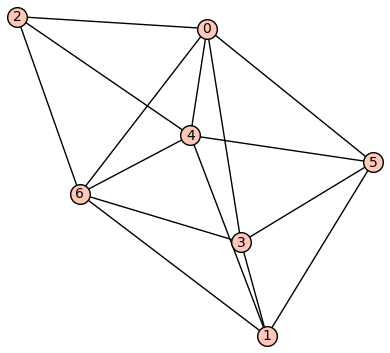

Graf  with wmdim_k = 6.0


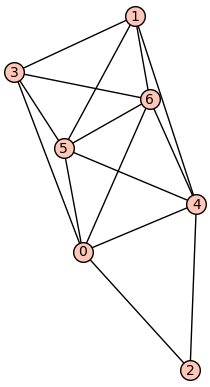

Graf  with wmdim_k = 6.0


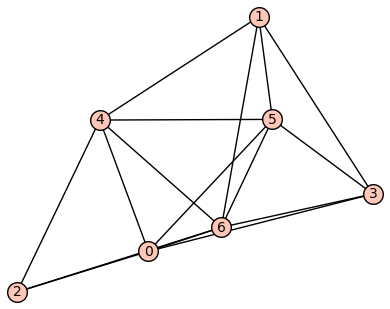

Graf  with wmdim_k = 6.0


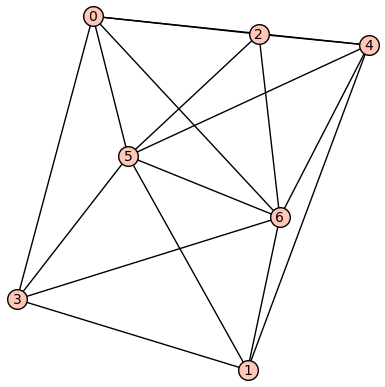

Graf  with wmdim_k = 7.0


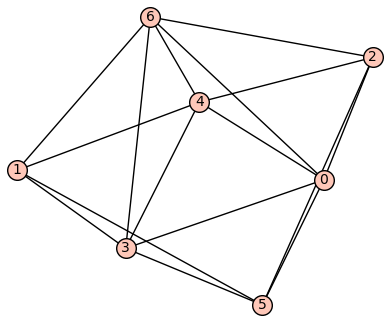

Graf  with wmdim_k = 6.0


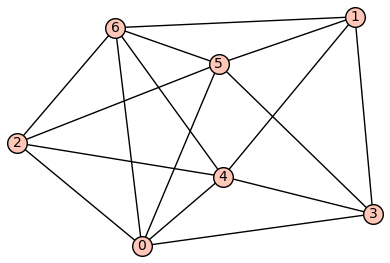

Graf  with wmdim_k = 6.0


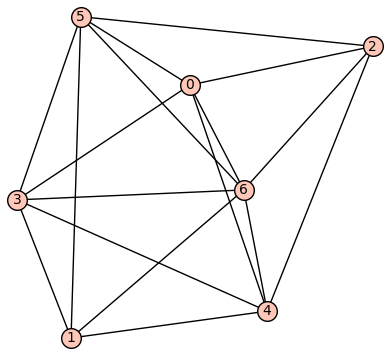

Graf  with wmdim_k = 6.0


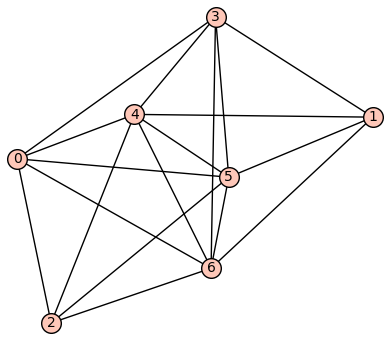

Graf  with wmdim_k = 7.0


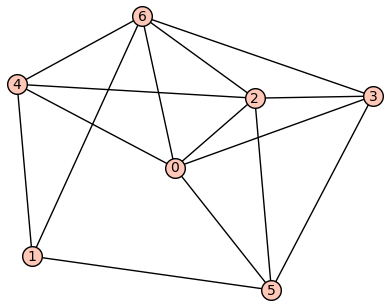

Graf  with wmdim_k = 6.0


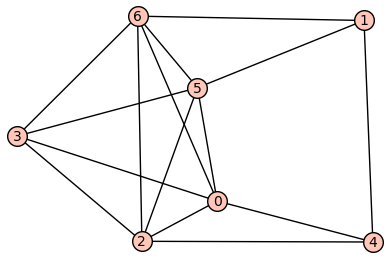

Graf  with wmdim_k = 6.0


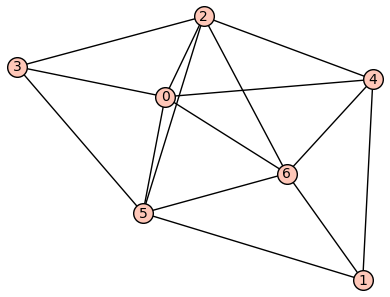

Graf  with wmdim_k = 6.0


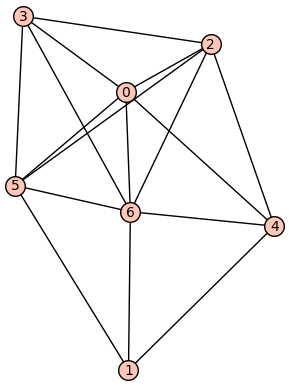

Graf  with wmdim_k = 6.0


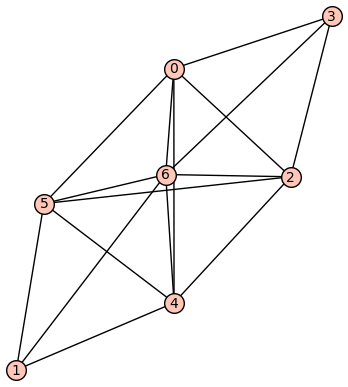

Graf  with wmdim_k = 6.0


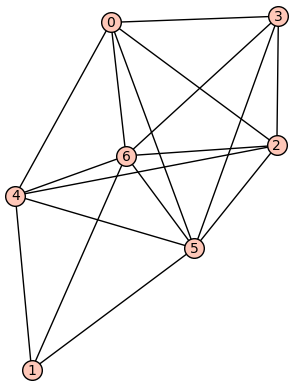

Graf  with wmdim_k = 7.0


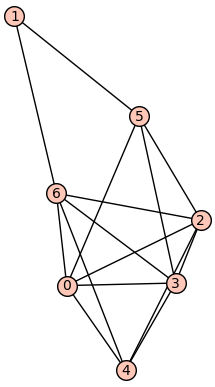

Graf  with wmdim_k = 6.0


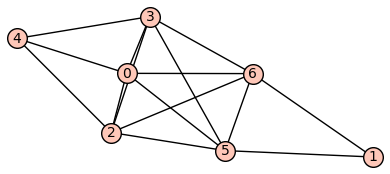

Graf  with wmdim_k = 7.0


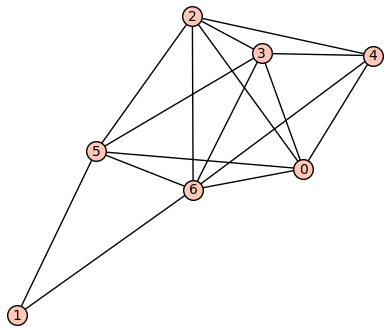

Graf  with wmdim_k = 6.0


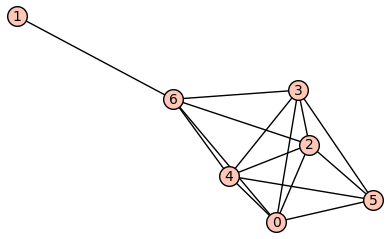

Graf  with wmdim_k = 6.0


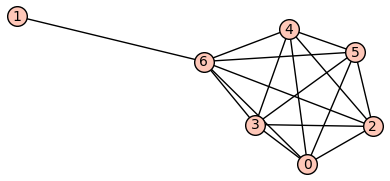

Graf  with wmdim_k = 6.0


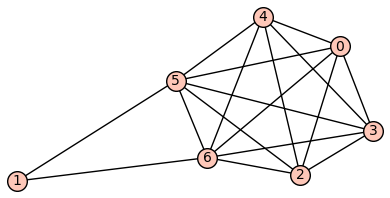

Graf  with wmdim_k = 7.0


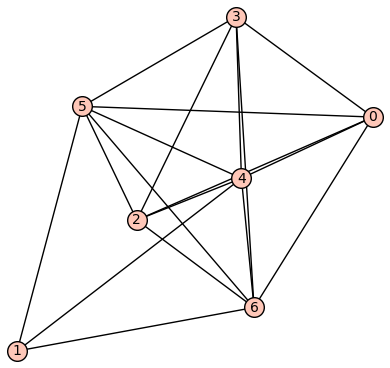

Graf  with wmdim_k = 7.0


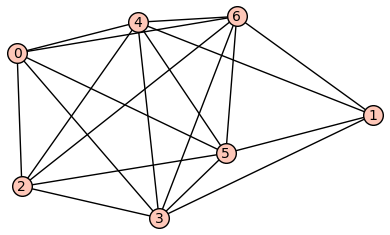

Graf  with wmdim_k = 7.0


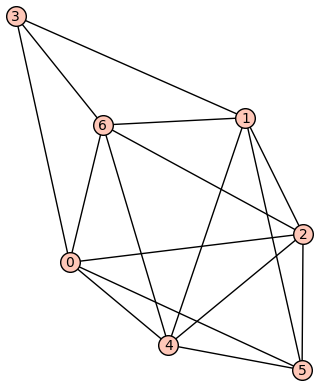

Graf  with wmdim_k = 6.0


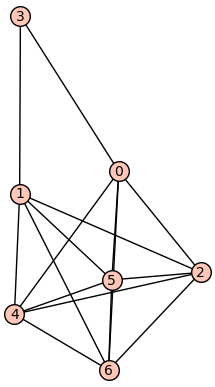

Graf  with wmdim_k = 6.0


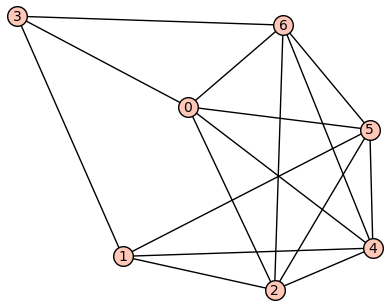

Graf  with wmdim_k = 6.0


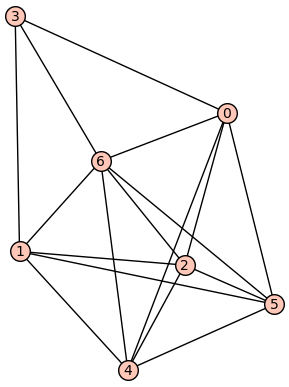

Graf  with wmdim_k = 6.0


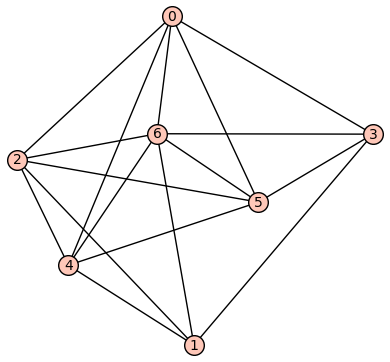

Graf  with wmdim_k = 6.0


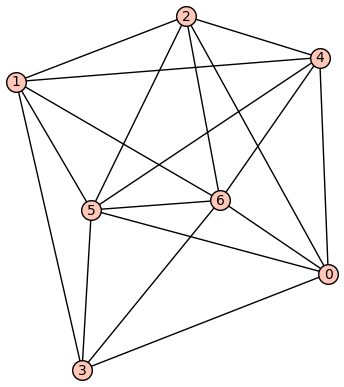

Graf  with wmdim_k = 7.0


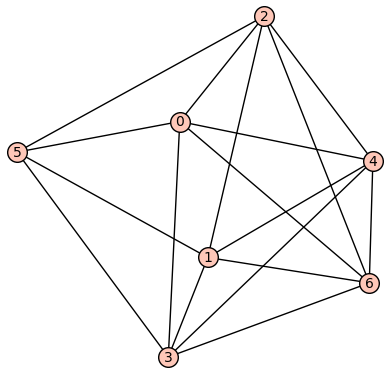

Graf  with wmdim_k = 6.0


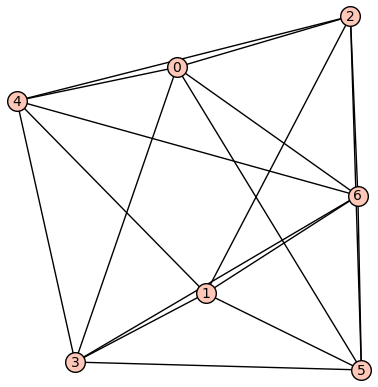

Graf  with wmdim_k = 6.0


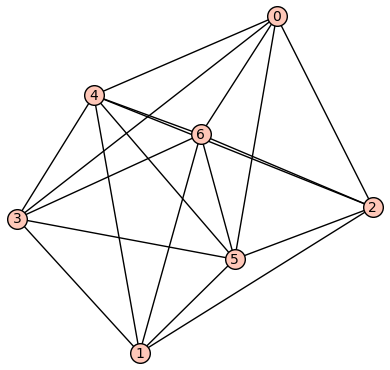

Graf  with wmdim_k = 7.0


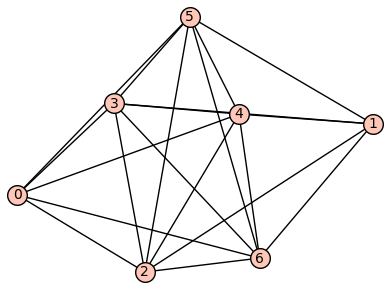

Graf  with wmdim_k = 7.0


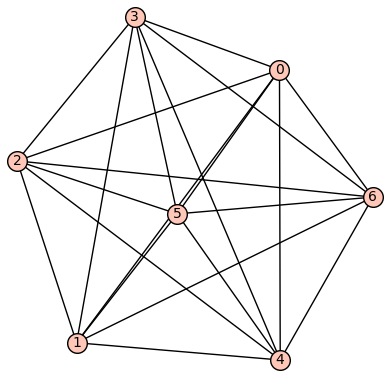

Graf  with wmdim_k = 7.0


In [13]:
sizes = [3,4,5,6,7]
poisci_grafe_z_large_wmdim_k(sizes)